In [2]:
import numpy as np
import os
from os.path import join
from trajectory import Trajectory
from settings import *
from visualize import *
from matplotlib import pyplot as plt
import cv2 as cv
from sklearn.mixture import GaussianMixture
from sklearn.svm import LinearSVC

In [3]:
'''

Workflow of the below code:

1. Extract Dense Trajectories:
a. Sample dense feature points every 5 pixels (W=5) across multiple spatial scales of the video frames.
b. Track each sampled point for the next 15 frames (L=15) using dense optical flow to obtain trajectories 
   of point movements.
c. Remove trajectories that are static (not moving) or have abrupt large displacements, as they are likely noise.
d. Normalize the shape of each remaining trajectory by dividing the displacement vectors by their sum of magnitudes.

2. Compute Descriptors along Trajectories:
a. Around each trajectory, extract descriptors within a space-time volume of 32x32 pixels and 15 frames (N=32, L=15).
b. Divide this volume into a spatio-temporal grid of 2x2 spatial cells and 3 temporal cells (nσ=2, nτ=3).
c. Within each cell, compute descriptors like HOG (histogram of gradient orientations) capturing appearance, 
   HOF (histogram of optical flow) capturing motion, and MBH (motion boundary histograms) capturing relative 
   motion patterns.
d. Normalize these descriptors using L2 normalization.

3. Encode Descriptors using Bag-of-Features:
a. Construct a codebook of 4000 "visual words" for each descriptor type (trajectory, HOG, HOF, MBH) by 
   clustering a subset of training descriptors using k-means.
b. Assign each descriptor from the video to its closest "visual word" in the corresponding codebook.
c. Create a histogram encoding the frequencies of each "visual word" appearing in the video, serving as 
   the video's representation.

4. Train Classifier:
a. Use a non-linear SVM classifier with a multi-channel χ2 kernel to combine the histogram representations 
   from multiple descriptors (trajectory, HOG, HOF, MBH).
b. Train one-vs-rest SVM classifiers to distinguish the "walking" class from other action classes.

5. Classify Test Videos:
a. For a new test video, extract dense trajectories and compute descriptors along them.
b. Encode the descriptors using the codebooks to obtain a histogram representation for the video.
c. Feed the video's representation to the trained SVM classifiers, which will output confidence 
   scores for each action class. Assign the class with the highest score as the predicted action.

In this way, the dense trajectories and associated descriptors capture the motion patterns, appearance information, and relative movements characteristic of the "walking" action, allowing the classifier to recognize this action in new videos based on the trained model.
'''

'\n\nWorkflow of the below code:\n\n1. Extract Dense Trajectories:\na. Sample dense feature points every 5 pixels (W=5) across multiple spatial scales of the video frames.\nb. Track each sampled point for the next 15 frames (L=15) using dense optical flow to obtain trajectories \n   of point movements.\nc. Remove trajectories that are static (not moving) or have abrupt large displacements, as they are likely noise.\nd. Normalize the shape of each remaining trajectory by dividing the displacement vectors by their sum of magnitudes.\n\n2. Compute Descriptors along Trajectories:\na. Around each trajectory, extract descriptors within a space-time volume of 32x32 pixels and 15 frames (N=32, L=15).\nb. Divide this volume into a spatio-temporal grid of 2x2 spatial cells and 3 temporal cells (nσ=2, nτ=3).\nc. Within each cell, compute descriptors like HOG (histogram of gradient orientations) capturing appearance, \n   HOF (histogram of optical flow) capturing motion, and MBH (motion boundary h

In [4]:
    def trajectories_from_video(path, vis_flow=False, vis_trajectories=False,
                                W=W,  # sampling grid spacing
                                L=L,  # maximum length of a trajectory
                                static_displacement_thresh=static_displacement_thresh,  # static if the sum of all displacements' norms is lower
                                max_single_displacement=max_single_displacement,  # max percentage a single displacement has in a trajectory
                                ):
        # read the video at 'path' frame by frame
        capture = cv.VideoCapture(path)
        r, current_frame = capture.read()
        current_frame = cv.cvtColor(current_frame, cv.COLOR_BGR2GRAY)
        height, width = current_frame.shape  # video resolution
        print(f'Height:{height} Width:{width}')
        flow = None
        flow_list = []
        print("flow_list", flow_list)
        grid_xs = list(range(0, width, W))
        print("Grid xs:",grid_xs)
        grid_ys = list(range(0, height, W))
        print("Grid ys:",grid_ys)
        frame_i = 0
        trajectories = []
        complete_trajectories = []
        shape_descriptors = []
        print(f'{path}: extracting trajectories')
        while True:
            # pad the frame for extracting tubes around the borders
            gx = cv.Sobel(current_frame, cv.CV_32F, 1, 0)
            gy = cv.Sobel(current_frame, cv.CV_32F, 0, 1)

            print("Dimension of gx:",gx.ndim)
            print("Dimension of gy:",gy.ndim)
            print("Shape of gx:",gx.shape)
            print("Shape of gx:",gy.shape)
            # Normalize the gradients for visualization
            # gx = cv.normalize(gx, None, alpha=0, beta=1, norm_type=cv.NORM_MINMAX, dtype=cv.CV_32F)
            # gy = cv.normalize(gy, None, alpha=0, beta=1, norm_type=cv.NORM_MINMAX, dtype=cv.CV_32F)

            # Display the gradients using imshow
            plt.figure(figsize=(11, 6))
            plt.subplot(1, 2, 1)
            plt.imshow(gx, cmap='gray')
            plt.title('Sobel Gradient X')
            plt.axis('off')

            plt.subplot(1, 2, 2)
            plt.imshow(gy, cmap='gray')
            plt.title('Sobel Gradient Y')
            plt.axis('off')

            plt.show()
            r, next_frame = capture.read()
            if r:
                # where the third dimension (2) represents the two channels for the optical flow vectors (horizontal and vertical components).
                
                next_frame = cv.cvtColor(next_frame, cv.COLOR_BGR2GRAY)
                flow = cv.calcOpticalFlowFarneback(current_frame, next_frame, flow, pyr_scale=None, levels=1,
                                                winsize=of_winsize, iterations=10, poly_n=5, poly_sigma=1.1,
                                                flags=None)  # same values
                
                # round the values so each pixel is 'moving' to a particular pixel in the next frame
                flow = np.round(flow)
                print("Flow dimension: ",flow.ndim)
                print("Flow shape:",flow.shape)
                
                # pad the flow image for extracting optical flow tubes
                flow_x_padded = cv.copyMakeBorder(flow[:, :, 0], top=N2, bottom=N2, left=N2, right=N2,
                                                borderType=cv.BORDER_REFLECT) #extrapolation of the boundary is done by bordertype
                flow_y_padded = cv.copyMakeBorder(flow[:, :, 1], top=N2, bottom=N2, left=N2, right=N2,
                                                borderType=cv.BORDER_REFLECT)
                flow_padded = np.zeros((height + N, width + N, 2), dtype='int32')
                flow_padded[:, :, 0] = flow_x_padded
                flow_padded[:, :, 1] = flow_y_padded
                print("Padded Flow shape:",flow_padded.shape)

                flow_x = flow_padded[:, :, 0]
                flow_y = flow_padded[:, :, 1]
                # Plotting flow vectors
                plt.figure(figsize=(10, 5))
                plt.subplot(1, 2, 1)
                plt.imshow(flow_x, cmap='gray')
                plt.title('Flow X Component')
                plt.colorbar()

                plt.subplot(1, 2, 2)
                plt.imshow(flow_y, cmap='gray')
                plt.title('Flow Y Component')
                plt.colorbar()

                plt.show()

                # Motion Boundary Historgram : It captures the local motion information present in consecutive 
                # frames of a video sequence. MBH is often used as a complementary descriptor to the Optical Flow.

                # MBHx from flow_x, padded. MBHx is the derivatives in x and y of the x (or u) component of the flow
                u_x = cv.Sobel(flow_x_padded, cv.CV_32F, 1, 0)  # x derivative of the u component of the flow
                u_y = cv.Sobel(flow_x_padded, cv.CV_32F, 0, 1)  # y derivative of the u component of the flow
                mbhx_padded = np.zeros((height + N, width + N, 2), dtype='float32')
                mbhx_padded[:, :, 0] = u_x
                mbhx_padded[:, :, 1] = u_y

                # MBHy from flow_y, padded. MBHy is the derivatives in x and y of the y (or v) component of the flow
                v_x = cv.Sobel(flow_y_padded, cv.CV_32F, 1, 0)  # x derivative of the u component of the flow
                v_y = cv.Sobel(flow_y_padded, cv.CV_32F, 0, 1)  # y derivative of the u component of the flow
                mbhy_padded = np.zeros((height + N, width + N, 2), dtype='float32')
                mbhy_padded[:, :, 0] = v_x
                mbhy_padded[:, :, 1] = v_y

                print(f"mbhx_padded shape: {mbhx_padded.shape}")
                print(f"mbhy_padded shape: {mbhy_padded.shape}")
                
                # Visualize MBHx and MBHy
                plt.figure(figsize=(12, 6))

                plt.subplot(2, 2, 1)
                plt.imshow(u_x, cmap='gray')
                plt.title('MBHx: x derivative of u component')

                plt.subplot(2, 2, 2)
                plt.imshow(u_y, cmap='gray')
                plt.title('MBHx: y derivative of u component')

                plt.subplot(2, 2, 3)
                plt.imshow(v_x, cmap='gray')
                plt.title('MBHy: x derivative of v component')

                plt.subplot(2, 2, 4)
                plt.imshow(v_y, cmap='gray')
                plt.title('MBHy: y derivative of v component')

                plt.tight_layout()
                plt.show()

                # pad and combine the grad images
                gx_padded = cv.copyMakeBorder(gx, top=N2, bottom=N2, left=N2, right=N2,
                                                borderType=cv.BORDER_REFLECT)
                gy_padded = cv.copyMakeBorder(gy, top=N2, bottom=N2, left=N2, right=N2,
                                            borderType=cv.BORDER_REFLECT)
                g_padded = np.zeros((height + N, width + N, 2), dtype='float32')
                g_padded[:, :, 0] = gx_padded
                g_padded[:, :, 1] = gy_padded

                # Visualize the padded and combined gradient images
                # plt.figure(figsize=(11, 6))

                # plt.subplot(1, 2, 1)
                # plt.imshow(g_padded[:, :, 0], cmap='gray')
                # plt.title('Padded Gradient (X)')

                # plt.subplot(1, 2, 2)
                # plt.imshow(g_padded[:, :, 1], cmap='gray')
                # plt.title('Padded Gradient (Y)')

                # plt.tight_layout()
                # plt.show()

                # get coordinates of all the corners that pass the threshold, not constrained by min distance between
                corners = cv.goodFeaturesToTrack(current_frame, maxCorners=0,  # unlimited number of points to be kept
                                                qualityLevel=corner_quality_level,
                                                minDistance=1  # between the corners, every px can be one
                                                )
                # make corner coordinates discrete so we can use it as indices
                corners = np.intp(corners)
                print("Corner shape:",corners.shape)
                # Draw circles around detected corners

                # The shape of the corner array returned by the goodFeaturesToTrack function would typically be (N, 1, 2), 
                # where N is the number of detected corners.

                # The first dimension N represents the number of corners detected.
                # The second dimension 1 indicates that each corner is represented as a single point.
                # The third dimension 2 contains the (x, y) coordinates of each corner.
                
                corner_visualization = current_frame.copy()  # Create a copy of the frame for visualization
                for corner in corners:
                    x, y = corner.ravel()
                    cv.circle(corner_visualization, (x, y), 3, 255, -1)  # Draw a circle around each corner

                # Visualize the frame with detected corners
                plt.figure(figsize=(8, 6))
                plt.imshow(corner_visualization, cmap='gray')
                plt.title('Detected Corners')
                plt.axis('off')
                plt.show()

                if vis_flow:
                    # VISUALIZE THE FLOW
                    cv.imshow('flow', draw_flow(current_frame, flow, step=W))
                    cv.waitKey(1)

                # init new trajectories at corners, if 1) they are on the grid, 2) no tracked points in WxW
                for c in corners:
                    x, y = c.ravel()
                    if x in grid_xs and y in grid_ys:  # if the corner is on the grid
                        if not any(np.abs(y - t.coords[-1][1]) <= W and
                                np.abs(x - t.coords[-1][0]) <= W
                                for t in trajectories):  # if no tracked points in WxW
                            trajectories.append(Trajectory(y=y, x=x, start_frame_num=frame_i))

                # varies for every video
                print("Length of Trajectory:",len(trajectories))
                for t in trajectories:
                    print("x:", t.coords[-1][0], "y:", t.coords[-1][1])

                ''' 1. Retreive the last coordinate from trajectory object
                2. It checks wheather the last coordinate in within the boundary of image or not
                3. If it is not within the boundary of image, then remove the trajectory object from the list
                4  It access optical flow vlaue (delta x and delta y) of the last coordinate in trajectory obeject
                and this values represent the displacement in the y and x directions 
                5. If the attempt to access the flow values results in an IndexError (meaning the point is 
                outside the flow array boundaries), it removes the trajectory from the list (trajectories.remove(t)).'''
                

                # else part
                '''
                    1.Filling in Tube Slices: For each trajectory that hasn't reached the maximum length L:

                        -> It extracts slices of data from various volumes (such as gradient, optical flow,
                        MBHx, and MBHy) centered around the trajectory's current position.
                        -> These slices are then appended to the corresponding volume lists within the trajectory object.
                        -> This step essentially captures the visual information surrounding the trajectory's path.
                    
                    2.Continuing Trajectories: Each trajectory is extended to the next frame based on the 
                    optical flow information (delta_x and delta_y).

                        -> The trajectory's position is updated according to the flow, simulating its 
                        movement in the video.
                        -> If the length of the trajectory exceeds the maximum length L, 
                        it is trimmed back to L by removing the last coordinate pair. This ensures 
                        trajectories remain within a manageable length.
                    
                    3. Complete Trajectories Handling: If a trajectory reaches the maximum length L, it is considered
                    complete and added to the list of complete_trajectories. These trajectories represent the full path
                    of motion for a specific feature in the video.
                '''
                for i , t in enumerate(trajectories):
                    # the last point of the trajectory
                    tracked_point_y = int(t.coords[-1][1])
                    tracked_point_x = int(t.coords[-1][0])
                    if tracked_point_x not in range(width + 1) or tracked_point_y not in range(height + 1):
                        trajectories.remove(t)
                        continue
                    # print("Remove Trajectories Length:",len(trajectories))
                    # print('i',i)
                    try:
                        # u and v components of the flow at this point
                        delta_y = flow[tracked_point_y, tracked_point_x, 1]
                        delta_x = flow[tracked_point_y, tracked_point_x, 0]

                        # change by me
                        # print("delta_y , delta_x",delta_y,delta_x)
                                            
                    except IndexError:
                        # remove the trajectory if it went out of the boundaries of the image
                        trajectories.remove(t)

                    
                    else:
                        # fill in the tube slices for mbhx, mbhy, flow and gradient images
                        # y: y + N and not y - N2: y + N2 because the image was padded
                        g_volume_slice = g_padded[tracked_point_y: tracked_point_y + N,
                                                tracked_point_x: tracked_point_x + N]
                        t.g_volume.append(g_volume_slice)

                        of_volume_slice = flow_padded[tracked_point_y: tracked_point_y + N,
                                                    tracked_point_x: tracked_point_x + N,
                                                    :]
                        t.of_volume.append(of_volume_slice)

                        mbhx_volume_slice = mbhx_padded[tracked_point_y: tracked_point_y + N,
                                                        tracked_point_x: tracked_point_x + N,
                                                        :]
                        t.mbhx_volume.append(mbhx_volume_slice)
                        mbhy_volume_slice = mbhy_padded[tracked_point_y: tracked_point_y + N,
                                                        tracked_point_x: tracked_point_x + N,
                                                        :]
                        t.mbhy_volume.append(mbhy_volume_slice)

                        # continue the trajectory to the next frame if it's length is less than L
                        t.add(delta_y=delta_y, delta_x=delta_x)
                        if len(t.coords) > L:
                            # take out the trajectory to the 'complete_trajectories' list if its length reached L
                            t.coords = t.coords[:-1]  # remove last (L+1'th) coordinate pair referring to the next frame
                            complete_trajectories.append(t)
                            trajectories.remove(t)

                if True:
                    # VISUALIZE THE TRAJECTORIES
                    cv.imshow('flow', draw_trajectories(current_frame, trajectories))
                    cv.waitKey(1)

                flow_list.append(flow)  # append the flow to a list of flows to extract descriptors later
                current_frame = next_frame
                frame_i += 1
            else:
                break

        # print(f'{len(complete_trajectories)} complete trajectories before post-processing')       

        # POST-PROCESSING THE COMPLETE TRAJECTORIES
        final_trajectories = []
        for t in complete_trajectories:
            # removing trajectories with sudden large displacements
            # 'if the displacement vector between 2 frames is > 70% of the overall displacement of the trajectory'
            # understanding the 'overall displacement' as the sum of displacements' norms, not as "end minus start"
            # to preserve looping trajectories
            overall_displacement = sum([np.linalg.norm(d) for d in t.displacement_vectors])
            print("Overall Displacement:",overall_displacement)
            if any(np.linalg.norm(d) > max_single_displacement * overall_displacement for d in t.displacement_vectors):
                # complete_trajectories.remove(t)
                continue

            # removing 'static' trajectories - not specified in the paper
            # can be ones with the sum of the all displacements' norms is lower than static_displacement_thresh
            # set it to 1 to remove just the trajectories that do not move at all
            if overall_displacement < static_displacement_thresh:
                # complete_trajectories.remove(t)
                continue

            # converting tubes to numpy arrays
            t.g_volume = np.concatenate([f.reshape(1, N, N, 2) for f in t.g_volume], axis=0)
            t.of_volume = np.concatenate([f.reshape(1, N, N, 2) for f in t.of_volume], axis=0)
            t.mbhx_volume = np.concatenate([f.reshape(1, N, N, 2) for f in t.mbhx_volume], axis=0)
            t.mbhy_volume = np.concatenate([f.reshape(1, N, N, 2) for f in t.mbhy_volume], axis=0)

            print(f"Gradient_volumne {t.g_volume.shape}")
            print(f"Optical Flow Volume {t.of_volume.shape}")
            print(f"MBHx Volume {t.mbhx_volume.shape}")
            print(f"MBHy Volume {t.mbhy_volume.shape}")
            # print("Gradient Volumn:",t.g_volume)
            # print("Optical Volume:",t.of_volume)
            # print("MBHx Volume:",t.mbhx_volume)
            # print("MBHy Volume:",t.mbhy_volume)
            
            # remove trajectories for which either of the volumes turned out empty
            if isinstance(t.g_volume, list) or isinstance(t.of_volume, list) \
                    or isinstance(t.mbhx_volume, list) or isinstance(t.mbhy_volume, list):
                # complete_trajectories.remove(t)
                continue

            # calculating shape descriptors on the good remaining trajectories
            t.trajectory_shape = np.array(t.displacement_vectors).flatten()\
                                / sum([np.linalg.norm(d) for d in t.displacement_vectors])

            final_trajectories.append(t)

        print(f'{len(complete_trajectories)} complete trajectories before post-processing')
        for t in complete_trajectories:
            print("complete_trajectory x:", t.coords[-1][0], "complete_trajectory y:", t.coords[-1][1])
        print(f'{len(final_trajectories)} complete trajectories after post-processing')
        for t in final_trajectories:
            print("final_trajectories x:", t.coords[-1][0], "final_trajectories y:", t.coords[-1][1])
        return final_trajectories

In [5]:
def descriptor_from_volume(volume, small_vectors_bin=False):
    time_tubes = np.split(volume, n_tau, axis=0)
    y_tubes = [item for tube_list in
               [np.split(time_tube, n_sigma, axis=1) for time_tube in time_tubes]
               for item in tube_list]
    # print("y_tubes:",y_tubes)
    del time_tubes
    tubes = [item for tube_list in
             [np.split(y_tube, n_sigma, axis=2) for y_tube in y_tubes]
             for item in tube_list]
    # print("Tubes:",tubes)
    del y_tubes

    if small_vectors_bin:
        effective_bins = bins + 1
    else:
        effective_bins = bins

    # initialize the descriptor in a shape to allow one tube's descriptor on top of the other one
    print("Length of Tubes:",len(tubes))
    print("Effective Bins:",effective_bins)
    d = np.zeros((len(tubes), effective_bins), dtype='float32')

    for tube_i, tube in enumerate(tubes):
        tube_d = np.zeros(effective_bins, dtype='float32')

        for frame_i in range(tube.shape[0]):
            frame_d = np.zeros_like(tube_d)
            mag, ang = cv.cartToPolar(
                tube[frame_i, :, :, 0].astype(dtype='float32'), tube[frame_i, :, :, 1].astype(dtype='float32')
            )
            ang = np.degrees(ang)  # convert to degrees

            if small_vectors_bin:
                # populate main bins
                for bin_i in range(bins):
                    this_bin_magnitudes = np.where(
                        (ang >= bin_angles[bin_i]) & (ang < bin_angles[bin_i + 1]) & (ang > small_flow_magnitude),
                        ang, 0
                    )
                    frame_d[bin_i] = np.sum(this_bin_magnitudes)

                # last bin with small magnitudes
                frame_d[-1] = np.sum(
                    np.where(ang <= small_flow_magnitude, True, False)
                )

            else:
                # populate bins
                for bin_i in range(bins):
                    this_bin_magnitudes = np.where(
                        (ang >= bin_angles[bin_i]) & (ang < bin_angles[bin_i + 1]),
                        ang, 0
                    )
                    frame_d[bin_i] = np.sum(this_bin_magnitudes)

            # sum up the descriptors of different frames of the tube
            tube_d = np.add(tube_d, frame_d)

        d[tube_i, :] = tube_d  # stack the descriptors of individual tubes

    d = d.flatten()  # concatenate the HoFs of tubes
    d = d / (np.linalg.norm(d) + 0.1)  # normalize the vector
    return d

In [6]:
def descriptors_from_trajectories(trajectories, filename):
    video_descriptors = np.zeros((len(trajectories), len_descriptor), dtype=np.float32)
    for t_i, t in enumerate(trajectories):
        print('t_i:',t_i)
        print('t:',t)
        try:
            t.hog = descriptor_from_volume(t.g_volume)
        except:
            print('a')
        t.hof = descriptor_from_volume(t.of_volume, small_vectors_bin=True)
        t.mbhx = descriptor_from_volume(t.mbhx_volume)
        t.mbhy = descriptor_from_volume(t.mbhy_volume)
        # concatenate all descriptors
        print("t.trajectory_shape:",t.trajectory_shape.shape)
        print("t.hog:",t.hog.shape)
        print("t.hof:",t.hof.shape)
        print("t.mbhx:",t.mbhx.shape)
        print("t.mbhy:",t.mbhy.shape)
        video_descriptors[t_i] = np.concatenate((t.trajectory_shape, t.hog, t.hof, t.mbhx, t.mbhy))
        print("Video Descriptor:",video_descriptors[t_i])
        print("Video Descriptor Shape:",video_descriptors[t_i].shape)
    print(video_descriptors.shape)

In [7]:
# dimension of the video descriptor is (len of complete trajectory, 426)
#                                               ^                    ^
#                                              rows                columns      

Height:404 Width:720
flow_list []
Grid xs: [0, 5, 10, 15, 20, 25, 30, 35, 40, 45, 50, 55, 60, 65, 70, 75, 80, 85, 90, 95, 100, 105, 110, 115, 120, 125, 130, 135, 140, 145, 150, 155, 160, 165, 170, 175, 180, 185, 190, 195, 200, 205, 210, 215, 220, 225, 230, 235, 240, 245, 250, 255, 260, 265, 270, 275, 280, 285, 290, 295, 300, 305, 310, 315, 320, 325, 330, 335, 340, 345, 350, 355, 360, 365, 370, 375, 380, 385, 390, 395, 400, 405, 410, 415, 420, 425, 430, 435, 440, 445, 450, 455, 460, 465, 470, 475, 480, 485, 490, 495, 500, 505, 510, 515, 520, 525, 530, 535, 540, 545, 550, 555, 560, 565, 570, 575, 580, 585, 590, 595, 600, 605, 610, 615, 620, 625, 630, 635, 640, 645, 650, 655, 660, 665, 670, 675, 680, 685, 690, 695, 700, 705, 710, 715]
Grid ys: [0, 5, 10, 15, 20, 25, 30, 35, 40, 45, 50, 55, 60, 65, 70, 75, 80, 85, 90, 95, 100, 105, 110, 115, 120, 125, 130, 135, 140, 145, 150, 155, 160, 165, 170, 175, 180, 185, 190, 195, 200, 205, 210, 215, 220, 225, 230, 235, 240, 245, 250, 255, 260, 265, 

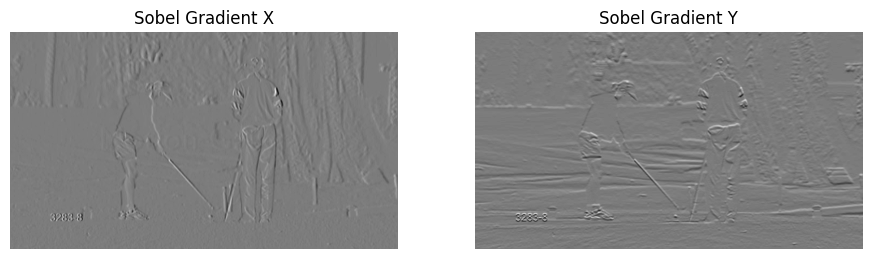

Flow dimension:  3
Flow shape: (404, 720, 2)
Padded Flow shape: (436, 752, 2)


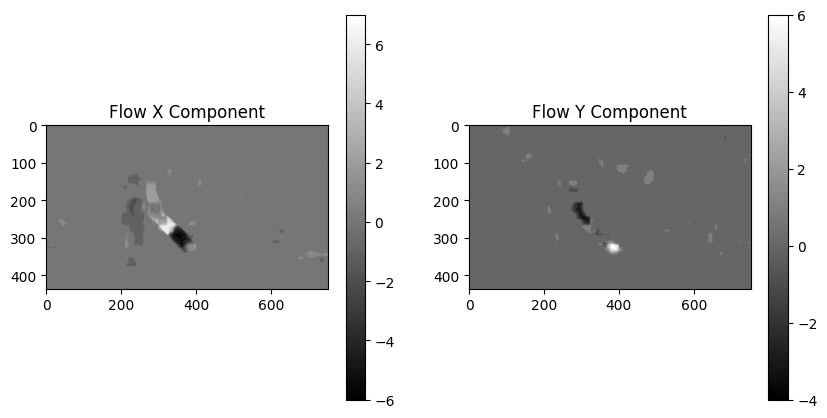

mbhx_padded shape: (436, 752, 2)
mbhy_padded shape: (436, 752, 2)


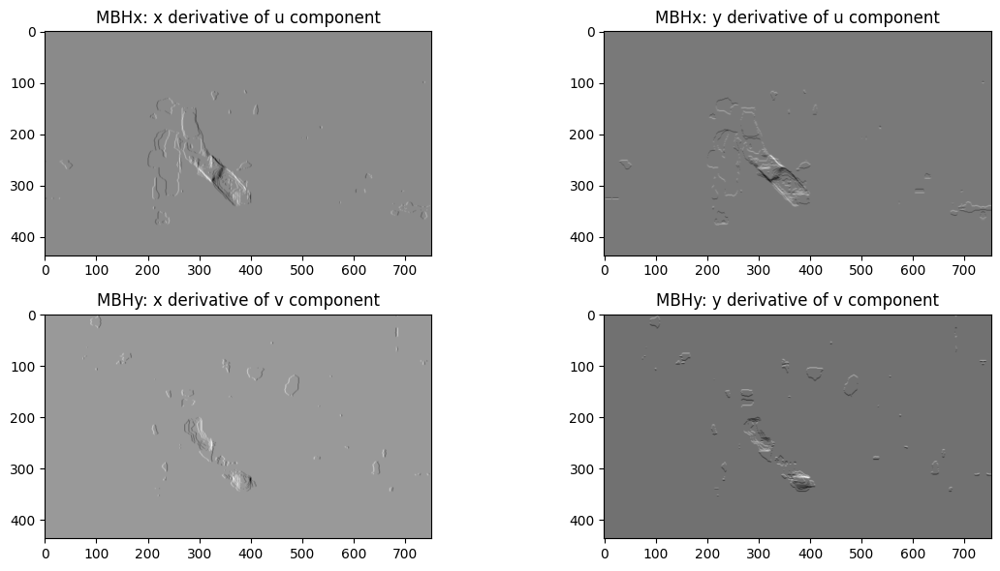

Corner shape: (1280, 1, 2)


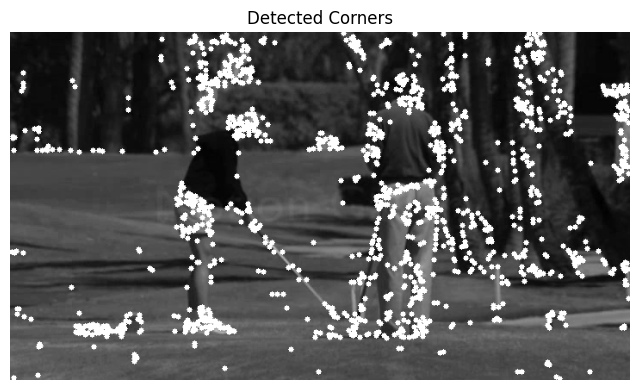

Length of Trajectory: 37
x: 215 y: 345
x: 215 y: 190
x: 225 y: 335
x: 260 y: 120
x: 280 y: 95
x: 255 y: 100
x: 240 y: 340
x: 460 y: 55
x: 270 y: 120
x: 445 y: 210
x: 220 y: 200
x: 460 y: 180
x: 220 y: 35
x: 420 y: 245
x: 645 y: 340
x: 435 y: 180
x: 365 y: 315
x: 220 y: 320
x: 710 y: 170
x: 425 y: 195
x: 410 y: 30
x: 495 y: 220
x: 380 y: 135
x: 440 y: 330
x: 200 y: 215
x: 715 y: 145
x: 205 y: 190
x: 195 y: 330
x: 600 y: 15
x: 460 y: 255
x: 360 y: 125
x: 605 y: 105
x: 225 y: 25
x: 665 y: 265
x: 600 y: 150
x: 660 y: 220
x: 265 y: 140
Dimension of gx: 2
Dimension of gy: 2
Shape of gx: (404, 720)
Shape of gx: (404, 720)


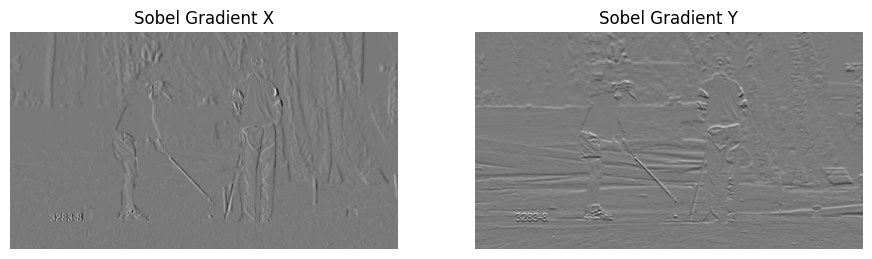

Flow dimension:  3
Flow shape: (404, 720, 2)
Padded Flow shape: (436, 752, 2)


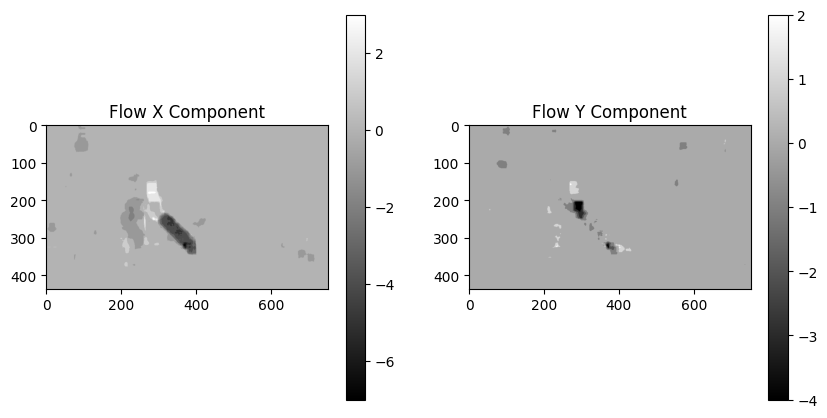

mbhx_padded shape: (436, 752, 2)
mbhy_padded shape: (436, 752, 2)


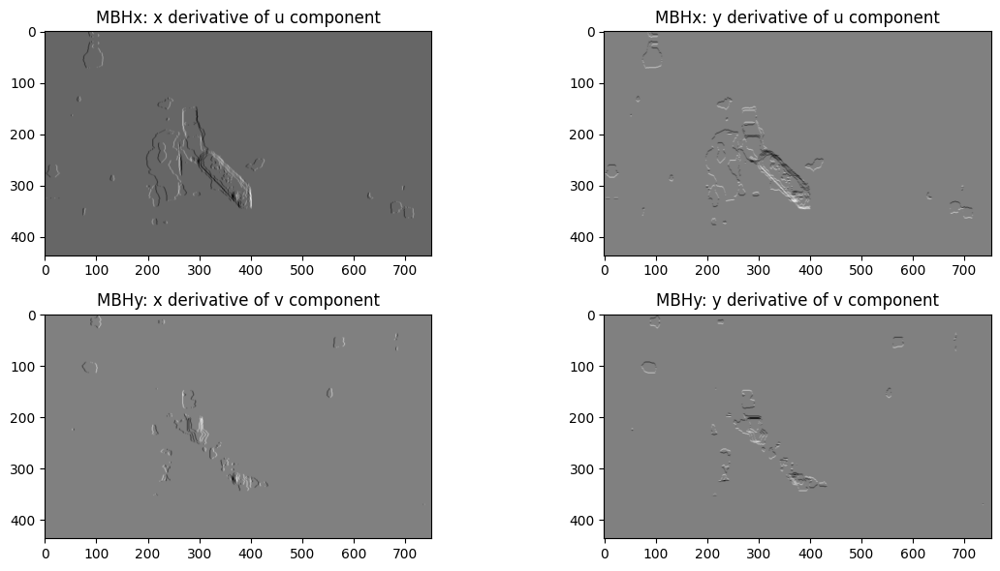

Corner shape: (1312, 1, 2)


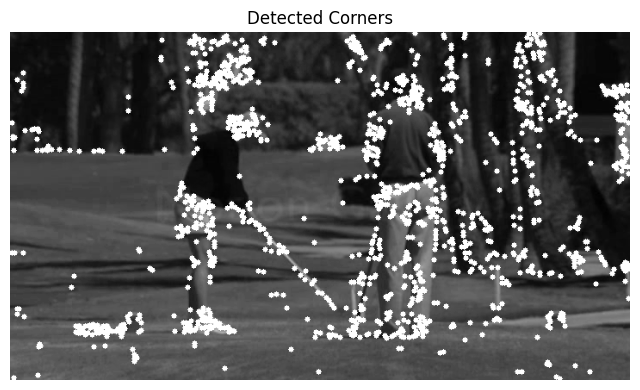

Length of Trajectory: 50
x: 214.0 y: 345.0
x: 213.0 y: 190.0
x: 225.0 y: 335.0
x: 260.0 y: 120.0
x: 280.0 y: 95.0
x: 255.0 y: 100.0
x: 240.0 y: 340.0
x: 460.0 y: 55.0
x: 270.0 y: 120.0
x: 445.0 y: 210.0
x: 219.0 y: 200.0
x: 460.0 y: 180.0
x: 220.0 y: 35.0
x: 420.0 y: 245.0
x: 645.0 y: 340.0
x: 435.0 y: 180.0
x: 366.0 y: 320.0
x: 220.0 y: 320.0
x: 710.0 y: 170.0
x: 425.0 y: 195.0
x: 410.0 y: 30.0
x: 495.0 y: 220.0
x: 380.0 y: 135.0
x: 440.0 y: 330.0
x: 199.0 y: 216.0
x: 715.0 y: 145.0
x: 204.0 y: 190.0
x: 195.0 y: 330.0
x: 600.0 y: 15.0
x: 460.0 y: 255.0
x: 360.0 y: 125.0
x: 605.0 y: 105.0
x: 225.0 y: 25.0
x: 665.0 y: 265.0
x: 600.0 y: 150.0
x: 660.0 y: 220.0
x: 266.0 y: 141.0
x: 225 y: 205
x: 655 y: 265
x: 405 y: 290
x: 710 y: 65
x: 710 y: 95
x: 235 y: 60
x: 360 y: 135
x: 210 y: 335
x: 270 y: 220
x: 495 y: 205
x: 400 y: 20
x: 390 y: 320
x: 400 y: 325
Dimension of gx: 2
Dimension of gy: 2
Shape of gx: (404, 720)
Shape of gx: (404, 720)


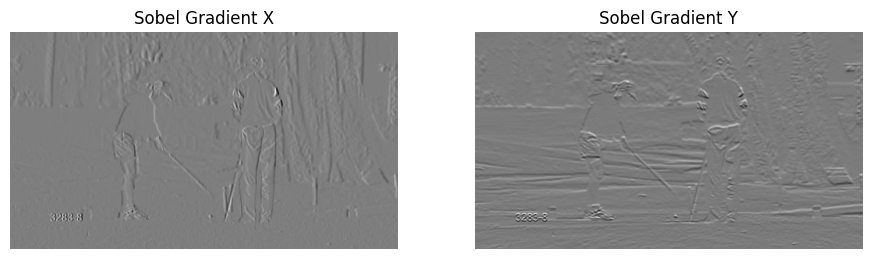

Flow dimension:  3
Flow shape: (404, 720, 2)
Padded Flow shape: (436, 752, 2)


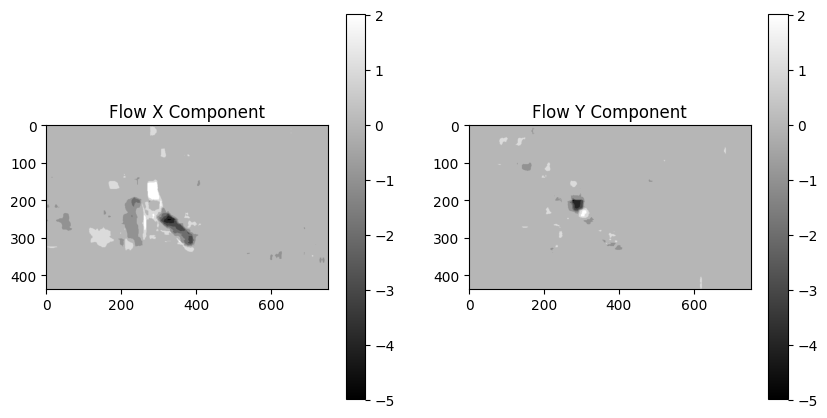

mbhx_padded shape: (436, 752, 2)
mbhy_padded shape: (436, 752, 2)


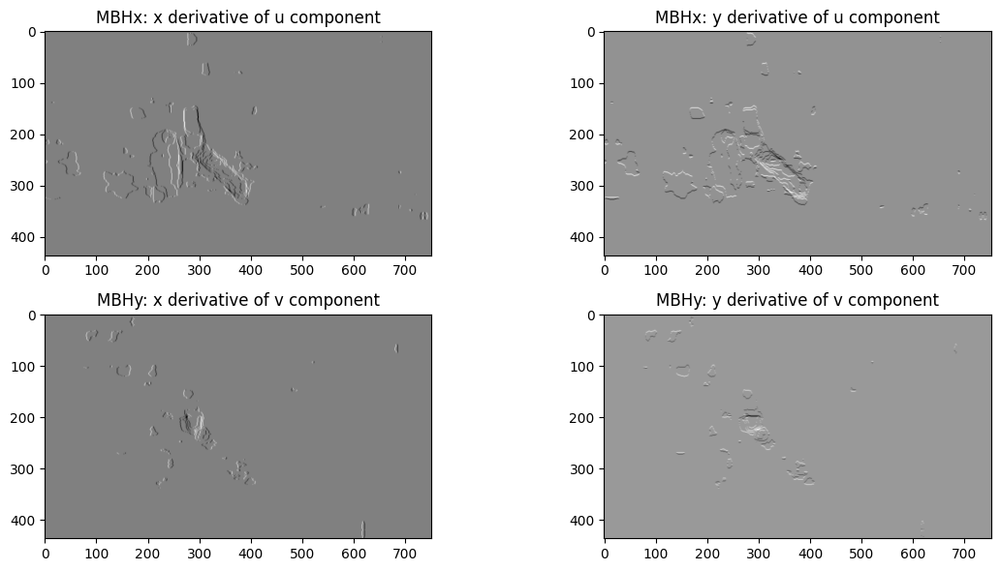

Corner shape: (1395, 1, 2)


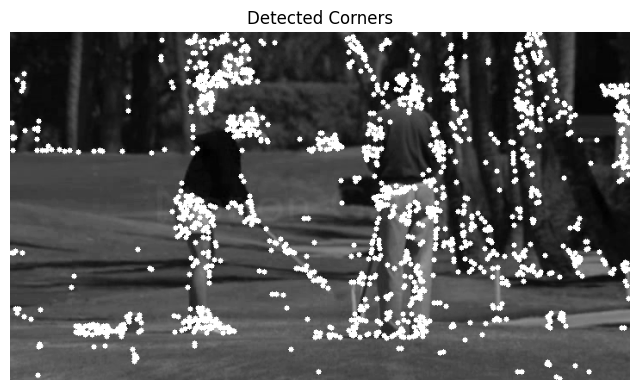

Length of Trajectory: 59
x: 214.0 y: 345.0
x: 212.0 y: 190.0
x: 225.0 y: 335.0
x: 260.0 y: 120.0
x: 280.0 y: 95.0
x: 255.0 y: 100.0
x: 240.0 y: 340.0
x: 460.0 y: 55.0
x: 270.0 y: 120.0
x: 445.0 y: 210.0
x: 218.0 y: 200.0
x: 460.0 y: 180.0
x: 220.0 y: 35.0
x: 420.0 y: 245.0
x: 645.0 y: 340.0
x: 435.0 y: 180.0
x: 362.0 y: 319.0
x: 220.0 y: 320.0
x: 710.0 y: 170.0
x: 425.0 y: 195.0
x: 410.0 y: 30.0
x: 495.0 y: 220.0
x: 380.0 y: 135.0
x: 440.0 y: 330.0
x: 198.0 y: 217.0
x: 715.0 y: 145.0
x: 203.0 y: 190.0
x: 195.0 y: 330.0
x: 600.0 y: 15.0
x: 460.0 y: 255.0
x: 360.0 y: 125.0
x: 605.0 y: 105.0
x: 225.0 y: 25.0
x: 665.0 y: 265.0
x: 600.0 y: 150.0
x: 660.0 y: 220.0
x: 268.0 y: 142.0
x: 224.0 y: 205.0
x: 655.0 y: 265.0
x: 405.0 y: 290.0
x: 710.0 y: 65.0
x: 710.0 y: 95.0
x: 235.0 y: 60.0
x: 360.0 y: 135.0
x: 210.0 y: 335.0
x: 271.0 y: 219.0
x: 495.0 y: 205.0
x: 400.0 y: 20.0
x: 390.0 y: 321.0
x: 400.0 y: 325.0
x: 135 y: 330
x: 225 y: 75
x: 230 y: 260
x: 620 y: 55
x: 555 y: 35
x: 225 y: 65
x: 22

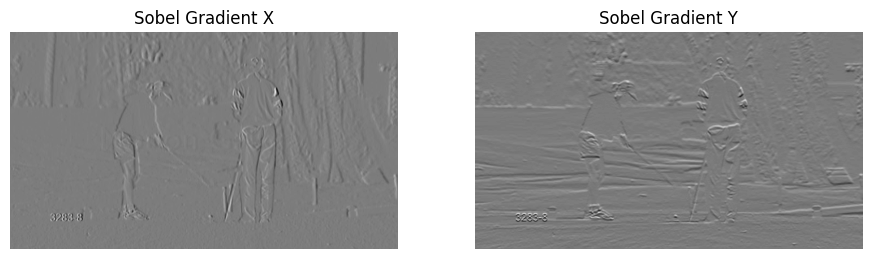

Flow dimension:  3
Flow shape: (404, 720, 2)
Padded Flow shape: (436, 752, 2)


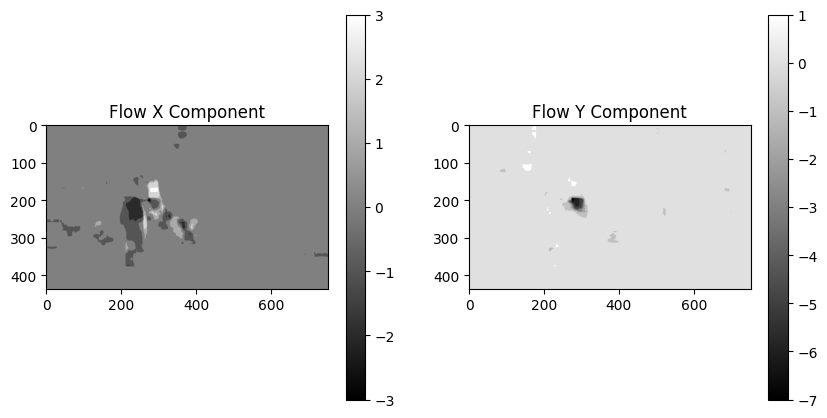

mbhx_padded shape: (436, 752, 2)
mbhy_padded shape: (436, 752, 2)


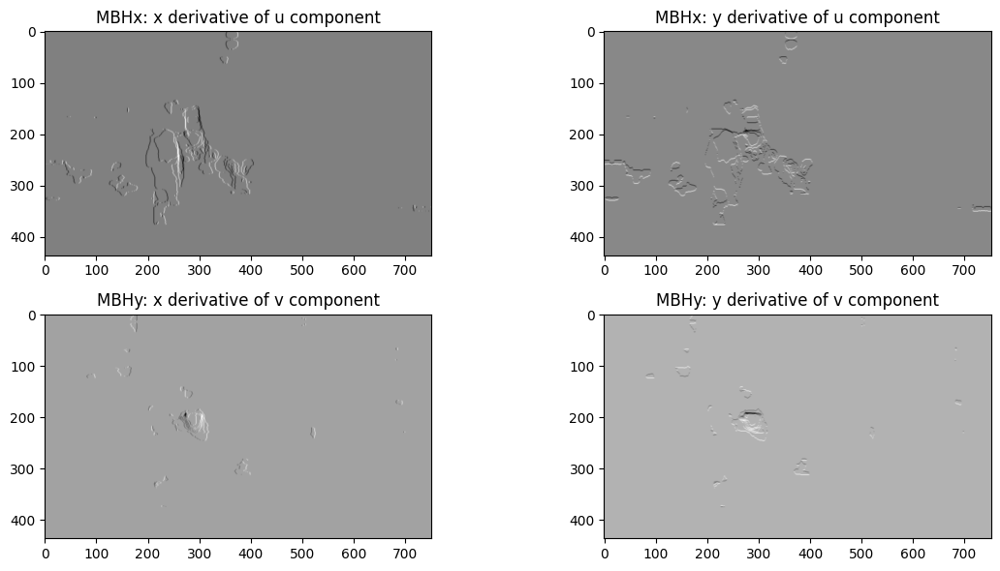

Corner shape: (1351, 1, 2)


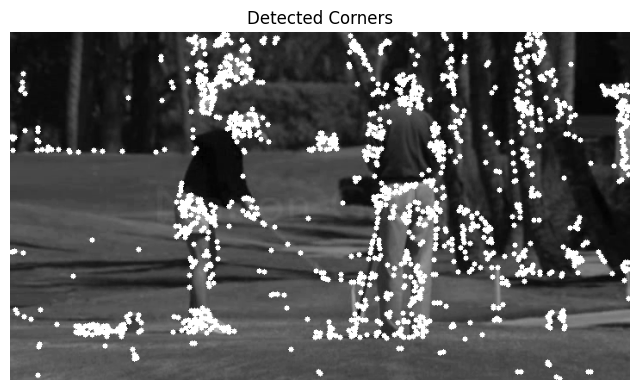

Length of Trajectory: 67
x: 214.0 y: 345.0
x: 210.0 y: 190.0
x: 225.0 y: 335.0
x: 260.0 y: 120.0
x: 280.0 y: 95.0
x: 255.0 y: 100.0
x: 240.0 y: 340.0
x: 460.0 y: 55.0
x: 270.0 y: 120.0
x: 445.0 y: 210.0
x: 216.0 y: 200.0
x: 460.0 y: 180.0
x: 220.0 y: 35.0
x: 420.0 y: 245.0
x: 645.0 y: 340.0
x: 435.0 y: 180.0
x: 363.0 y: 319.0
x: 220.0 y: 320.0
x: 710.0 y: 170.0
x: 425.0 y: 195.0
x: 410.0 y: 30.0
x: 495.0 y: 220.0
x: 380.0 y: 135.0
x: 440.0 y: 330.0
x: 198.0 y: 218.0
x: 715.0 y: 145.0
x: 202.0 y: 190.0
x: 195.0 y: 330.0
x: 600.0 y: 15.0
x: 460.0 y: 255.0
x: 360.0 y: 125.0
x: 605.0 y: 105.0
x: 225.0 y: 25.0
x: 665.0 y: 265.0
x: 600.0 y: 150.0
x: 660.0 y: 220.0
x: 270.0 y: 143.0
x: 223.0 y: 205.0
x: 655.0 y: 265.0
x: 405.0 y: 290.0
x: 710.0 y: 65.0
x: 710.0 y: 95.0
x: 235.0 y: 60.0
x: 360.0 y: 135.0
x: 210.0 y: 335.0
x: 272.0 y: 219.0
x: 495.0 y: 205.0
x: 400.0 y: 20.0
x: 390.0 y: 321.0
x: 400.0 y: 325.0
x: 135.0 y: 330.0
x: 225.0 y: 75.0
x: 229.0 y: 260.0
x: 620.0 y: 55.0
x: 555.0 y: 35.

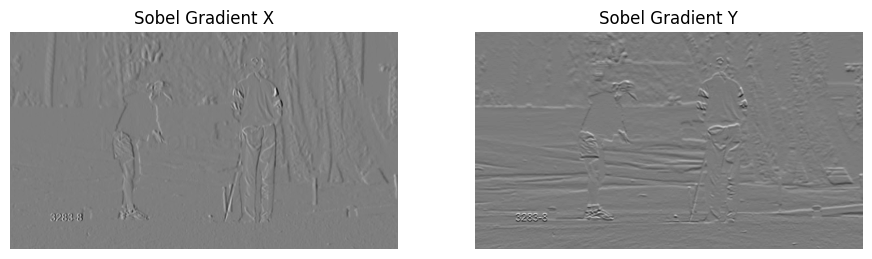

Flow dimension:  3
Flow shape: (404, 720, 2)
Padded Flow shape: (436, 752, 2)


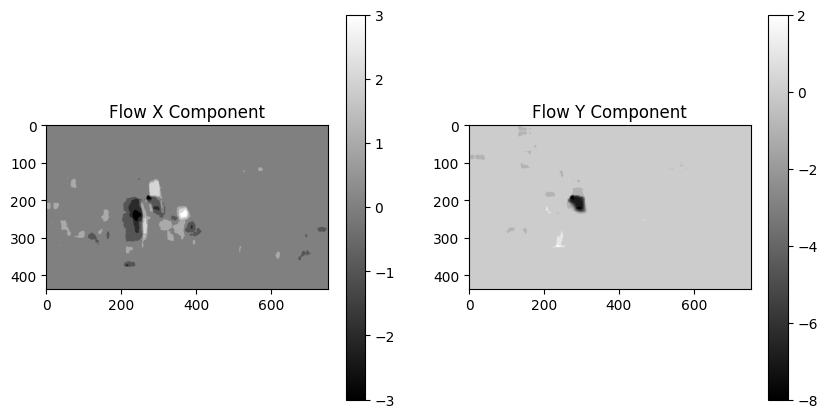

mbhx_padded shape: (436, 752, 2)
mbhy_padded shape: (436, 752, 2)


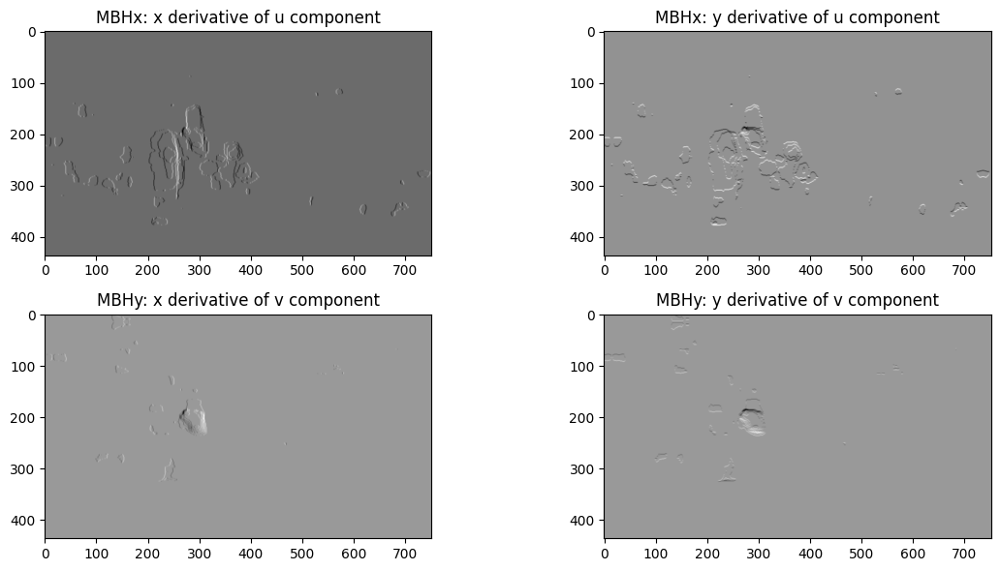

Corner shape: (1383, 1, 2)


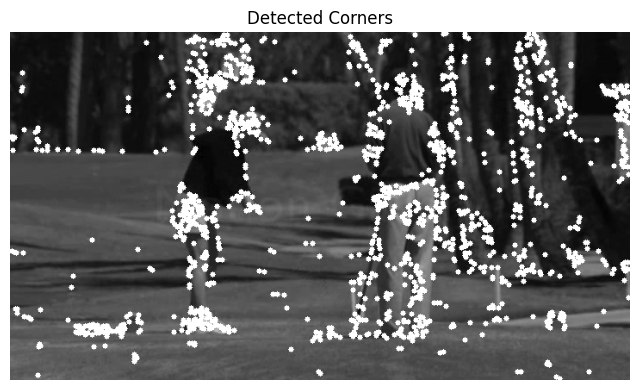

Length of Trajectory: 80
x: 213.0 y: 345.0
x: 208.0 y: 190.0
x: 225.0 y: 335.0
x: 260.0 y: 120.0
x: 280.0 y: 95.0
x: 255.0 y: 100.0
x: 240.0 y: 340.0
x: 460.0 y: 55.0
x: 270.0 y: 120.0
x: 445.0 y: 210.0
x: 214.0 y: 200.0
x: 460.0 y: 180.0
x: 220.0 y: 35.0
x: 420.0 y: 245.0
x: 645.0 y: 340.0
x: 435.0 y: 180.0
x: 363.0 y: 319.0
x: 219.0 y: 320.0
x: 710.0 y: 170.0
x: 425.0 y: 195.0
x: 410.0 y: 30.0
x: 495.0 y: 220.0
x: 380.0 y: 135.0
x: 440.0 y: 330.0
x: 197.0 y: 219.0
x: 715.0 y: 145.0
x: 200.0 y: 190.0
x: 195.0 y: 330.0
x: 600.0 y: 15.0
x: 460.0 y: 255.0
x: 360.0 y: 125.0
x: 605.0 y: 105.0
x: 225.0 y: 25.0
x: 665.0 y: 265.0
x: 600.0 y: 150.0
x: 660.0 y: 220.0
x: 272.0 y: 143.0
x: 221.0 y: 205.0
x: 655.0 y: 265.0
x: 405.0 y: 290.0
x: 710.0 y: 65.0
x: 710.0 y: 95.0
x: 235.0 y: 60.0
x: 360.0 y: 135.0
x: 209.0 y: 335.0
x: 273.0 y: 218.0
x: 495.0 y: 205.0
x: 400.0 y: 20.0
x: 390.0 y: 321.0
x: 400.0 y: 325.0
x: 135.0 y: 330.0
x: 225.0 y: 75.0
x: 228.0 y: 260.0
x: 620.0 y: 55.0
x: 555.0 y: 35.

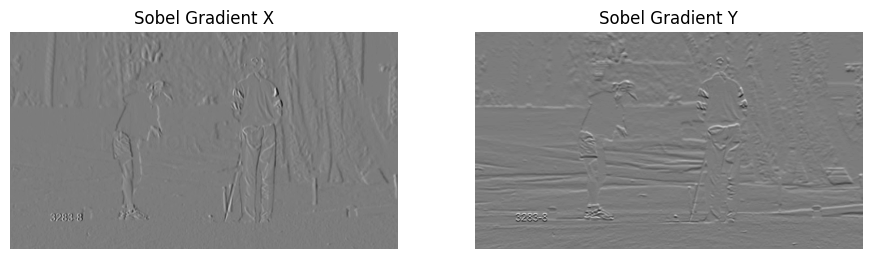

Flow dimension:  3
Flow shape: (404, 720, 2)
Padded Flow shape: (436, 752, 2)


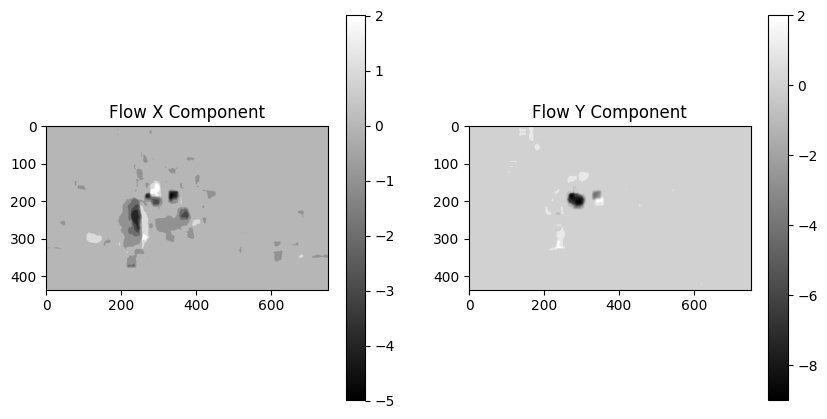

mbhx_padded shape: (436, 752, 2)
mbhy_padded shape: (436, 752, 2)


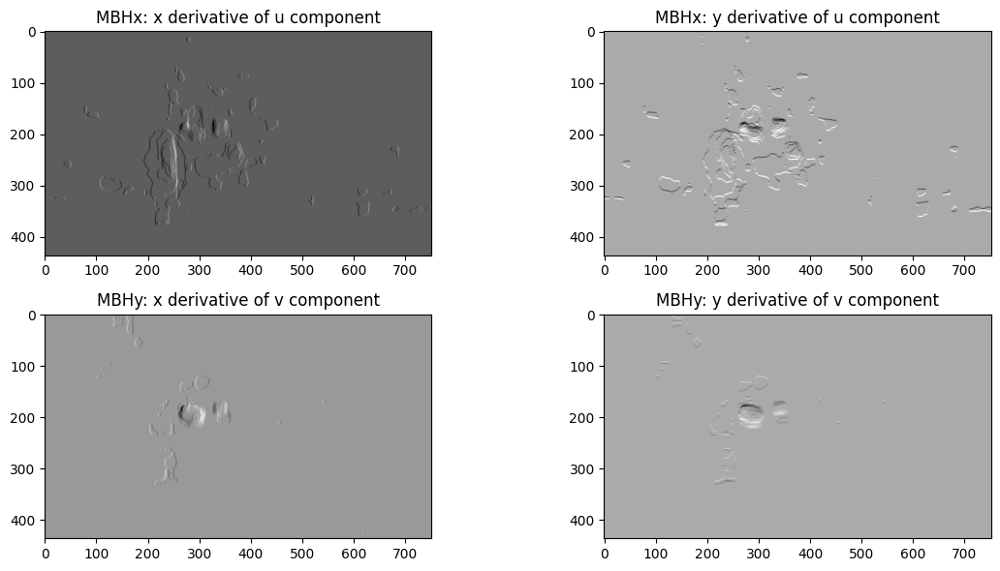

Corner shape: (1243, 1, 2)


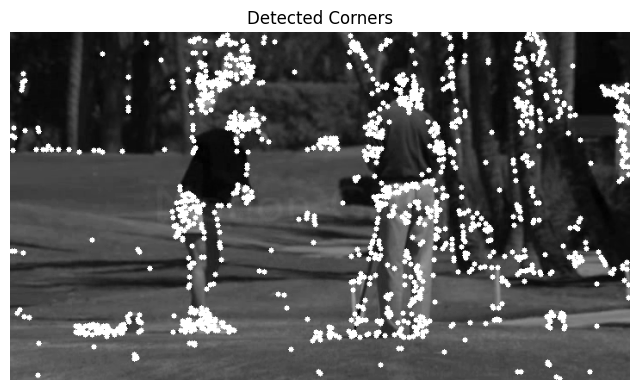

Length of Trajectory: 93
x: 213.0 y: 345.0
x: 207.0 y: 190.0
x: 225.0 y: 335.0
x: 260.0 y: 120.0
x: 280.0 y: 95.0
x: 255.0 y: 100.0
x: 240.0 y: 340.0
x: 460.0 y: 55.0
x: 270.0 y: 120.0
x: 445.0 y: 210.0
x: 212.0 y: 200.0
x: 460.0 y: 180.0
x: 220.0 y: 35.0
x: 420.0 y: 245.0
x: 645.0 y: 340.0
x: 435.0 y: 180.0
x: 363.0 y: 319.0
x: 219.0 y: 320.0
x: 710.0 y: 170.0
x: 425.0 y: 195.0
x: 410.0 y: 30.0
x: 495.0 y: 220.0
x: 380.0 y: 135.0
x: 440.0 y: 330.0
x: 196.0 y: 219.0
x: 715.0 y: 145.0
x: 199.0 y: 190.0
x: 195.0 y: 330.0
x: 600.0 y: 15.0
x: 460.0 y: 255.0
x: 360.0 y: 125.0
x: 605.0 y: 105.0
x: 225.0 y: 25.0
x: 665.0 y: 265.0
x: 600.0 y: 150.0
x: 660.0 y: 220.0
x: 274.0 y: 143.0
x: 219.0 y: 205.0
x: 655.0 y: 265.0
x: 405.0 y: 290.0
x: 710.0 y: 65.0
x: 710.0 y: 95.0
x: 235.0 y: 60.0
x: 360.0 y: 135.0
x: 209.0 y: 335.0
x: 273.0 y: 217.0
x: 495.0 y: 205.0
x: 400.0 y: 20.0
x: 390.0 y: 321.0
x: 400.0 y: 325.0
x: 135.0 y: 330.0
x: 225.0 y: 75.0
x: 226.0 y: 260.0
x: 620.0 y: 55.0
x: 555.0 y: 35.

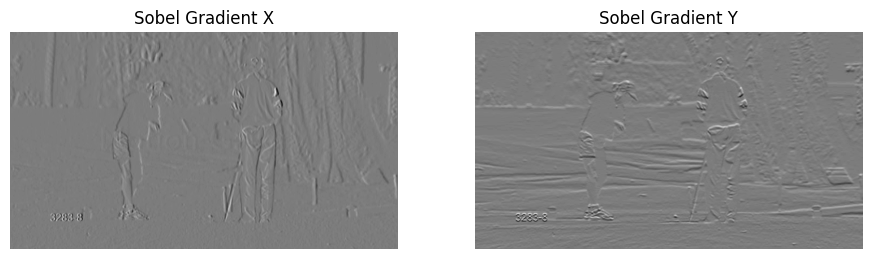

Flow dimension:  3
Flow shape: (404, 720, 2)
Padded Flow shape: (436, 752, 2)


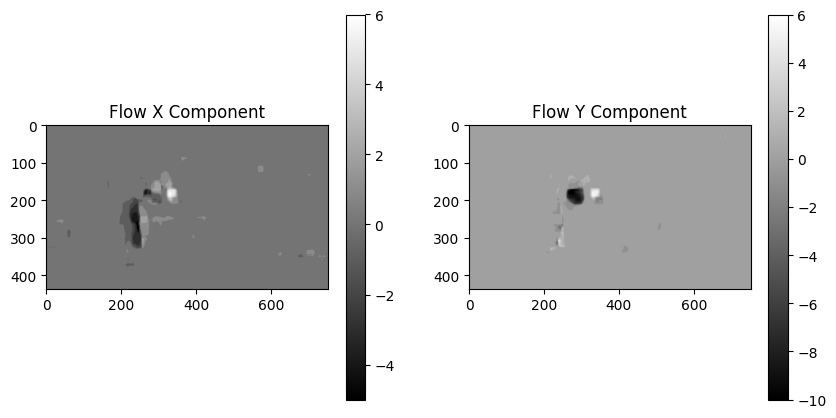

mbhx_padded shape: (436, 752, 2)
mbhy_padded shape: (436, 752, 2)


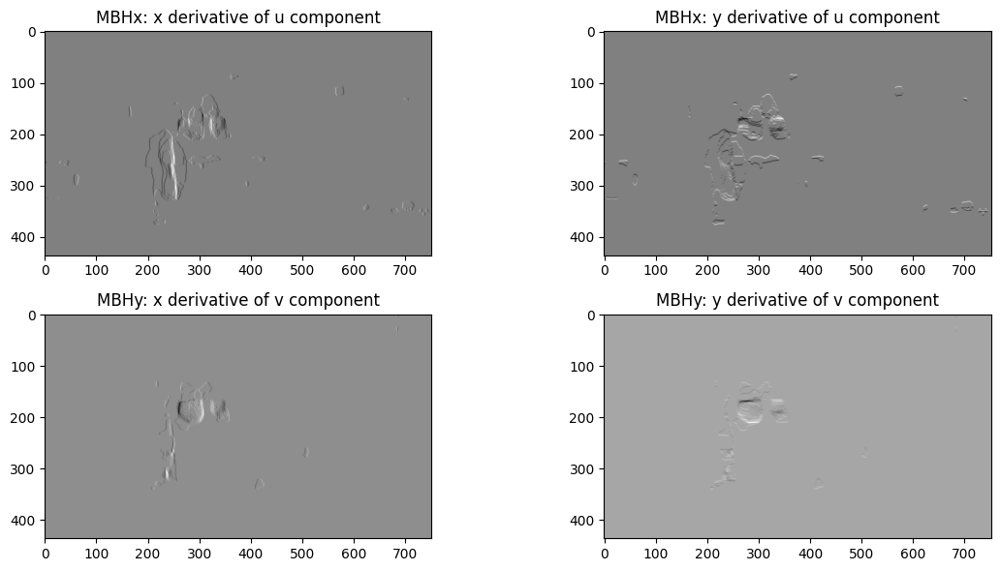

Corner shape: (1287, 1, 2)


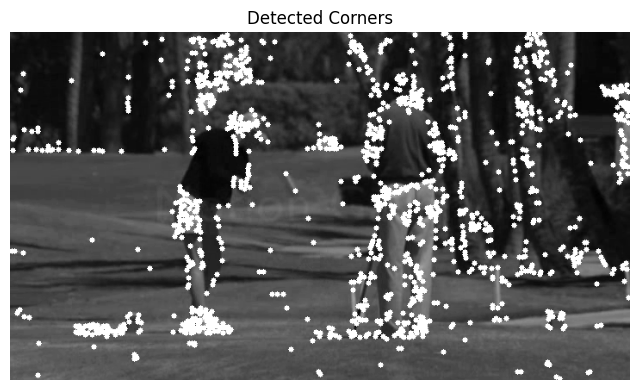

Length of Trajectory: 106
x: 212.0 y: 345.0
x: 205.0 y: 190.0
x: 225.0 y: 335.0
x: 260.0 y: 121.0
x: 280.0 y: 95.0
x: 255.0 y: 100.0
x: 240.0 y: 340.0
x: 460.0 y: 55.0
x: 270.0 y: 121.0
x: 445.0 y: 210.0
x: 210.0 y: 200.0
x: 460.0 y: 180.0
x: 220.0 y: 35.0
x: 420.0 y: 245.0
x: 645.0 y: 340.0
x: 435.0 y: 180.0
x: 363.0 y: 319.0
x: 218.0 y: 320.0
x: 710.0 y: 170.0
x: 425.0 y: 195.0
x: 410.0 y: 30.0
x: 495.0 y: 220.0
x: 380.0 y: 135.0
x: 440.0 y: 330.0
x: 195.0 y: 220.0
x: 715.0 y: 145.0
x: 198.0 y: 190.0
x: 195.0 y: 330.0
x: 600.0 y: 15.0
x: 460.0 y: 255.0
x: 360.0 y: 125.0
x: 605.0 y: 105.0
x: 225.0 y: 25.0
x: 665.0 y: 265.0
x: 600.0 y: 150.0
x: 660.0 y: 220.0
x: 276.0 y: 143.0
x: 216.0 y: 205.0
x: 655.0 y: 265.0
x: 405.0 y: 290.0
x: 710.0 y: 65.0
x: 710.0 y: 95.0
x: 235.0 y: 60.0
x: 360.0 y: 135.0
x: 208.0 y: 335.0
x: 273.0 y: 217.0
x: 495.0 y: 205.0
x: 400.0 y: 20.0
x: 390.0 y: 321.0
x: 400.0 y: 325.0
x: 135.0 y: 330.0
x: 225.0 y: 75.0
x: 223.0 y: 260.0
x: 620.0 y: 55.0
x: 555.0 y: 35

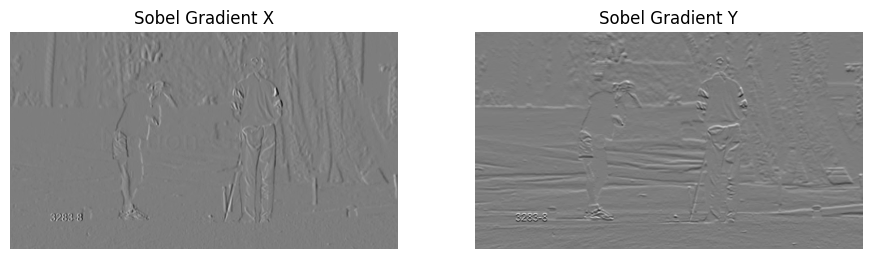

Flow dimension:  3
Flow shape: (404, 720, 2)
Padded Flow shape: (436, 752, 2)


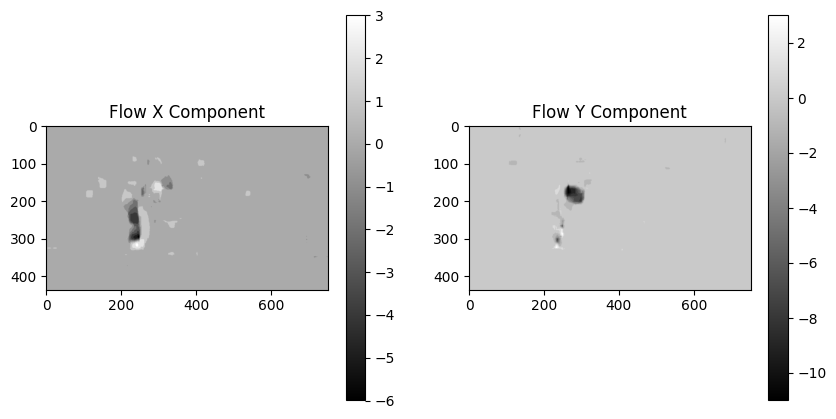

mbhx_padded shape: (436, 752, 2)
mbhy_padded shape: (436, 752, 2)


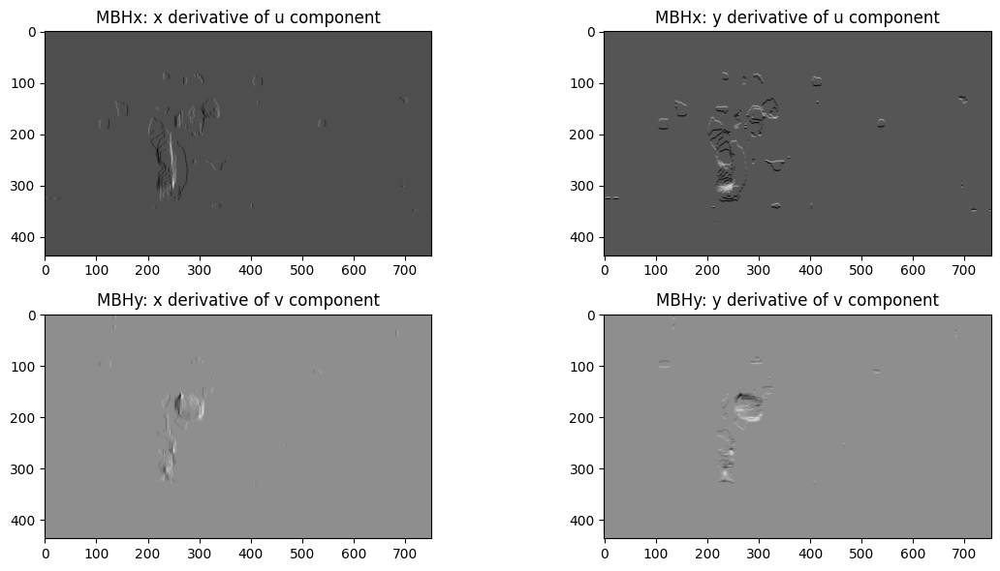

Corner shape: (1415, 1, 2)


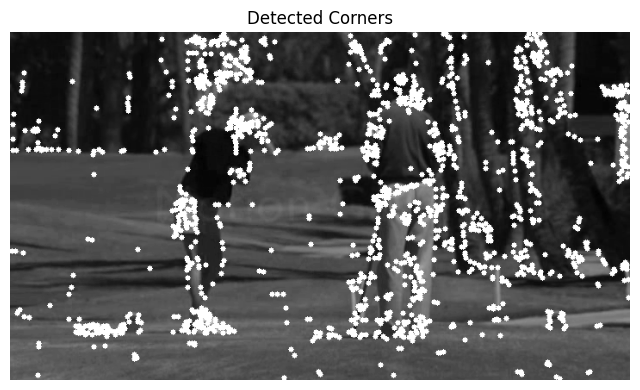

Length of Trajectory: 126
x: 212.0 y: 345.0
x: 204.0 y: 190.0
x: 225.0 y: 335.0
x: 260.0 y: 122.0
x: 280.0 y: 95.0
x: 255.0 y: 100.0
x: 240.0 y: 340.0
x: 460.0 y: 55.0
x: 270.0 y: 121.0
x: 445.0 y: 210.0
x: 208.0 y: 200.0
x: 460.0 y: 180.0
x: 220.0 y: 35.0
x: 420.0 y: 245.0
x: 645.0 y: 340.0
x: 435.0 y: 180.0
x: 363.0 y: 319.0
x: 218.0 y: 320.0
x: 710.0 y: 170.0
x: 425.0 y: 195.0
x: 410.0 y: 30.0
x: 495.0 y: 220.0
x: 380.0 y: 135.0
x: 440.0 y: 330.0
x: 194.0 y: 220.0
x: 715.0 y: 145.0
x: 197.0 y: 190.0
x: 195.0 y: 330.0
x: 600.0 y: 15.0
x: 460.0 y: 255.0
x: 360.0 y: 125.0
x: 605.0 y: 105.0
x: 225.0 y: 25.0
x: 665.0 y: 265.0
x: 600.0 y: 150.0
x: 660.0 y: 220.0
x: 278.0 y: 143.0
x: 213.0 y: 205.0
x: 655.0 y: 265.0
x: 405.0 y: 290.0
x: 710.0 y: 65.0
x: 710.0 y: 95.0
x: 235.0 y: 60.0
x: 360.0 y: 135.0
x: 208.0 y: 335.0
x: 273.0 y: 217.0
x: 495.0 y: 205.0
x: 400.0 y: 20.0
x: 390.0 y: 321.0
x: 400.0 y: 325.0
x: 135.0 y: 330.0
x: 225.0 y: 75.0
x: 220.0 y: 258.0
x: 620.0 y: 55.0
x: 555.0 y: 35

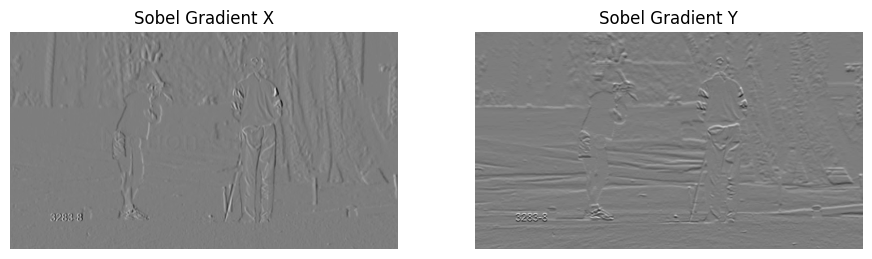

Flow dimension:  3
Flow shape: (404, 720, 2)
Padded Flow shape: (436, 752, 2)


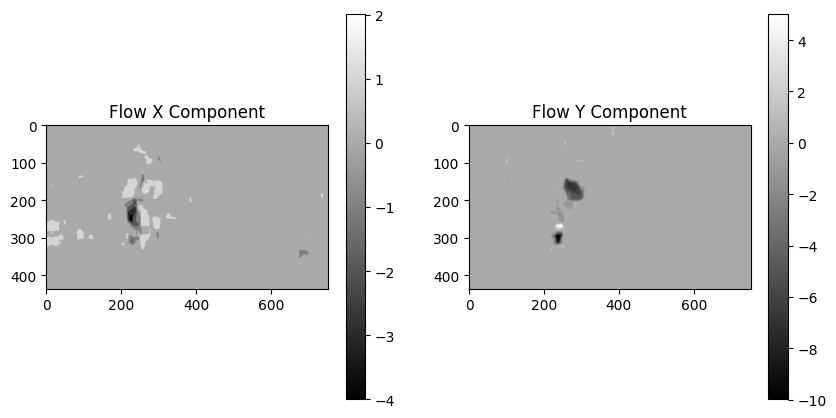

mbhx_padded shape: (436, 752, 2)
mbhy_padded shape: (436, 752, 2)


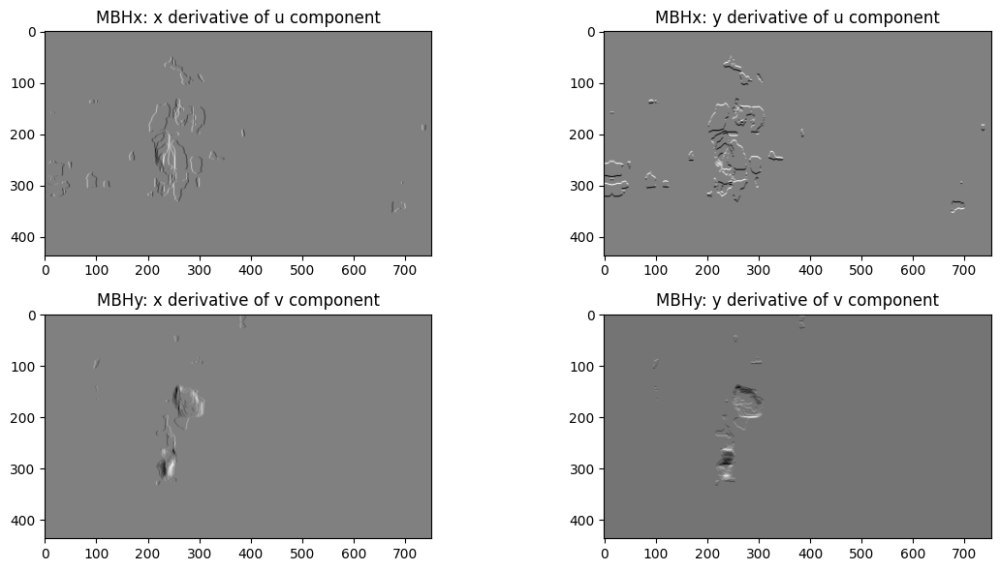

Corner shape: (1398, 1, 2)


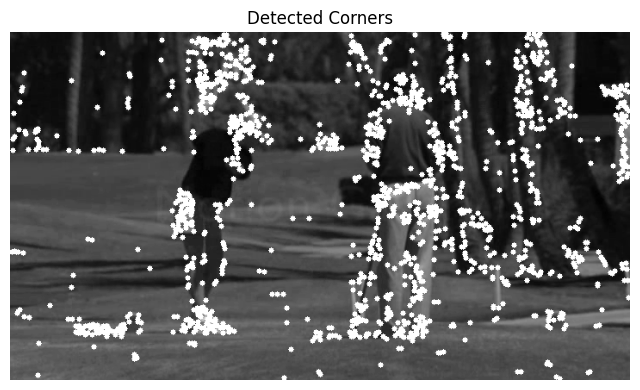

Length of Trajectory: 140
x: 212.0 y: 345.0
x: 203.0 y: 190.0
x: 225.0 y: 335.0
x: 260.0 y: 122.0
x: 280.0 y: 95.0
x: 255.0 y: 100.0
x: 240.0 y: 340.0
x: 460.0 y: 55.0
x: 270.0 y: 121.0
x: 445.0 y: 210.0
x: 206.0 y: 200.0
x: 460.0 y: 180.0
x: 220.0 y: 35.0
x: 420.0 y: 245.0
x: 645.0 y: 340.0
x: 435.0 y: 180.0
x: 363.0 y: 319.0
x: 218.0 y: 320.0
x: 710.0 y: 170.0
x: 425.0 y: 195.0
x: 410.0 y: 30.0
x: 495.0 y: 220.0
x: 380.0 y: 135.0
x: 440.0 y: 330.0
x: 194.0 y: 220.0
x: 715.0 y: 145.0
x: 197.0 y: 190.0
x: 195.0 y: 330.0
x: 600.0 y: 15.0
x: 460.0 y: 255.0
x: 360.0 y: 125.0
x: 605.0 y: 105.0
x: 225.0 y: 25.0
x: 665.0 y: 265.0
x: 600.0 y: 150.0
x: 660.0 y: 220.0
x: 280.0 y: 143.0
x: 210.0 y: 205.0
x: 655.0 y: 265.0
x: 405.0 y: 290.0
x: 710.0 y: 65.0
x: 710.0 y: 95.0
x: 235.0 y: 60.0
x: 360.0 y: 135.0
x: 208.0 y: 335.0
x: 273.0 y: 217.0
x: 495.0 y: 205.0
x: 400.0 y: 20.0
x: 390.0 y: 321.0
x: 400.0 y: 325.0
x: 135.0 y: 330.0
x: 226.0 y: 75.0
x: 218.0 y: 259.0
x: 620.0 y: 55.0
x: 555.0 y: 35

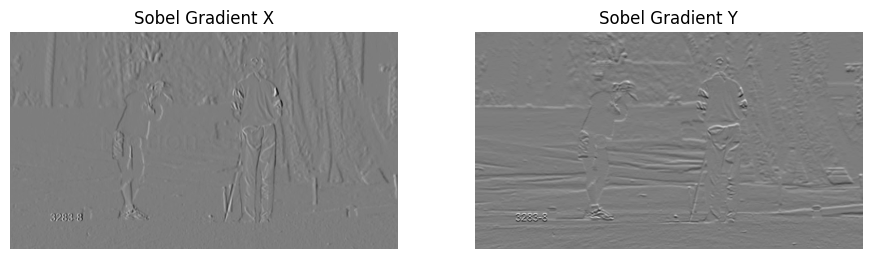

Flow dimension:  3
Flow shape: (404, 720, 2)
Padded Flow shape: (436, 752, 2)


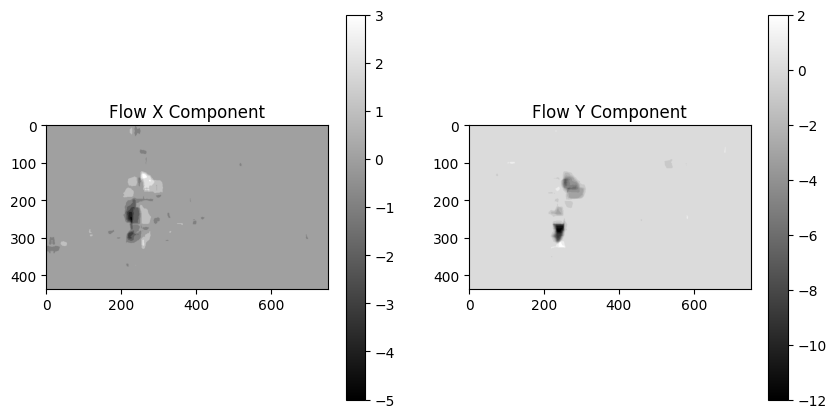

mbhx_padded shape: (436, 752, 2)
mbhy_padded shape: (436, 752, 2)


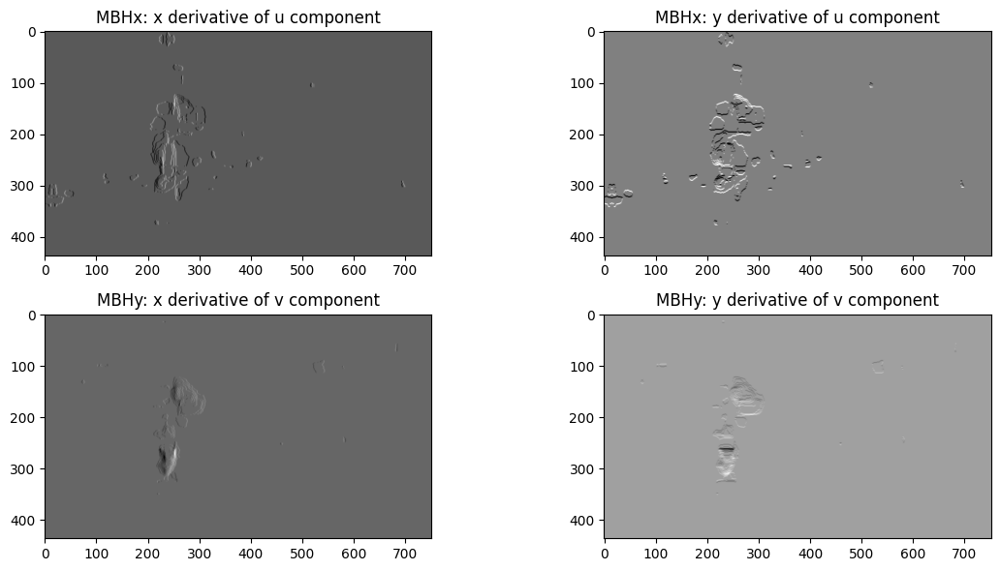

Corner shape: (1396, 1, 2)


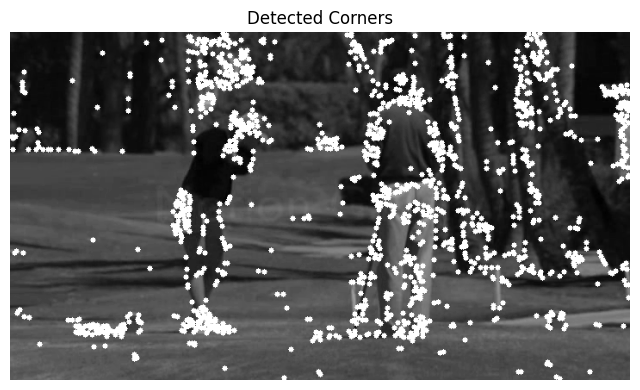

Length of Trajectory: 148
x: 212.0 y: 345.0
x: 202.0 y: 190.0
x: 225.0 y: 335.0
x: 260.0 y: 122.0
x: 280.0 y: 95.0
x: 255.0 y: 100.0
x: 240.0 y: 340.0
x: 460.0 y: 55.0
x: 270.0 y: 121.0
x: 445.0 y: 210.0
x: 204.0 y: 200.0
x: 460.0 y: 180.0
x: 220.0 y: 35.0
x: 420.0 y: 245.0
x: 645.0 y: 340.0
x: 435.0 y: 180.0
x: 363.0 y: 319.0
x: 218.0 y: 320.0
x: 710.0 y: 170.0
x: 425.0 y: 195.0
x: 410.0 y: 30.0
x: 495.0 y: 220.0
x: 380.0 y: 135.0
x: 440.0 y: 330.0
x: 194.0 y: 220.0
x: 715.0 y: 145.0
x: 197.0 y: 190.0
x: 195.0 y: 330.0
x: 600.0 y: 15.0
x: 460.0 y: 255.0
x: 360.0 y: 125.0
x: 605.0 y: 105.0
x: 225.0 y: 25.0
x: 665.0 y: 265.0
x: 600.0 y: 150.0
x: 660.0 y: 220.0
x: 281.0 y: 143.0
x: 208.0 y: 205.0
x: 655.0 y: 265.0
x: 405.0 y: 290.0
x: 710.0 y: 65.0
x: 710.0 y: 95.0
x: 235.0 y: 60.0
x: 360.0 y: 135.0
x: 208.0 y: 335.0
x: 273.0 y: 217.0
x: 495.0 y: 205.0
x: 400.0 y: 20.0
x: 390.0 y: 321.0
x: 400.0 y: 325.0
x: 135.0 y: 330.0
x: 226.0 y: 75.0
x: 217.0 y: 261.0
x: 620.0 y: 55.0
x: 555.0 y: 35

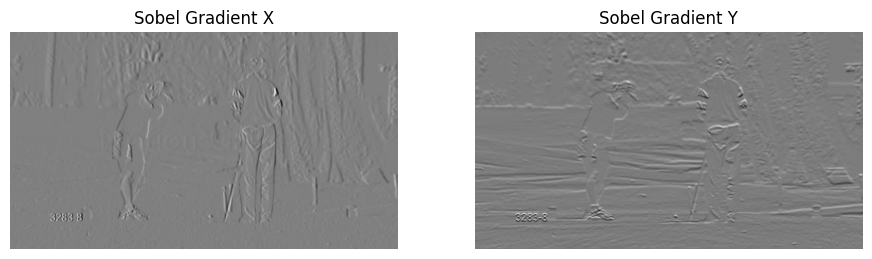

Flow dimension:  3
Flow shape: (404, 720, 2)
Padded Flow shape: (436, 752, 2)


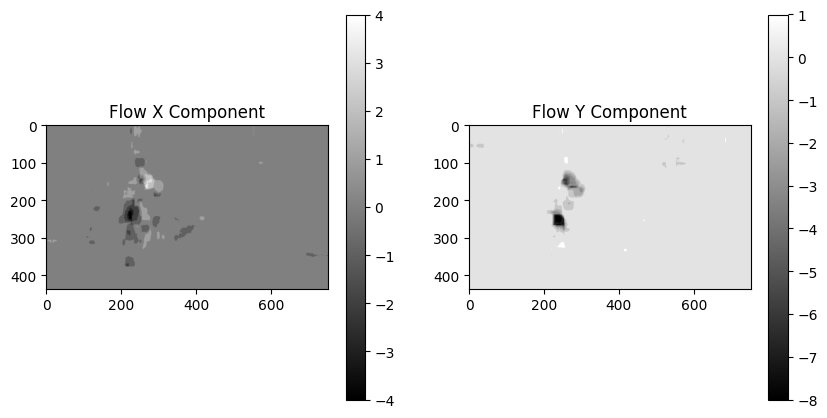

mbhx_padded shape: (436, 752, 2)
mbhy_padded shape: (436, 752, 2)


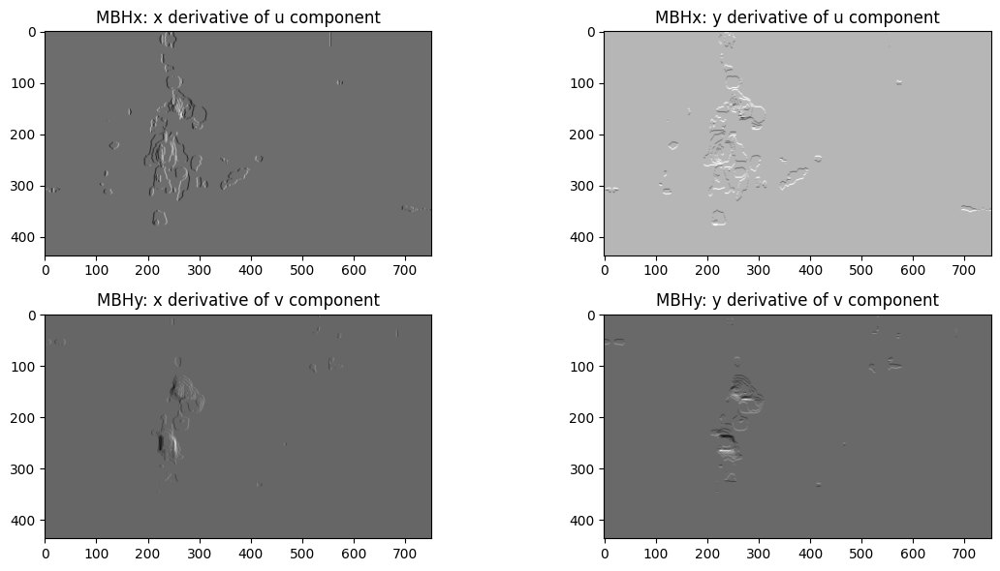

Corner shape: (1231, 1, 2)


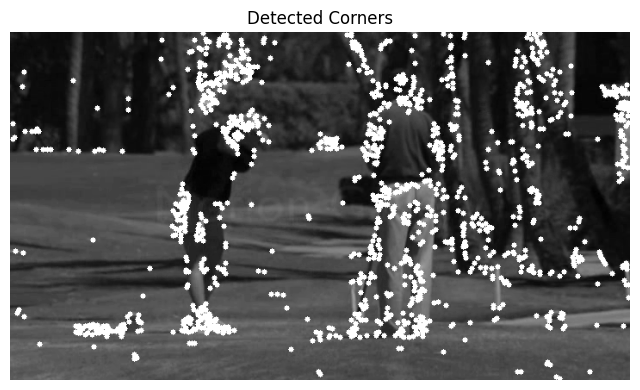

Length of Trajectory: 154
x: 212.0 y: 345.0
x: 201.0 y: 190.0
x: 225.0 y: 335.0
x: 262.0 y: 120.0
x: 280.0 y: 95.0
x: 255.0 y: 100.0
x: 240.0 y: 340.0
x: 460.0 y: 55.0
x: 270.0 y: 121.0
x: 445.0 y: 210.0
x: 202.0 y: 200.0
x: 460.0 y: 180.0
x: 220.0 y: 35.0
x: 420.0 y: 245.0
x: 645.0 y: 340.0
x: 435.0 y: 180.0
x: 363.0 y: 319.0
x: 218.0 y: 320.0
x: 710.0 y: 170.0
x: 425.0 y: 195.0
x: 410.0 y: 30.0
x: 495.0 y: 220.0
x: 380.0 y: 135.0
x: 440.0 y: 330.0
x: 193.0 y: 220.0
x: 715.0 y: 145.0
x: 197.0 y: 190.0
x: 195.0 y: 330.0
x: 600.0 y: 15.0
x: 460.0 y: 255.0
x: 360.0 y: 125.0
x: 605.0 y: 105.0
x: 225.0 y: 25.0
x: 665.0 y: 265.0
x: 600.0 y: 150.0
x: 660.0 y: 220.0
x: 282.0 y: 142.0
x: 206.0 y: 205.0
x: 655.0 y: 265.0
x: 405.0 y: 290.0
x: 710.0 y: 65.0
x: 710.0 y: 95.0
x: 235.0 y: 60.0
x: 360.0 y: 135.0
x: 208.0 y: 335.0
x: 273.0 y: 217.0
x: 495.0 y: 205.0
x: 400.0 y: 20.0
x: 390.0 y: 321.0
x: 400.0 y: 325.0
x: 135.0 y: 330.0
x: 226.0 y: 75.0
x: 216.0 y: 250.0
x: 620.0 y: 55.0
x: 555.0 y: 35

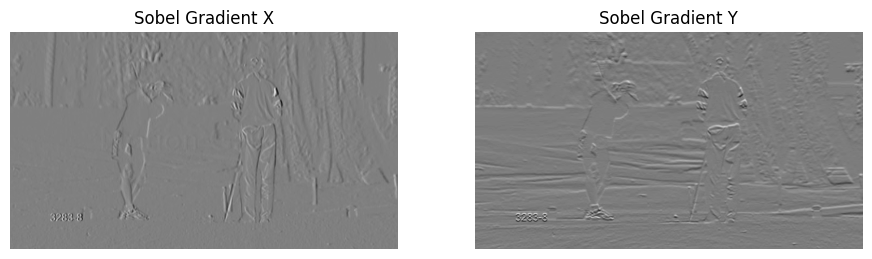

Flow dimension:  3
Flow shape: (404, 720, 2)
Padded Flow shape: (436, 752, 2)


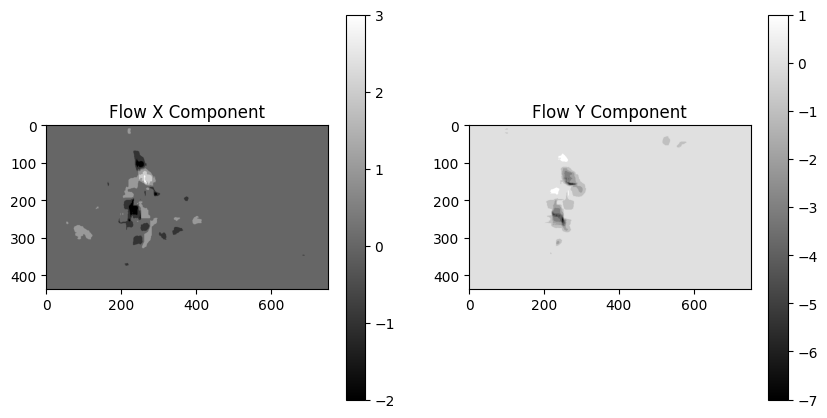

mbhx_padded shape: (436, 752, 2)
mbhy_padded shape: (436, 752, 2)


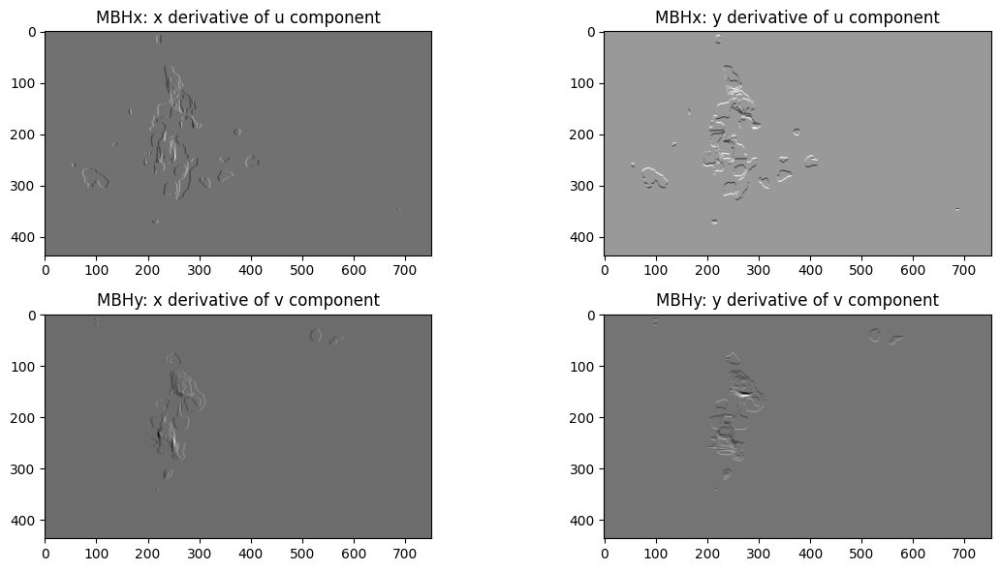

Corner shape: (1170, 1, 2)


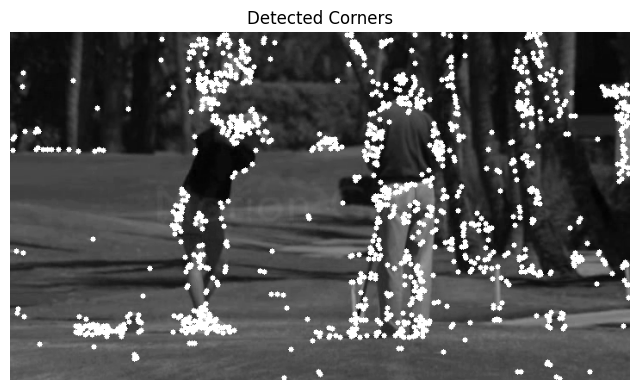

Length of Trajectory: 164
x: 211.0 y: 345.0
x: 200.0 y: 190.0
x: 225.0 y: 335.0
x: 264.0 y: 118.0
x: 280.0 y: 95.0
x: 255.0 y: 100.0
x: 240.0 y: 340.0
x: 460.0 y: 55.0
x: 270.0 y: 121.0
x: 445.0 y: 210.0
x: 201.0 y: 200.0
x: 460.0 y: 180.0
x: 220.0 y: 35.0
x: 420.0 y: 245.0
x: 645.0 y: 340.0
x: 435.0 y: 180.0
x: 363.0 y: 319.0
x: 218.0 y: 320.0
x: 710.0 y: 170.0
x: 425.0 y: 195.0
x: 410.0 y: 30.0
x: 495.0 y: 220.0
x: 380.0 y: 135.0
x: 440.0 y: 330.0
x: 192.0 y: 220.0
x: 715.0 y: 145.0
x: 196.0 y: 190.0
x: 195.0 y: 330.0
x: 600.0 y: 15.0
x: 460.0 y: 255.0
x: 360.0 y: 125.0
x: 605.0 y: 105.0
x: 225.0 y: 25.0
x: 665.0 y: 265.0
x: 600.0 y: 150.0
x: 660.0 y: 220.0
x: 283.0 y: 141.0
x: 204.0 y: 205.0
x: 655.0 y: 265.0
x: 405.0 y: 290.0
x: 710.0 y: 65.0
x: 710.0 y: 95.0
x: 235.0 y: 60.0
x: 360.0 y: 135.0
x: 207.0 y: 335.0
x: 273.0 y: 217.0
x: 495.0 y: 205.0
x: 400.0 y: 20.0
x: 390.0 y: 321.0
x: 400.0 y: 325.0
x: 135.0 y: 330.0
x: 225.0 y: 75.0
x: 215.0 y: 245.0
x: 620.0 y: 55.0
x: 555.0 y: 35

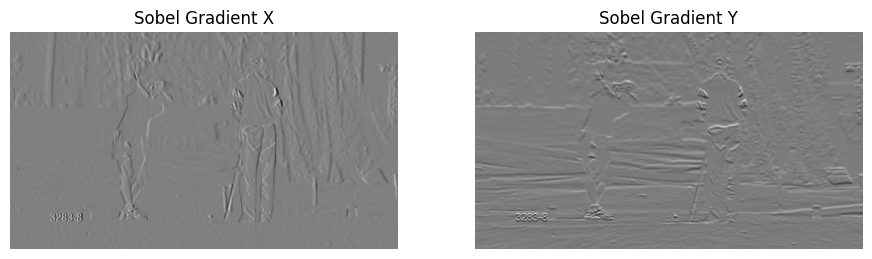

Flow dimension:  3
Flow shape: (404, 720, 2)
Padded Flow shape: (436, 752, 2)


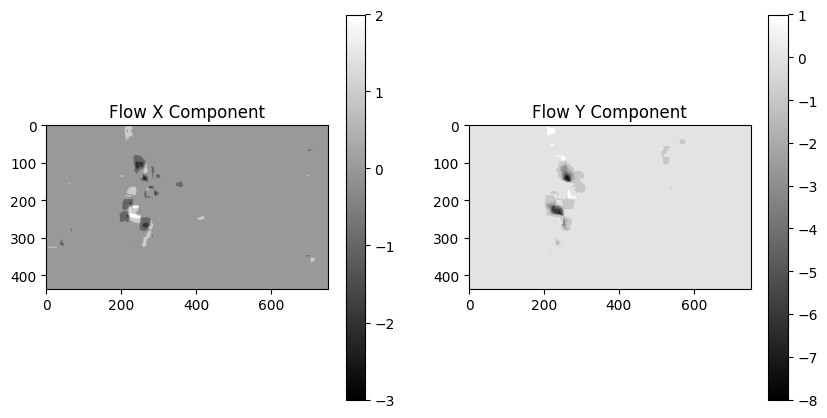

mbhx_padded shape: (436, 752, 2)
mbhy_padded shape: (436, 752, 2)


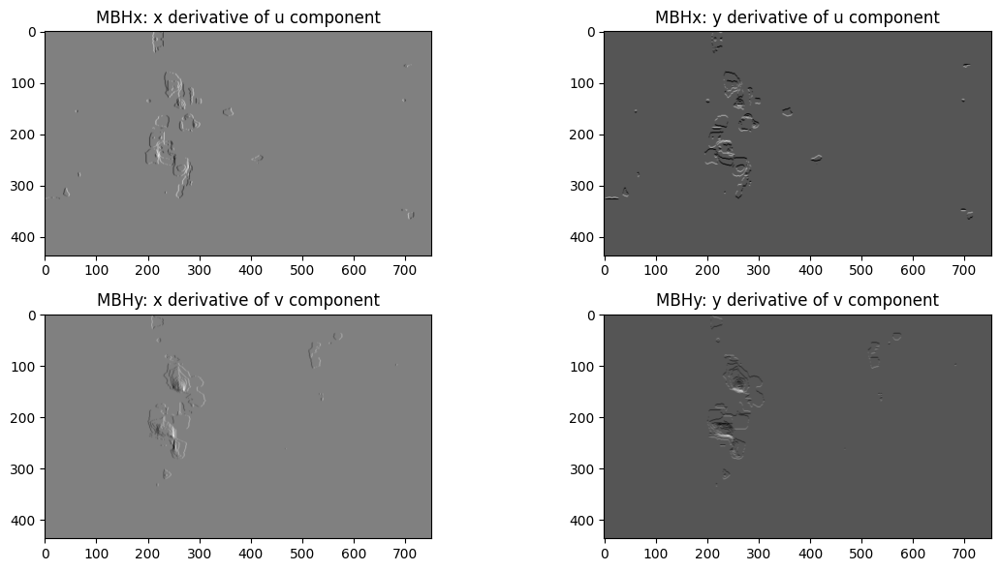

Corner shape: (1288, 1, 2)


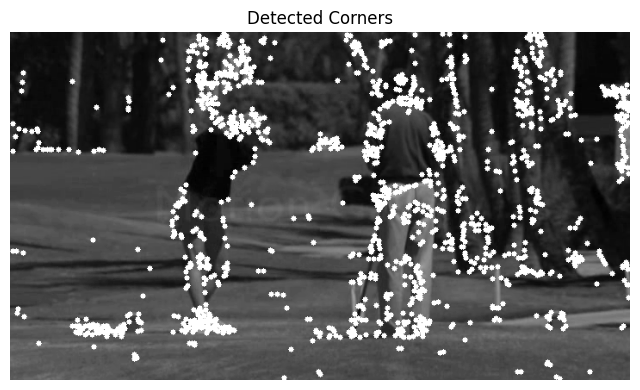

Length of Trajectory: 171
x: 211.0 y: 345.0
x: 199.0 y: 189.0
x: 225.0 y: 335.0
x: 266.0 y: 116.0
x: 280.0 y: 95.0
x: 255.0 y: 99.0
x: 240.0 y: 340.0
x: 460.0 y: 55.0
x: 271.0 y: 120.0
x: 445.0 y: 210.0
x: 200.0 y: 199.0
x: 460.0 y: 180.0
x: 220.0 y: 35.0
x: 420.0 y: 245.0
x: 645.0 y: 340.0
x: 435.0 y: 180.0
x: 363.0 y: 319.0
x: 218.0 y: 320.0
x: 710.0 y: 170.0
x: 425.0 y: 195.0
x: 410.0 y: 30.0
x: 495.0 y: 220.0
x: 380.0 y: 135.0
x: 440.0 y: 330.0
x: 192.0 y: 220.0
x: 715.0 y: 145.0
x: 195.0 y: 189.0
x: 195.0 y: 330.0
x: 600.0 y: 15.0
x: 460.0 y: 255.0
x: 360.0 y: 125.0
x: 605.0 y: 105.0
x: 225.0 y: 25.0
x: 665.0 y: 265.0
x: 600.0 y: 150.0
x: 660.0 y: 220.0
x: 283.0 y: 140.0
x: 203.0 y: 204.0
x: 655.0 y: 265.0
x: 405.0 y: 290.0
x: 710.0 y: 65.0
x: 710.0 y: 95.0
x: 235.0 y: 60.0
x: 360.0 y: 135.0
x: 207.0 y: 335.0
x: 273.0 y: 217.0
x: 495.0 y: 205.0
x: 400.0 y: 20.0
x: 390.0 y: 321.0
x: 400.0 y: 325.0
x: 135.0 y: 330.0
x: 224.0 y: 75.0
x: 214.0 y: 243.0
x: 620.0 y: 55.0
x: 555.0 y: 35.

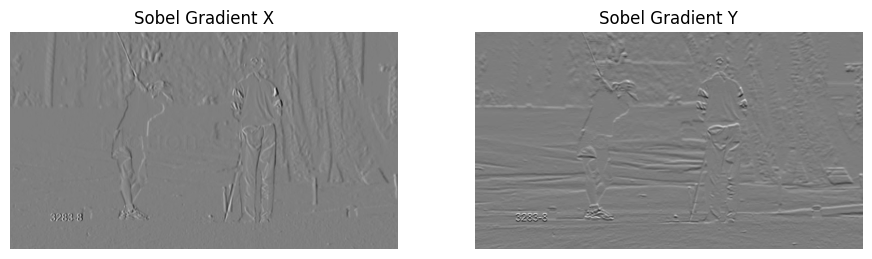

Flow dimension:  3
Flow shape: (404, 720, 2)
Padded Flow shape: (436, 752, 2)


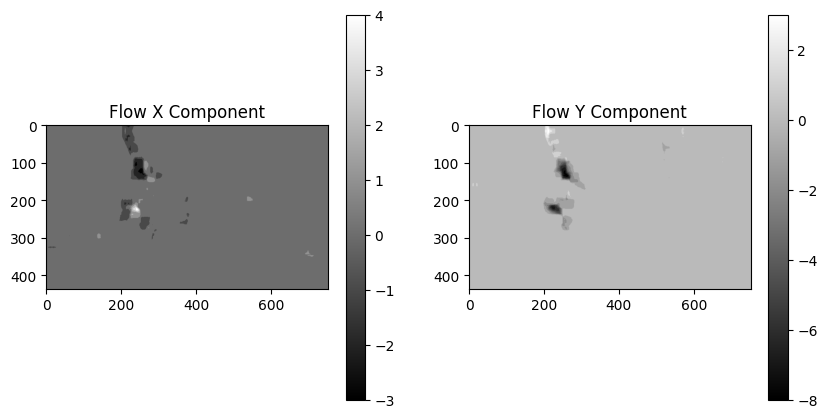

mbhx_padded shape: (436, 752, 2)
mbhy_padded shape: (436, 752, 2)


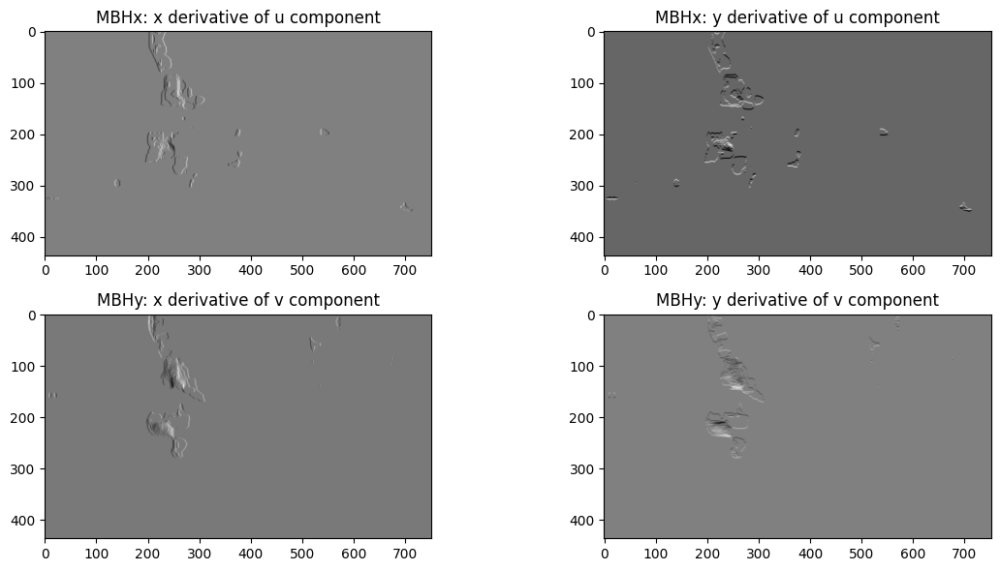

Corner shape: (1218, 1, 2)


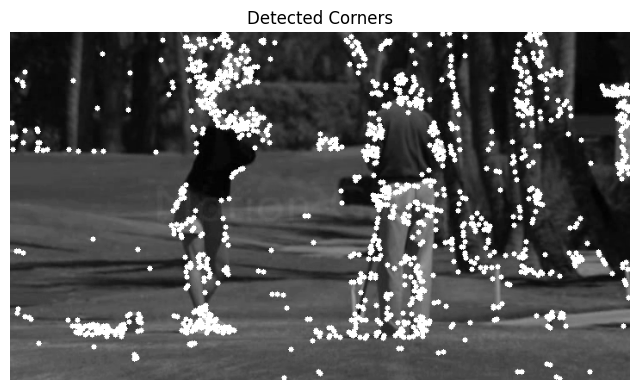

Length of Trajectory: 176
x: 211.0 y: 345.0
x: 198.0 y: 188.0
x: 225.0 y: 335.0
x: 266.0 y: 115.0
x: 280.0 y: 95.0
x: 255.0 y: 98.0
x: 240.0 y: 340.0
x: 460.0 y: 55.0
x: 271.0 y: 119.0
x: 445.0 y: 210.0
x: 199.0 y: 196.0
x: 460.0 y: 180.0
x: 220.0 y: 35.0
x: 420.0 y: 245.0
x: 645.0 y: 340.0
x: 435.0 y: 180.0
x: 363.0 y: 319.0
x: 218.0 y: 320.0
x: 710.0 y: 170.0
x: 425.0 y: 195.0
x: 410.0 y: 30.0
x: 495.0 y: 220.0
x: 380.0 y: 135.0
x: 440.0 y: 330.0
x: 191.0 y: 219.0
x: 715.0 y: 145.0
x: 194.0 y: 188.0
x: 195.0 y: 330.0
x: 600.0 y: 15.0
x: 460.0 y: 255.0
x: 360.0 y: 125.0
x: 605.0 y: 105.0
x: 225.0 y: 25.0
x: 665.0 y: 265.0
x: 600.0 y: 150.0
x: 660.0 y: 220.0
x: 283.0 y: 139.0
x: 203.0 y: 200.0
x: 655.0 y: 265.0
x: 405.0 y: 290.0
x: 710.0 y: 65.0
x: 710.0 y: 95.0
x: 235.0 y: 60.0
x: 360.0 y: 135.0
x: 207.0 y: 335.0
x: 273.0 y: 217.0
x: 495.0 y: 205.0
x: 400.0 y: 20.0
x: 390.0 y: 321.0
x: 400.0 y: 325.0
x: 135.0 y: 330.0
x: 223.0 y: 75.0
x: 214.0 y: 243.0
x: 620.0 y: 55.0
x: 555.0 y: 35.

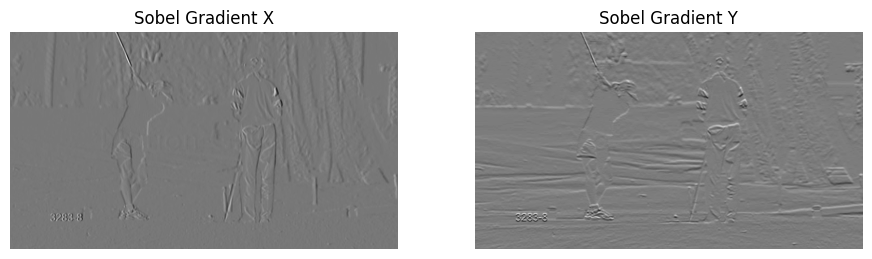

Flow dimension:  3
Flow shape: (404, 720, 2)
Padded Flow shape: (436, 752, 2)


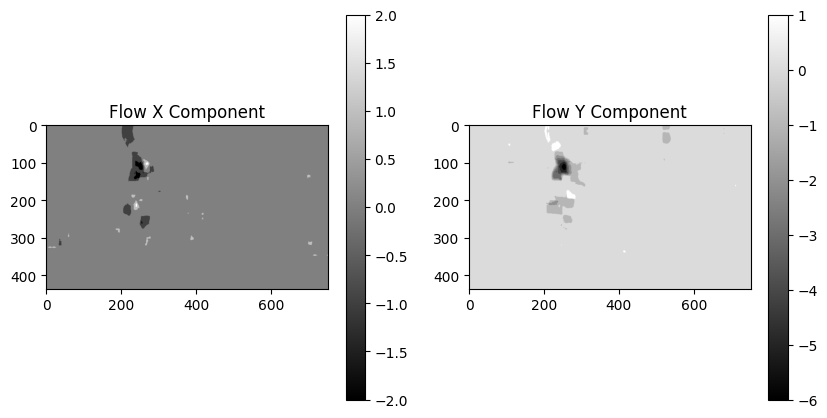

mbhx_padded shape: (436, 752, 2)
mbhy_padded shape: (436, 752, 2)


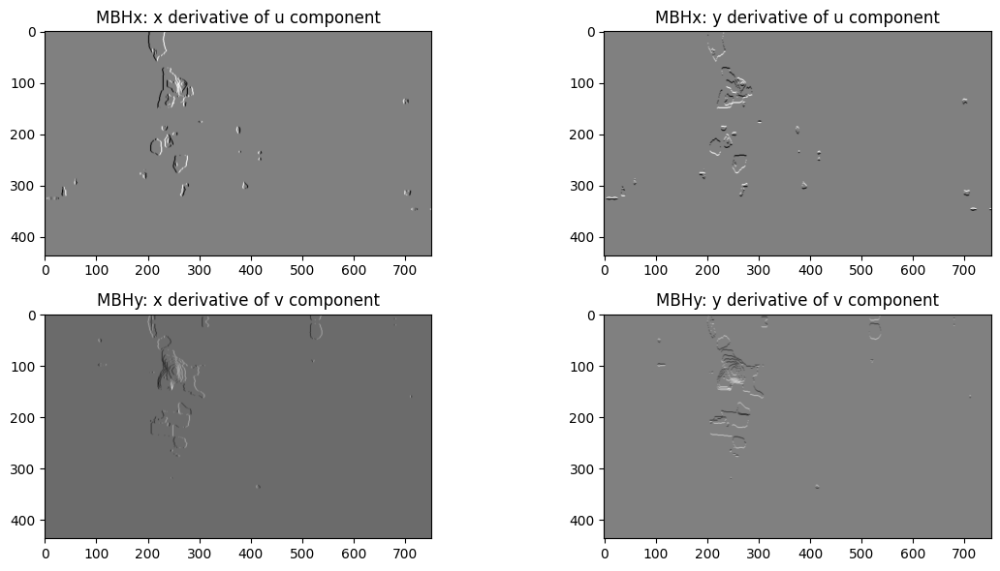

Corner shape: (1144, 1, 2)


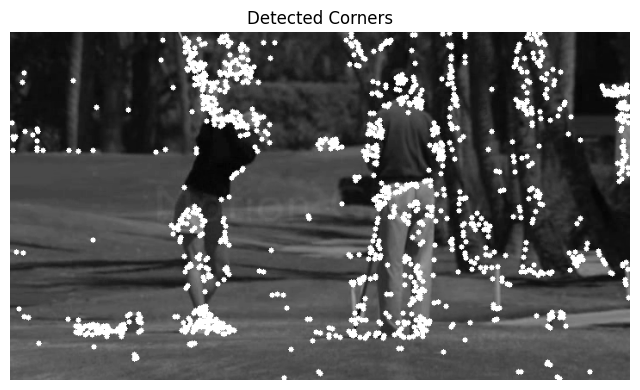

Length of Trajectory: 182
x: 211.0 y: 345.0
x: 197.0 y: 187.0
x: 225.0 y: 335.0
x: 266.0 y: 114.0
x: 280.0 y: 95.0
x: 255.0 y: 97.0
x: 240.0 y: 340.0
x: 460.0 y: 55.0
x: 271.0 y: 118.0
x: 445.0 y: 210.0
x: 198.0 y: 193.0
x: 460.0 y: 180.0
x: 219.0 y: 35.0
x: 420.0 y: 245.0
x: 645.0 y: 340.0
x: 435.0 y: 180.0
x: 363.0 y: 319.0
x: 218.0 y: 320.0
x: 710.0 y: 170.0
x: 425.0 y: 195.0
x: 410.0 y: 30.0
x: 495.0 y: 220.0
x: 380.0 y: 135.0
x: 440.0 y: 330.0
x: 190.0 y: 219.0
x: 715.0 y: 145.0
x: 193.0 y: 187.0
x: 195.0 y: 330.0
x: 600.0 y: 15.0
x: 460.0 y: 255.0
x: 360.0 y: 125.0
x: 605.0 y: 105.0
x: 225.0 y: 25.0
x: 665.0 y: 265.0
x: 600.0 y: 150.0
x: 660.0 y: 220.0
x: 283.0 y: 138.0
x: 203.0 y: 194.0
x: 655.0 y: 265.0
x: 405.0 y: 290.0
x: 710.0 y: 65.0
x: 710.0 y: 95.0
x: 235.0 y: 60.0
x: 360.0 y: 135.0
x: 207.0 y: 335.0
x: 273.0 y: 217.0
x: 495.0 y: 205.0
x: 400.0 y: 20.0
x: 390.0 y: 321.0
x: 400.0 y: 325.0
x: 135.0 y: 330.0
x: 221.0 y: 73.0
x: 214.0 y: 243.0
x: 620.0 y: 55.0
x: 555.0 y: 35.

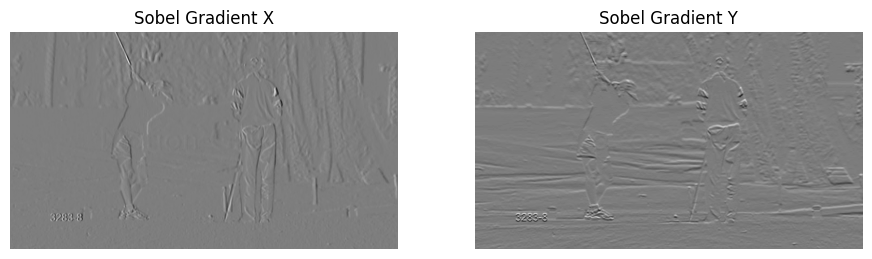

Flow dimension:  3
Flow shape: (404, 720, 2)
Padded Flow shape: (436, 752, 2)


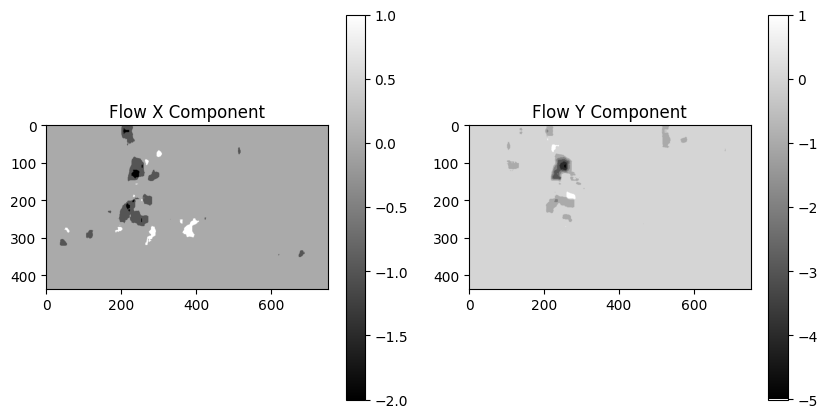

mbhx_padded shape: (436, 752, 2)
mbhy_padded shape: (436, 752, 2)


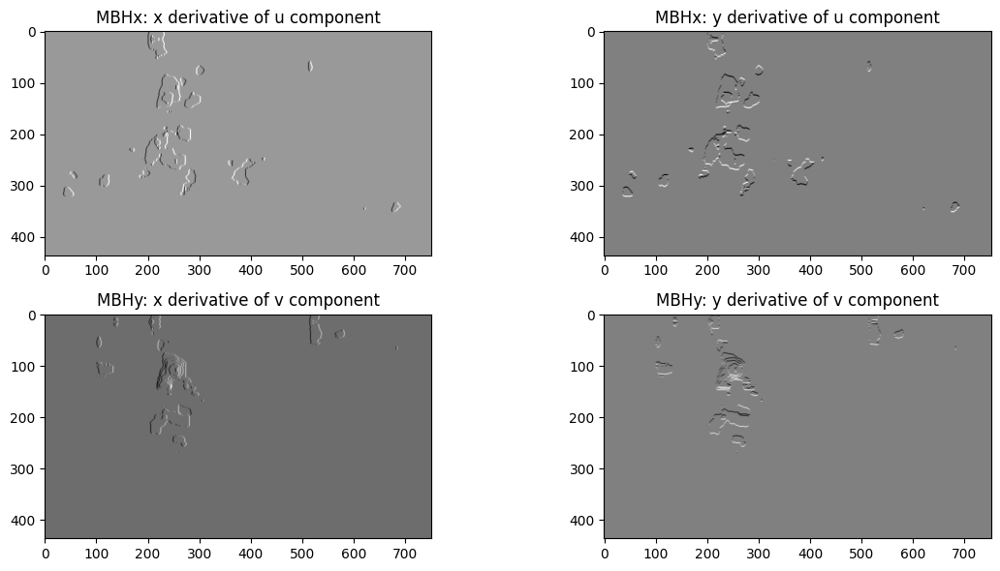

Corner shape: (1147, 1, 2)


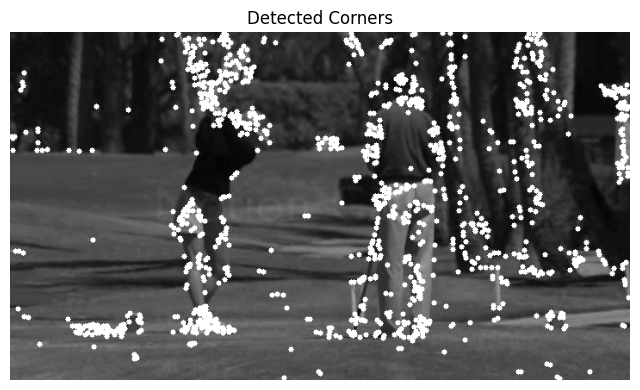

Length of Trajectory: 172
x: 197.0 y: 187.0
x: 266.0 y: 114.0
x: 255.0 y: 97.0
x: 460.0 y: 55.0
x: 445.0 y: 210.0
x: 460.0 y: 180.0
x: 420.0 y: 245.0
x: 435.0 y: 180.0
x: 218.0 y: 320.0
x: 425.0 y: 195.0
x: 495.0 y: 220.0
x: 440.0 y: 330.0
x: 715.0 y: 145.0
x: 195.0 y: 330.0
x: 460.0 y: 255.0
x: 605.0 y: 105.0
x: 665.0 y: 265.0
x: 660.0 y: 220.0
x: 203.0 y: 194.0
x: 655.0 y: 265.0
x: 405.0 y: 290.0
x: 710.0 y: 65.0
x: 710.0 y: 95.0
x: 235.0 y: 60.0
x: 360.0 y: 135.0
x: 207.0 y: 335.0
x: 273.0 y: 217.0
x: 495.0 y: 205.0
x: 400.0 y: 20.0
x: 390.0 y: 321.0
x: 400.0 y: 325.0
x: 135.0 y: 330.0
x: 220.0 y: 70.0
x: 214.0 y: 243.0
x: 620.0 y: 55.0
x: 555.0 y: 35.0
x: 222.0 y: 65.0
x: 195.0 y: 205.0
x: 605.0 y: 185.0
x: 277.0 y: 143.0
x: 420.0 y: 280.0
x: 231.0 y: 69.0
x: 525.0 y: 225.0
x: 215.0 y: 5.0
x: 710.0 y: 120.0
x: 203.0 y: 265.0
x: 45.0 y: 135.0
x: 240.0 y: 10.0
x: 268.0 y: 104.0
x: 210.0 y: 320.0
x: 220.0 y: 135.0
x: 243.0 y: 223.0
x: 505.0 y: 245.0
x: 192.0 y: 205.0
x: 264.0 y: 154.0

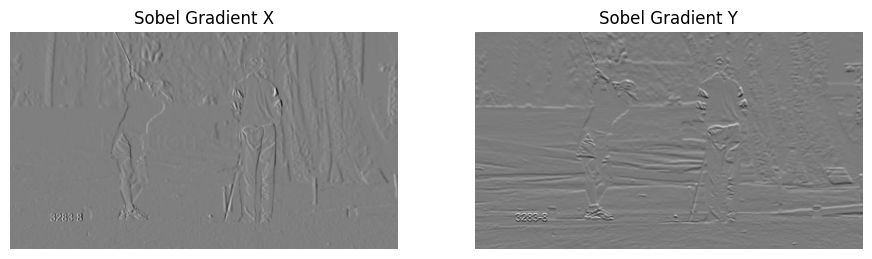

Flow dimension:  3
Flow shape: (404, 720, 2)
Padded Flow shape: (436, 752, 2)


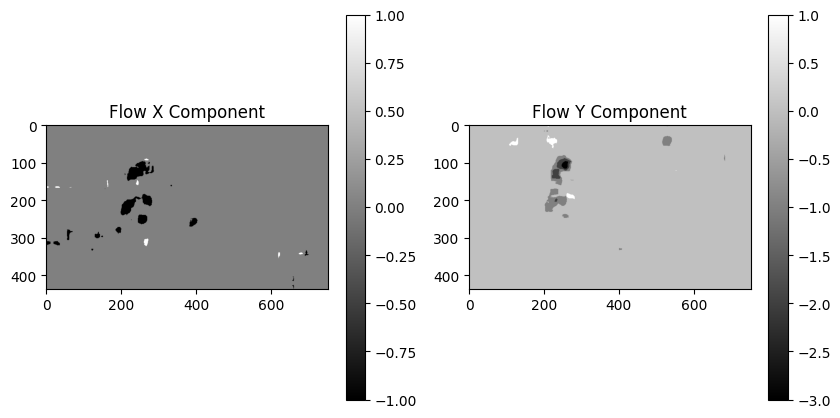

mbhx_padded shape: (436, 752, 2)
mbhy_padded shape: (436, 752, 2)


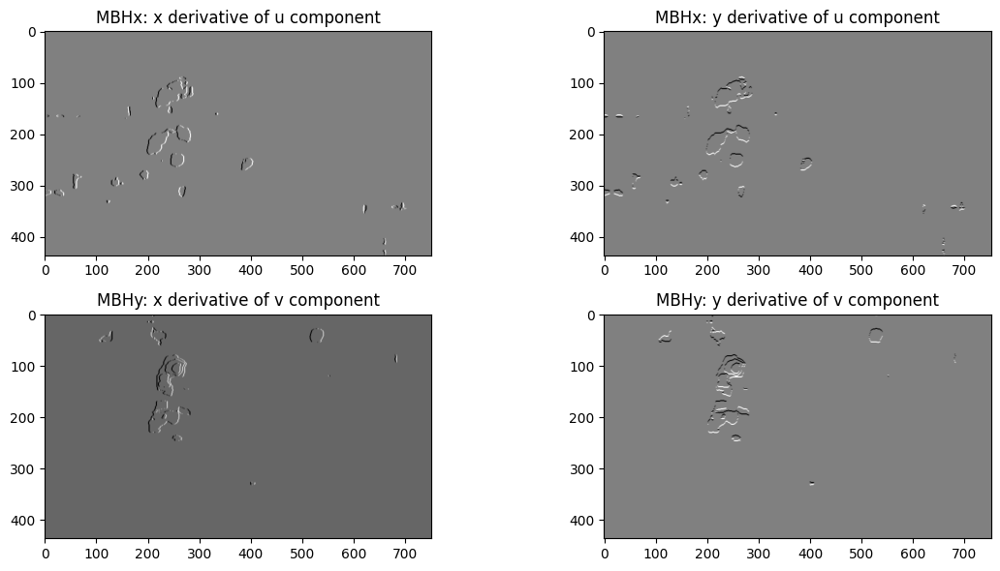

Corner shape: (1255, 1, 2)


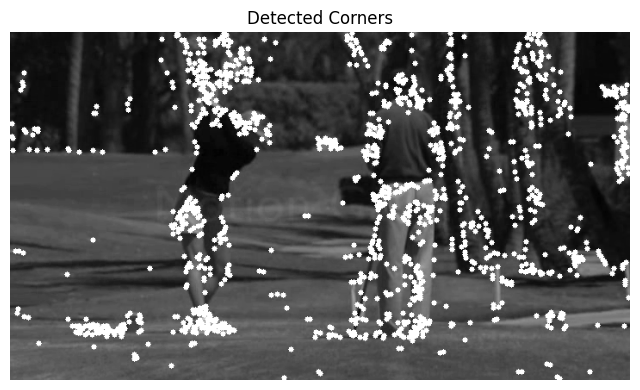

Length of Trajectory: 168
x: 266.0 y: 114.0
x: 460.0 y: 55.0
x: 460.0 y: 180.0
x: 435.0 y: 180.0
x: 425.0 y: 195.0
x: 440.0 y: 330.0
x: 195.0 y: 330.0
x: 605.0 y: 105.0
x: 660.0 y: 220.0
x: 201.0 y: 193.0
x: 405.0 y: 290.0
x: 710.0 y: 95.0
x: 360.0 y: 135.0
x: 273.0 y: 217.0
x: 400.0 y: 20.0
x: 400.0 y: 325.0
x: 135.0 y: 330.0
x: 219.0 y: 69.0
x: 213.0 y: 243.0
x: 620.0 y: 55.0
x: 555.0 y: 35.0
x: 222.0 y: 64.0
x: 194.0 y: 204.0
x: 605.0 y: 185.0
x: 277.0 y: 143.0
x: 420.0 y: 280.0
x: 231.0 y: 68.0
x: 525.0 y: 225.0
x: 215.0 y: 5.0
x: 710.0 y: 120.0
x: 203.0 y: 265.0
x: 45.0 y: 135.0
x: 240.0 y: 10.0
x: 268.0 y: 104.0
x: 210.0 y: 320.0
x: 220.0 y: 135.0
x: 243.0 y: 222.0
x: 505.0 y: 245.0
x: 191.0 y: 204.0
x: 264.0 y: 154.0
x: 635.0 y: 80.0
x: 212.0 y: 26.0
x: 395.0 y: 5.0
x: 465.0 y: 350.0
x: 202.0 y: 184.0
x: 214.0 y: 47.0
x: 500.0 y: 140.0
x: 475.0 y: 285.0
x: 189.0 y: 235.0
x: 270.0 y: 40.0
x: 228.0 y: 72.0
x: 343.0 y: 210.0
x: 184.0 y: 225.0
x: 245.0 y: 50.0
x: 270.0 y: 10.0
x: 18

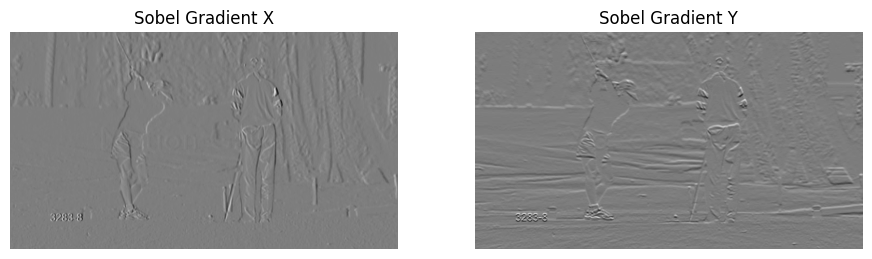

Flow dimension:  3
Flow shape: (404, 720, 2)
Padded Flow shape: (436, 752, 2)


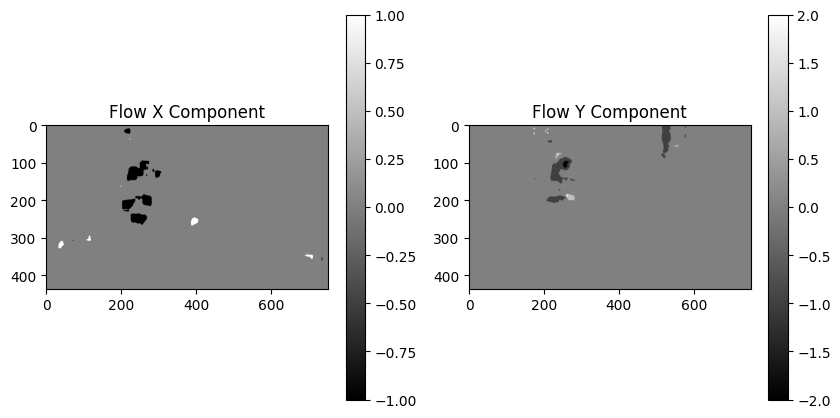

mbhx_padded shape: (436, 752, 2)
mbhy_padded shape: (436, 752, 2)


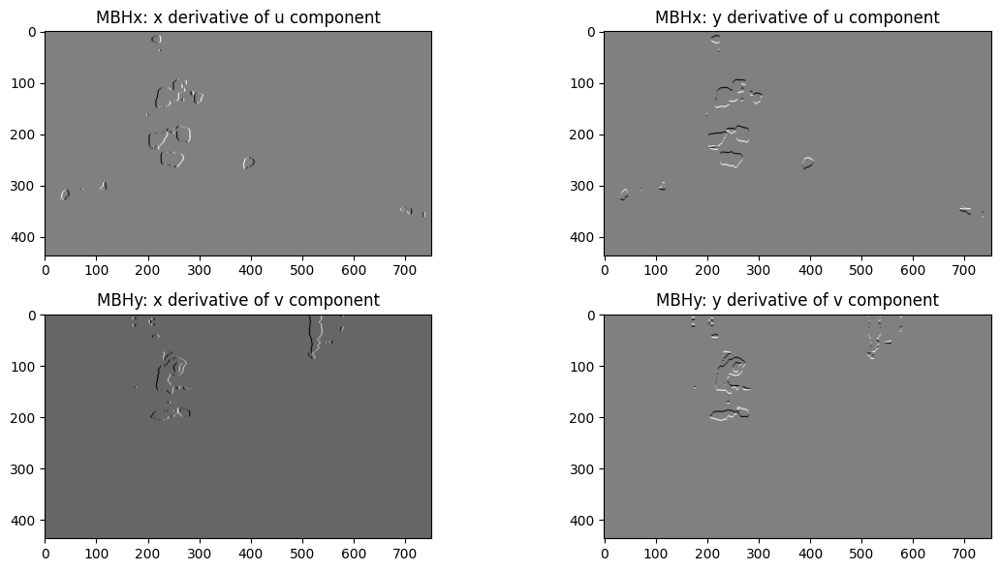

Corner shape: (1137, 1, 2)


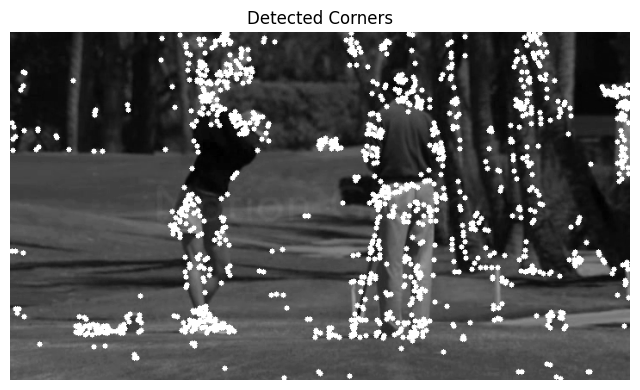

Length of Trajectory: 168
x: 460.0 y: 55.0
x: 435.0 y: 180.0
x: 440.0 y: 330.0
x: 605.0 y: 105.0
x: 201.0 y: 193.0
x: 710.0 y: 95.0
x: 273.0 y: 217.0
x: 400.0 y: 325.0
x: 219.0 y: 69.0
x: 620.0 y: 55.0
x: 222.0 y: 64.0
x: 605.0 y: 185.0
x: 420.0 y: 280.0
x: 231.0 y: 67.0
x: 525.0 y: 225.0
x: 215.0 y: 5.0
x: 710.0 y: 120.0
x: 203.0 y: 265.0
x: 45.0 y: 135.0
x: 240.0 y: 10.0
x: 267.0 y: 104.0
x: 210.0 y: 320.0
x: 220.0 y: 134.0
x: 243.0 y: 221.0
x: 505.0 y: 245.0
x: 190.0 y: 203.0
x: 264.0 y: 154.0
x: 635.0 y: 80.0
x: 212.0 y: 27.0
x: 395.0 y: 5.0
x: 465.0 y: 350.0
x: 201.0 y: 183.0
x: 214.0 y: 47.0
x: 500.0 y: 140.0
x: 475.0 y: 285.0
x: 189.0 y: 235.0
x: 270.0 y: 40.0
x: 228.0 y: 71.0
x: 343.0 y: 210.0
x: 184.0 y: 225.0
x: 245.0 y: 50.0
x: 270.0 y: 10.0
x: 188.0 y: 200.0
x: 515.0 y: 265.0
x: 150.0 y: 255.0
x: 210.0 y: 85.0
x: 201.0 y: 237.0
x: 192.0 y: 230.0
x: 600.0 y: 70.0
x: 560.0 y: 320.0
x: 277.0 y: 138.0
x: 480.0 y: 335.0
x: 630.0 y: 330.0
x: 525.0 y: 240.0
x: 344.0 y: 135.0
x: 43

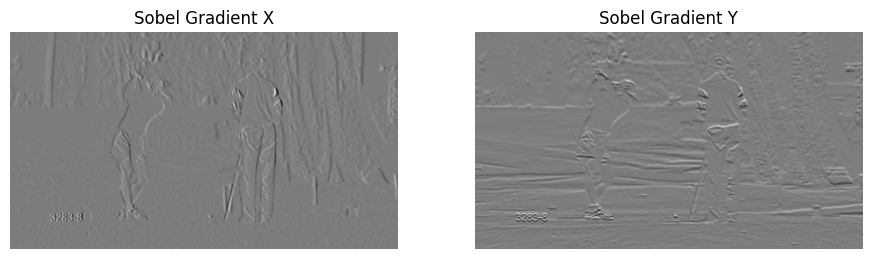

Flow dimension:  3
Flow shape: (404, 720, 2)
Padded Flow shape: (436, 752, 2)


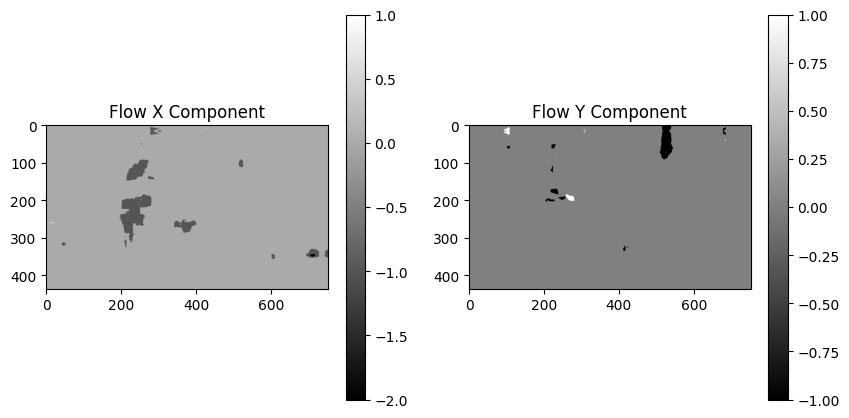

mbhx_padded shape: (436, 752, 2)
mbhy_padded shape: (436, 752, 2)


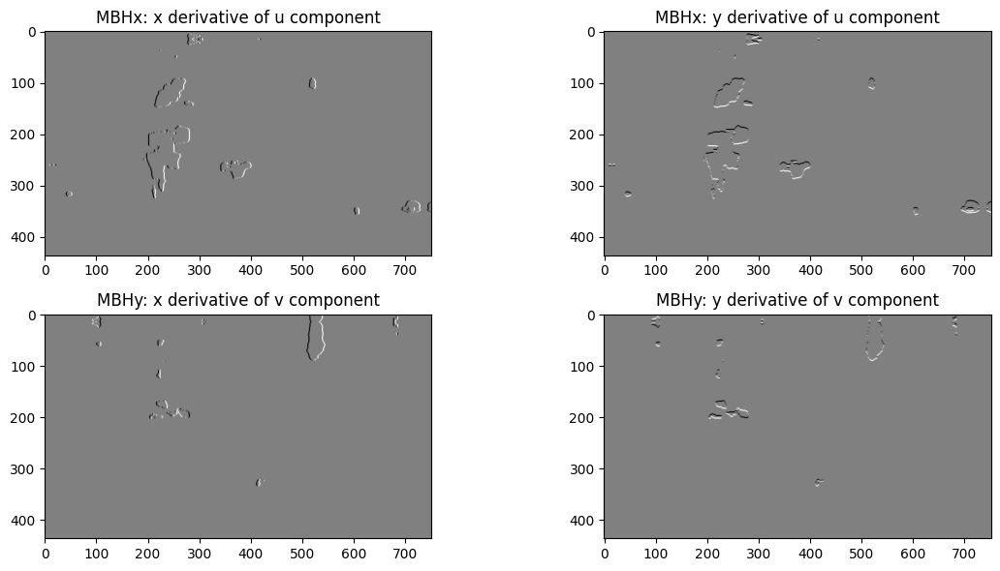

Corner shape: (1279, 1, 2)


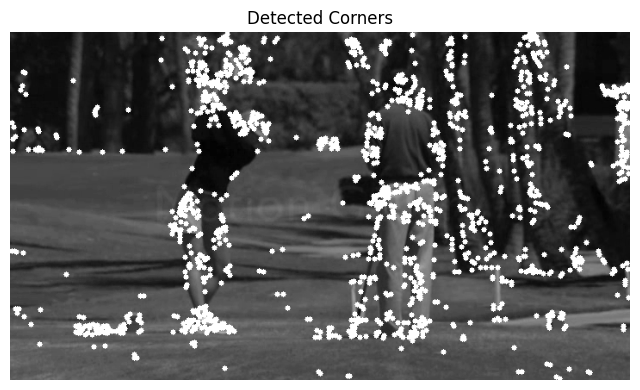

Length of Trajectory: 171
x: 435.0 y: 180.0
x: 605.0 y: 105.0
x: 710.0 y: 95.0
x: 400.0 y: 325.0
x: 620.0 y: 55.0
x: 605.0 y: 185.0
x: 420.0 y: 280.0
x: 525.0 y: 225.0
x: 710.0 y: 120.0
x: 45.0 y: 135.0
x: 267.0 y: 104.0
x: 210.0 y: 320.0
x: 220.0 y: 134.0
x: 243.0 y: 221.0
x: 505.0 y: 245.0
x: 189.0 y: 203.0
x: 264.0 y: 154.0
x: 635.0 y: 80.0
x: 212.0 y: 27.0
x: 395.0 y: 5.0
x: 465.0 y: 350.0
x: 200.0 y: 182.0
x: 214.0 y: 47.0
x: 500.0 y: 140.0
x: 475.0 y: 285.0
x: 189.0 y: 235.0
x: 270.0 y: 40.0
x: 228.0 y: 71.0
x: 343.0 y: 210.0
x: 184.0 y: 225.0
x: 245.0 y: 50.0
x: 270.0 y: 10.0
x: 187.0 y: 200.0
x: 515.0 y: 265.0
x: 150.0 y: 255.0
x: 210.0 y: 84.0
x: 201.0 y: 237.0
x: 192.0 y: 230.0
x: 600.0 y: 70.0
x: 560.0 y: 320.0
x: 277.0 y: 138.0
x: 480.0 y: 335.0
x: 630.0 y: 330.0
x: 525.0 y: 240.0
x: 344.0 y: 135.0
x: 430.0 y: 335.0
x: 25.0 y: 115.0
x: 590.0 y: 95.0
x: 430.0 y: 110.0
x: 204.0 y: 345.0
x: 470.0 y: 295.0
x: 455.0 y: 215.0
x: 245.0 y: 215.0
x: 218.0 y: 55.0
x: 600.0 y: 260.0
x

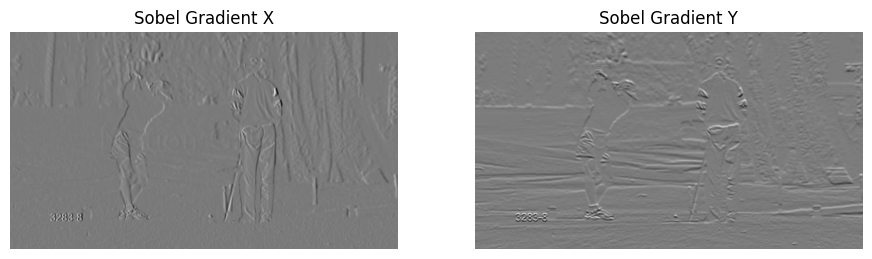

Flow dimension:  3
Flow shape: (404, 720, 2)
Padded Flow shape: (436, 752, 2)


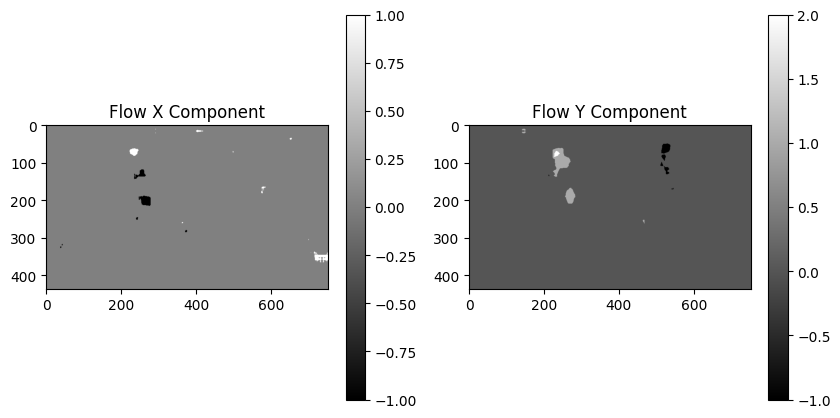

mbhx_padded shape: (436, 752, 2)
mbhy_padded shape: (436, 752, 2)


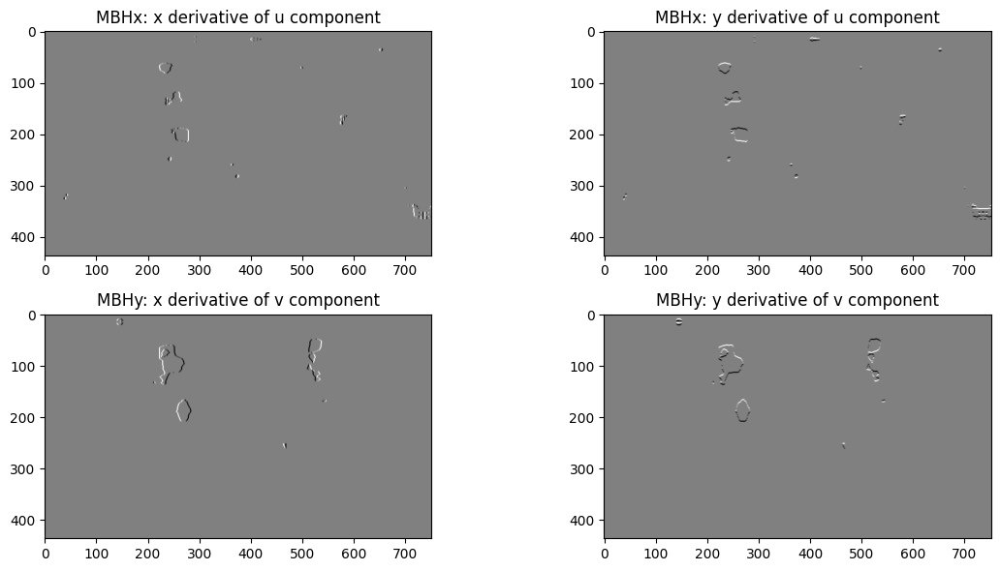

Corner shape: (1238, 1, 2)


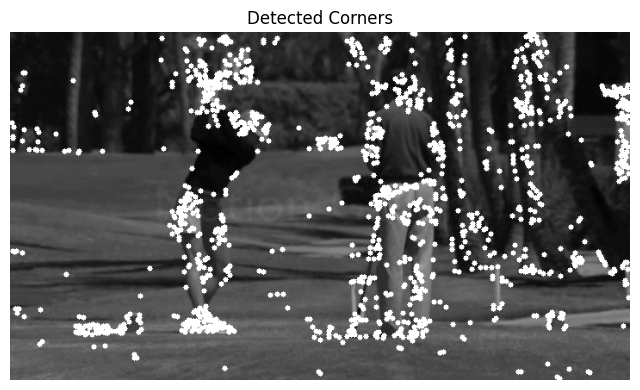

Length of Trajectory: 169
x: 605.0 y: 105.0
x: 400.0 y: 325.0
x: 605.0 y: 185.0
x: 525.0 y: 225.0
x: 45.0 y: 135.0
x: 267.0 y: 104.0
x: 220.0 y: 134.0
x: 505.0 y: 245.0
x: 264.0 y: 154.0
x: 212.0 y: 27.0
x: 465.0 y: 350.0
x: 214.0 y: 47.0
x: 500.0 y: 140.0
x: 475.0 y: 285.0
x: 188.0 y: 235.0
x: 270.0 y: 40.0
x: 228.0 y: 71.0
x: 343.0 y: 210.0
x: 183.0 y: 225.0
x: 245.0 y: 50.0
x: 270.0 y: 10.0
x: 186.0 y: 200.0
x: 515.0 y: 265.0
x: 150.0 y: 255.0
x: 210.0 y: 84.0
x: 200.0 y: 237.0
x: 191.0 y: 230.0
x: 600.0 y: 70.0
x: 560.0 y: 320.0
x: 277.0 y: 138.0
x: 480.0 y: 335.0
x: 630.0 y: 330.0
x: 525.0 y: 240.0
x: 344.0 y: 135.0
x: 430.0 y: 335.0
x: 25.0 y: 115.0
x: 590.0 y: 95.0
x: 430.0 y: 110.0
x: 204.0 y: 345.0
x: 470.0 y: 295.0
x: 455.0 y: 215.0
x: 245.0 y: 215.0
x: 218.0 y: 55.0
x: 600.0 y: 260.0
x: 500.0 y: 160.0
x: 615.0 y: 15.0
x: 525.0 y: 210.0
x: 250.0 y: 30.0
x: 321.0 y: 320.0
x: 600.0 y: 245.0
x: 520.0 y: 94.0
x: 35.0 y: 135.0
x: 225.0 y: 15.0
x: 90.0 y: 240.0
x: 520.0 y: 125.0
x:

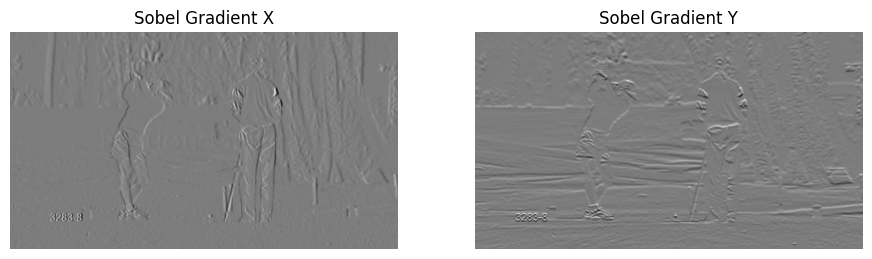

Flow dimension:  3
Flow shape: (404, 720, 2)
Padded Flow shape: (436, 752, 2)


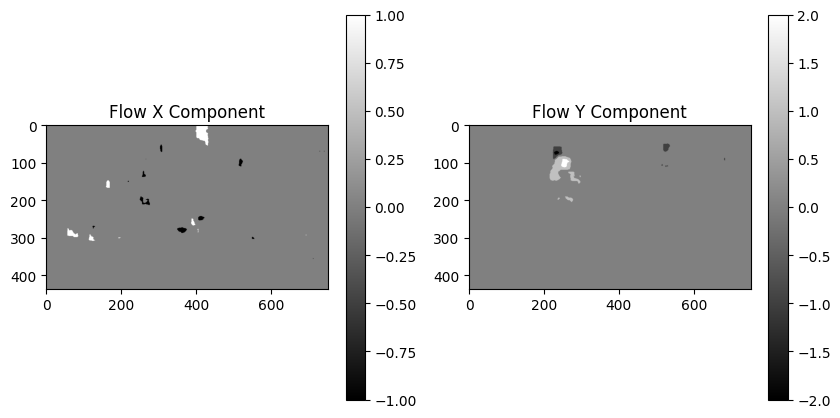

mbhx_padded shape: (436, 752, 2)
mbhy_padded shape: (436, 752, 2)


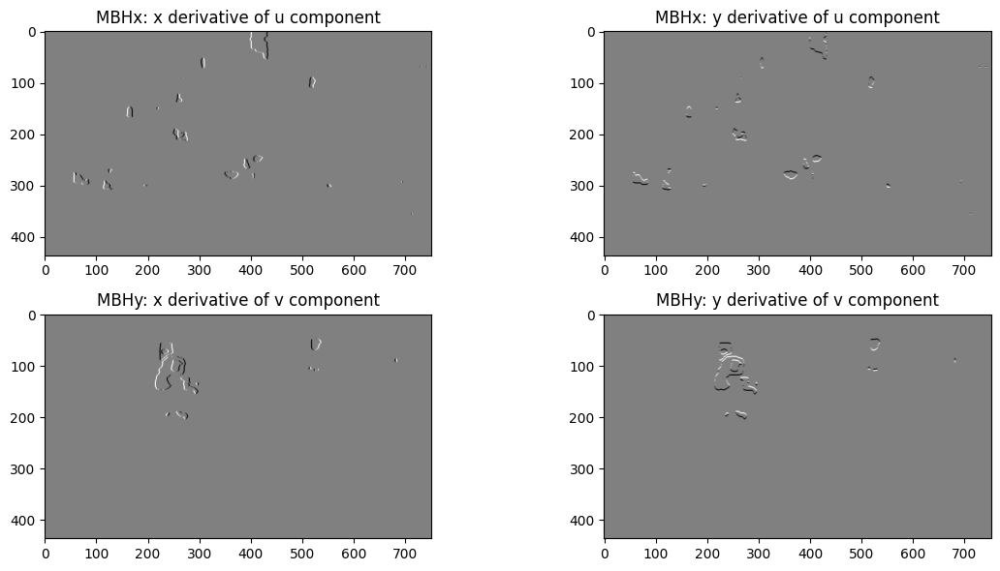

Corner shape: (1223, 1, 2)


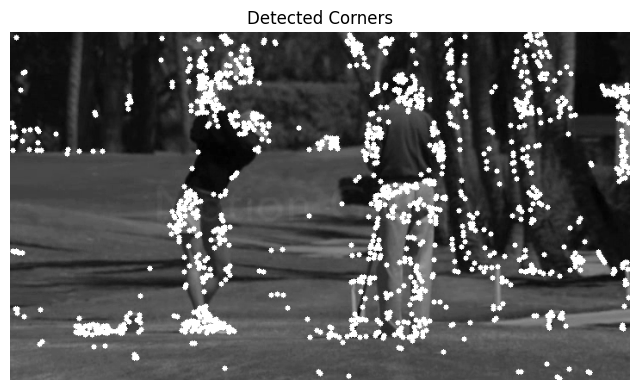

Length of Trajectory: 168
x: 400.0 y: 325.0
x: 525.0 y: 225.0
x: 267.0 y: 104.0
x: 505.0 y: 245.0
x: 212.0 y: 27.0
x: 214.0 y: 47.0
x: 475.0 y: 285.0
x: 270.0 y: 40.0
x: 343.0 y: 210.0
x: 245.0 y: 50.0
x: 186.0 y: 200.0
x: 150.0 y: 255.0
x: 200.0 y: 237.0
x: 191.0 y: 230.0
x: 600.0 y: 70.0
x: 560.0 y: 320.0
x: 277.0 y: 138.0
x: 480.0 y: 335.0
x: 630.0 y: 330.0
x: 525.0 y: 240.0
x: 344.0 y: 135.0
x: 430.0 y: 335.0
x: 25.0 y: 115.0
x: 590.0 y: 95.0
x: 430.0 y: 110.0
x: 204.0 y: 345.0
x: 470.0 y: 295.0
x: 455.0 y: 215.0
x: 245.0 y: 215.0
x: 219.0 y: 57.0
x: 600.0 y: 260.0
x: 500.0 y: 160.0
x: 615.0 y: 15.0
x: 525.0 y: 210.0
x: 250.0 y: 30.0
x: 321.0 y: 320.0
x: 600.0 y: 245.0
x: 520.0 y: 94.0
x: 35.0 y: 135.0
x: 225.0 y: 15.0
x: 90.0 y: 240.0
x: 520.0 y: 125.0
x: 685.0 y: 340.0
x: 249.0 y: 280.0
x: 330.0 y: 375.0
x: 251.0 y: 60.0
x: 385.0 y: 200.0
x: 526.0 y: 175.0
x: 271.0 y: 122.0
x: 515.0 y: 155.0
x: 520.0 y: 190.0
x: 515.0 y: 140.0
x: 281.0 y: 114.0
x: 244.0 y: 223.0
x: 250.0 y: 188.0

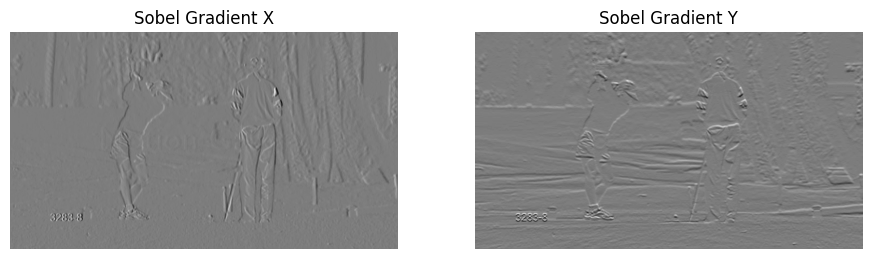

Flow dimension:  3
Flow shape: (404, 720, 2)
Padded Flow shape: (436, 752, 2)


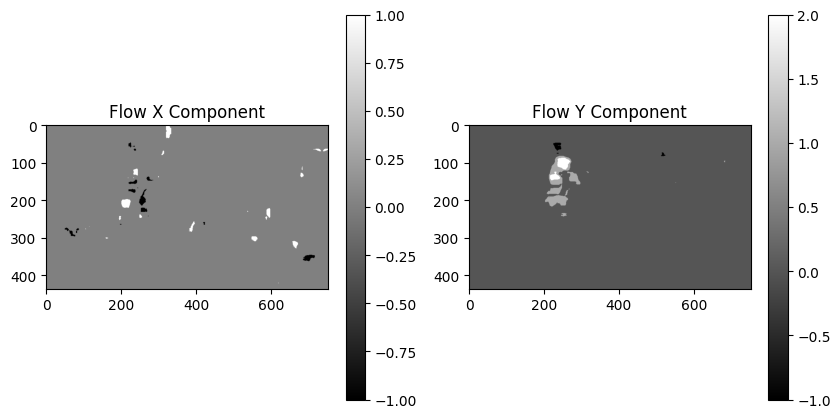

mbhx_padded shape: (436, 752, 2)
mbhy_padded shape: (436, 752, 2)


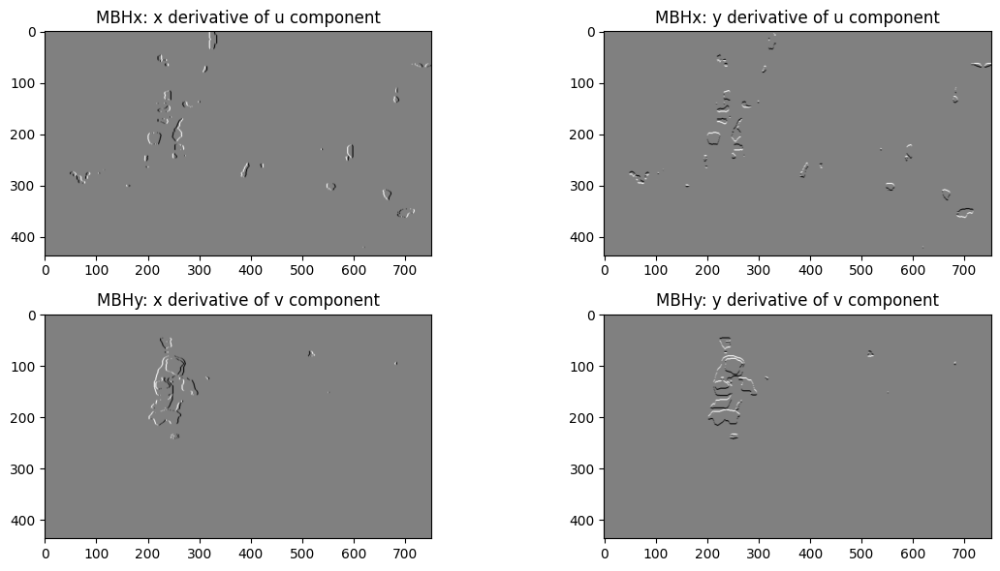

Corner shape: (1219, 1, 2)


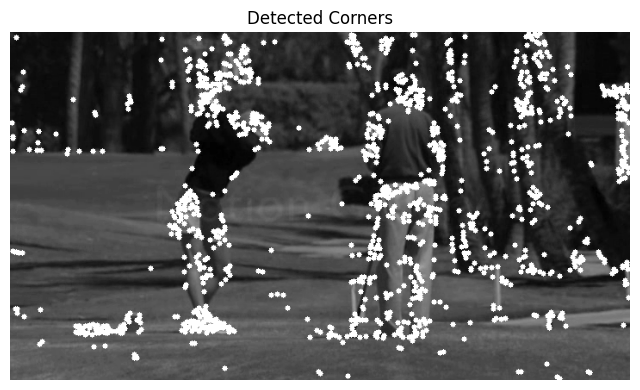

Length of Trajectory: 162
x: 525.0 y: 225.0
x: 505.0 y: 245.0
x: 214.0 y: 47.0
x: 270.0 y: 40.0
x: 245.0 y: 50.0
x: 150.0 y: 255.0
x: 200.0 y: 237.0
x: 600.0 y: 70.0
x: 277.0 y: 138.0
x: 630.0 y: 330.0
x: 344.0 y: 135.0
x: 25.0 y: 115.0
x: 430.0 y: 110.0
x: 204.0 y: 345.0
x: 470.0 y: 295.0
x: 455.0 y: 215.0
x: 245.0 y: 215.0
x: 219.0 y: 55.0
x: 600.0 y: 260.0
x: 500.0 y: 160.0
x: 615.0 y: 15.0
x: 525.0 y: 210.0
x: 250.0 y: 30.0
x: 321.0 y: 320.0
x: 600.0 y: 245.0
x: 520.0 y: 94.0
x: 35.0 y: 135.0
x: 225.0 y: 15.0
x: 90.0 y: 240.0
x: 520.0 y: 125.0
x: 685.0 y: 340.0
x: 249.0 y: 280.0
x: 330.0 y: 375.0
x: 251.0 y: 60.0
x: 385.0 y: 200.0
x: 526.0 y: 175.0
x: 271.0 y: 122.0
x: 515.0 y: 155.0
x: 520.0 y: 190.0
x: 515.0 y: 140.0
x: 281.0 y: 114.0
x: 244.0 y: 223.0
x: 250.0 y: 188.0
x: 280.0 y: 200.0
x: 700.0 y: 155.0
x: 535.0 y: 265.0
x: 515.0 y: 69.0
x: 295.0 y: 100.0
x: 250.0 y: 40.0
x: 235.0 y: 25.0
x: 545.0 y: 230.0
x: 200.0 y: 274.0
x: 555.0 y: 240.0
x: 95.0 y: 135.0
x: 445.0 y: 80.0
x:

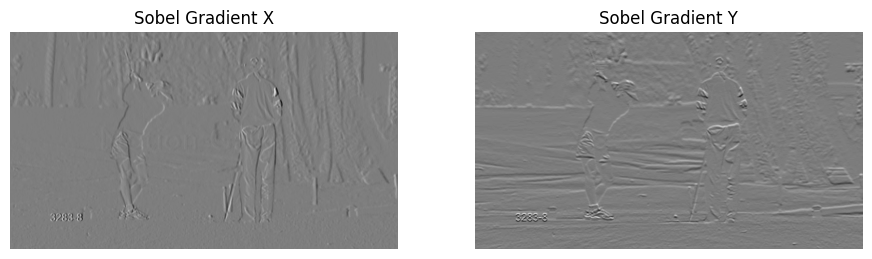

Flow dimension:  3
Flow shape: (404, 720, 2)
Padded Flow shape: (436, 752, 2)


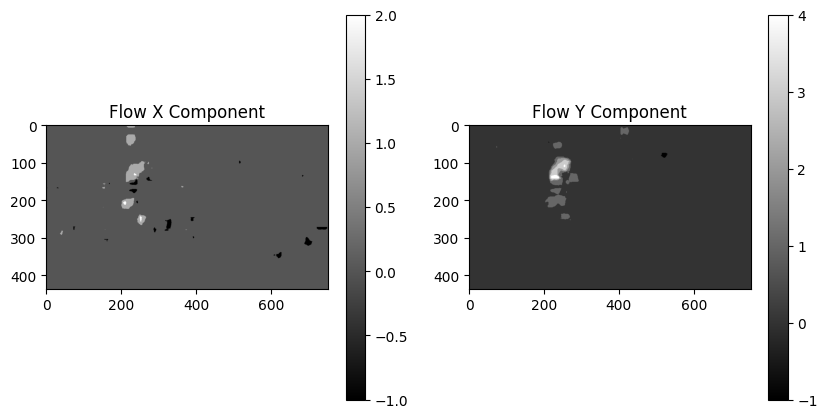

mbhx_padded shape: (436, 752, 2)
mbhy_padded shape: (436, 752, 2)


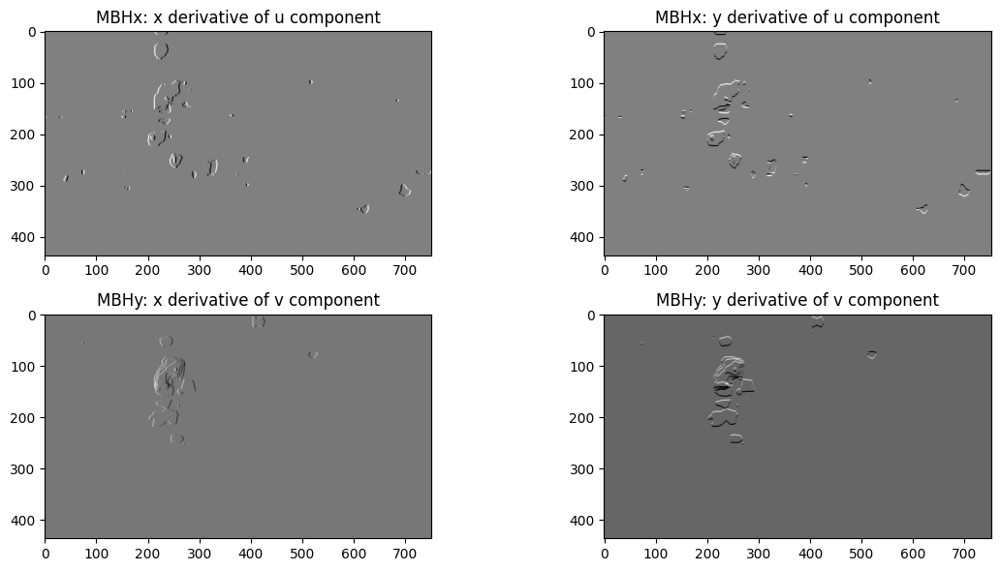

Corner shape: (1229, 1, 2)


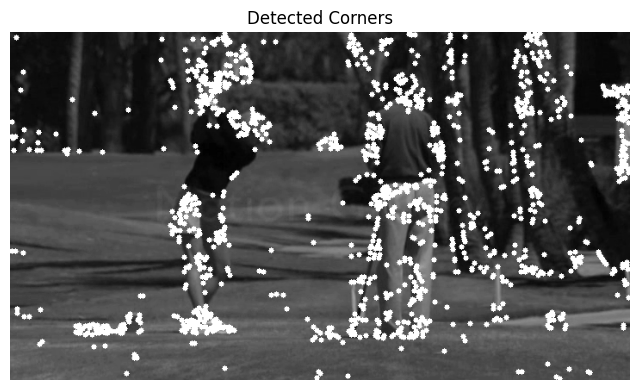

Length of Trajectory: 151
x: 505.0 y: 245.0
x: 270.0 y: 40.0
x: 150.0 y: 255.0
x: 600.0 y: 70.0
x: 630.0 y: 330.0
x: 25.0 y: 115.0
x: 204.0 y: 345.0
x: 455.0 y: 215.0
x: 219.0 y: 55.0
x: 500.0 y: 160.0
x: 525.0 y: 210.0
x: 321.0 y: 320.0
x: 520.0 y: 94.0
x: 225.0 y: 15.0
x: 520.0 y: 125.0
x: 249.0 y: 280.0
x: 251.0 y: 60.0
x: 385.0 y: 200.0
x: 526.0 y: 175.0
x: 271.0 y: 123.0
x: 515.0 y: 155.0
x: 520.0 y: 190.0
x: 515.0 y: 140.0
x: 281.0 y: 114.0
x: 244.0 y: 224.0
x: 250.0 y: 188.0
x: 280.0 y: 200.0
x: 700.0 y: 155.0
x: 535.0 y: 265.0
x: 515.0 y: 69.0
x: 295.0 y: 100.0
x: 250.0 y: 40.0
x: 235.0 y: 25.0
x: 545.0 y: 230.0
x: 200.0 y: 274.0
x: 555.0 y: 240.0
x: 95.0 y: 135.0
x: 445.0 y: 80.0
x: 570.0 y: 285.0
x: 265.0 y: 122.0
x: 241.0 y: 241.0
x: 585.0 y: 150.0
x: 425.0 y: 95.0
x: 520.0 y: 80.0
x: 234.0 y: 285.0
x: 555.0 y: 230.0
x: 209.0 y: 270.0
x: 645.0 y: 80.0
x: 80.0 y: 330.0
x: 395.0 y: 260.0
x: 565.0 y: 160.0
x: 212.0 y: 15.0
x: 670.0 y: 245.0
x: 585.0 y: 40.0
x: 450.0 y: 345.0
x:

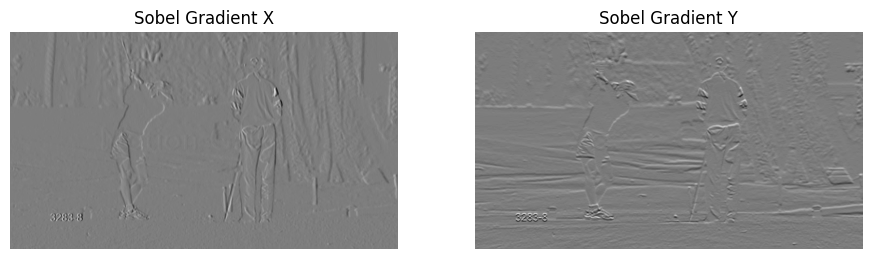

Flow dimension:  3
Flow shape: (404, 720, 2)
Padded Flow shape: (436, 752, 2)


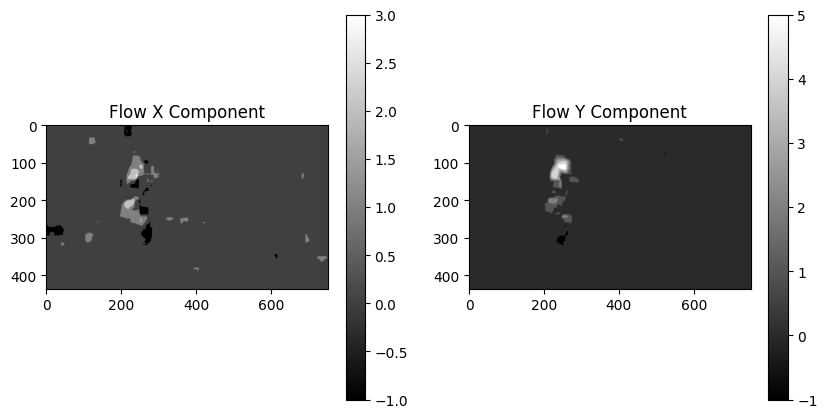

mbhx_padded shape: (436, 752, 2)
mbhy_padded shape: (436, 752, 2)


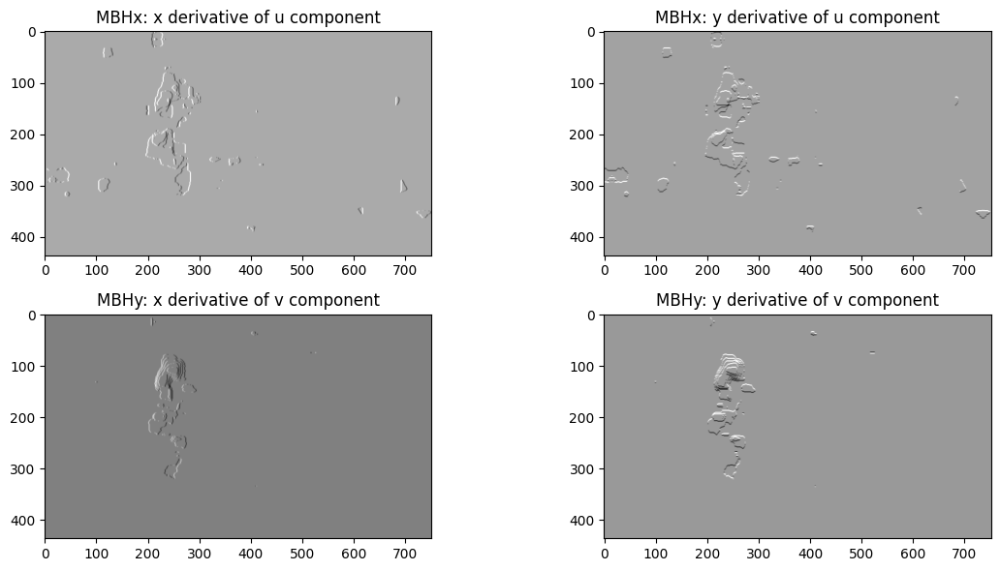

Corner shape: (1304, 1, 2)


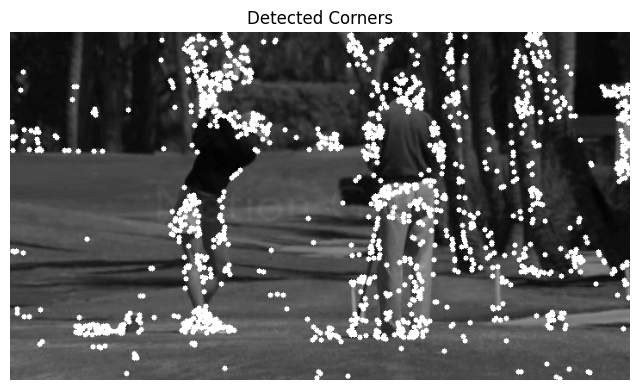

Length of Trajectory: 143
x: 270.0 y: 40.0
x: 600.0 y: 70.0
x: 25.0 y: 115.0
x: 455.0 y: 215.0
x: 500.0 y: 160.0
x: 321.0 y: 320.0
x: 225.0 y: 15.0
x: 249.0 y: 280.0
x: 251.0 y: 60.0
x: 526.0 y: 175.0
x: 515.0 y: 155.0
x: 515.0 y: 140.0
x: 244.0 y: 224.0
x: 280.0 y: 200.0
x: 535.0 y: 265.0
x: 295.0 y: 100.0
x: 250.0 y: 40.0
x: 235.0 y: 25.0
x: 545.0 y: 230.0
x: 200.0 y: 274.0
x: 555.0 y: 240.0
x: 95.0 y: 135.0
x: 445.0 y: 80.0
x: 570.0 y: 285.0
x: 265.0 y: 123.0
x: 242.0 y: 241.0
x: 585.0 y: 150.0
x: 425.0 y: 95.0
x: 520.0 y: 80.0
x: 234.0 y: 285.0
x: 555.0 y: 230.0
x: 209.0 y: 270.0
x: 645.0 y: 80.0
x: 80.0 y: 330.0
x: 395.0 y: 260.0
x: 565.0 y: 160.0
x: 213.0 y: 15.0
x: 670.0 y: 245.0
x: 585.0 y: 40.0
x: 450.0 y: 345.0
x: 225.0 y: 285.0
x: 243.0 y: 90.0
x: 223.0 y: 240.0
x: 510.0 y: 11.0
x: 205.0 y: 285.0
x: 610.0 y: 195.0
x: 455.0 y: 80.0
x: 239.0 y: 194.0
x: 230.0 y: 275.0
x: 510.0 y: 46.0
x: 425.0 y: 70.0
x: 243.0 y: 96.0
x: 635.0 y: 400.0
x: 600.0 y: 95.0
x: 275.0 y: 20.0
x: 232.

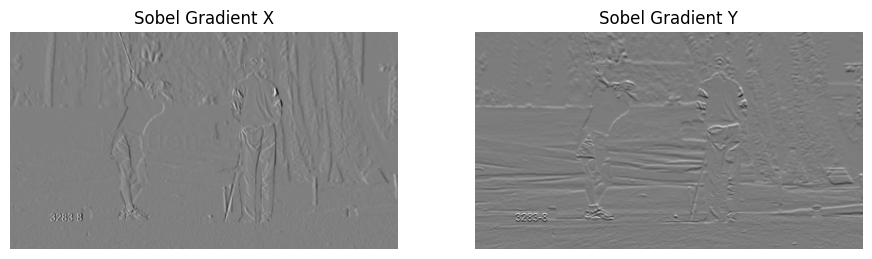

Flow dimension:  3
Flow shape: (404, 720, 2)
Padded Flow shape: (436, 752, 2)


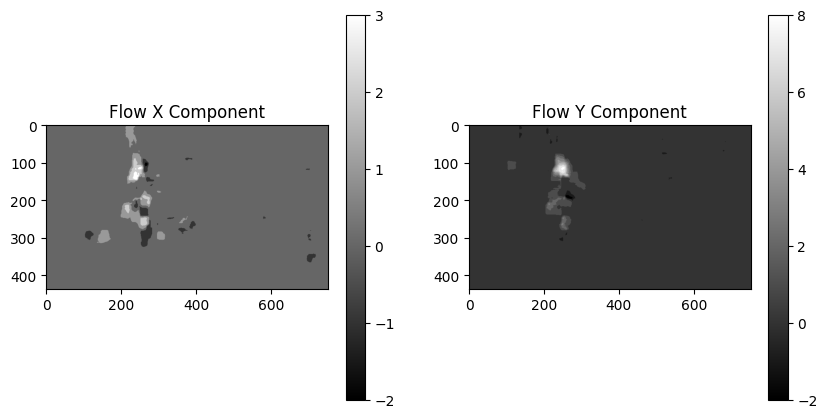

mbhx_padded shape: (436, 752, 2)
mbhy_padded shape: (436, 752, 2)


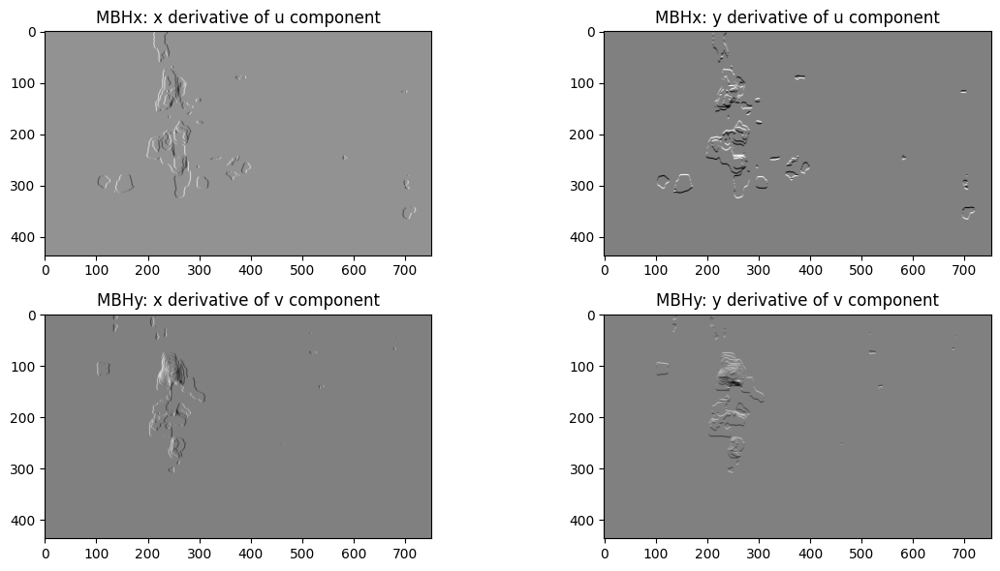

Corner shape: (1291, 1, 2)


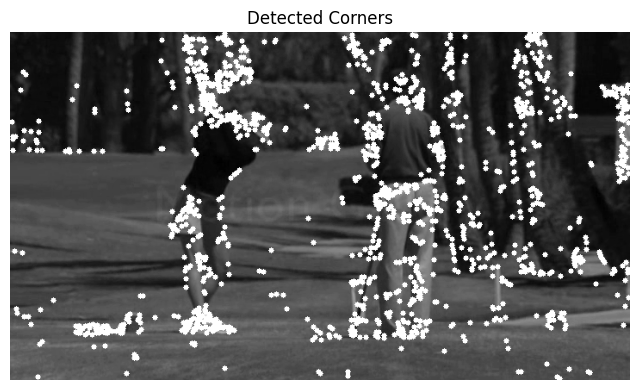

Length of Trajectory: 143
x: 600.0 y: 70.0
x: 455.0 y: 215.0
x: 321.0 y: 320.0
x: 249.0 y: 280.0
x: 526.0 y: 175.0
x: 515.0 y: 140.0
x: 280.0 y: 200.0
x: 295.0 y: 100.0
x: 235.0 y: 25.0
x: 200.0 y: 274.0
x: 95.0 y: 135.0
x: 570.0 y: 285.0
x: 265.0 y: 124.0
x: 243.0 y: 242.0
x: 585.0 y: 150.0
x: 425.0 y: 95.0
x: 520.0 y: 80.0
x: 234.0 y: 284.0
x: 555.0 y: 230.0
x: 209.0 y: 270.0
x: 645.0 y: 80.0
x: 80.0 y: 330.0
x: 395.0 y: 260.0
x: 565.0 y: 160.0
x: 213.0 y: 15.0
x: 670.0 y: 245.0
x: 585.0 y: 40.0
x: 450.0 y: 345.0
x: 225.0 y: 284.0
x: 244.0 y: 94.0
x: 224.0 y: 240.0
x: 510.0 y: 11.0
x: 205.0 y: 285.0
x: 610.0 y: 195.0
x: 455.0 y: 80.0
x: 239.0 y: 194.0
x: 230.0 y: 275.0
x: 510.0 y: 46.0
x: 425.0 y: 70.0
x: 244.0 y: 100.0
x: 635.0 y: 400.0
x: 600.0 y: 95.0
x: 275.0 y: 20.0
x: 233.0 y: 83.0
x: 260.0 y: 166.0
x: 260.0 y: 105.0
x: 240.0 y: 340.0
x: 243.0 y: 236.0
x: 209.0 y: 230.0
x: 575.0 y: 260.0
x: 380.0 y: 135.0
x: 250.0 y: 5.0
x: 198.0 y: 220.0
x: 600.0 y: 150.0
x: 470.0 y: 335.0
x: 

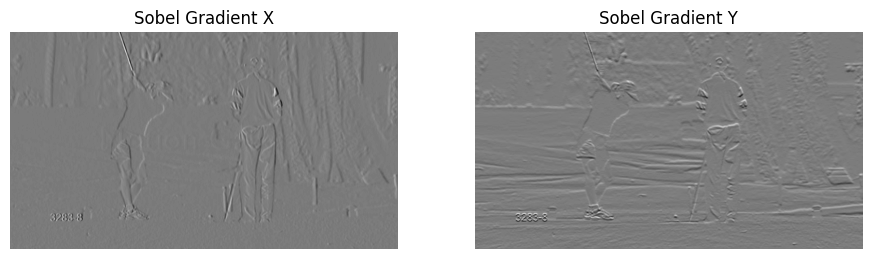

Flow dimension:  3
Flow shape: (404, 720, 2)
Padded Flow shape: (436, 752, 2)


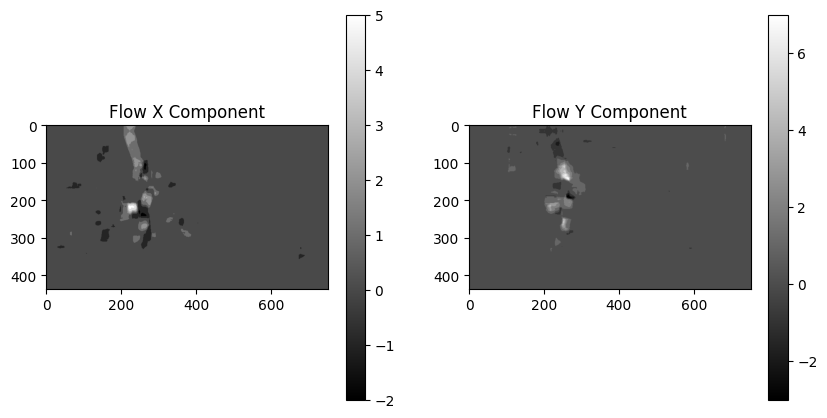

mbhx_padded shape: (436, 752, 2)
mbhy_padded shape: (436, 752, 2)


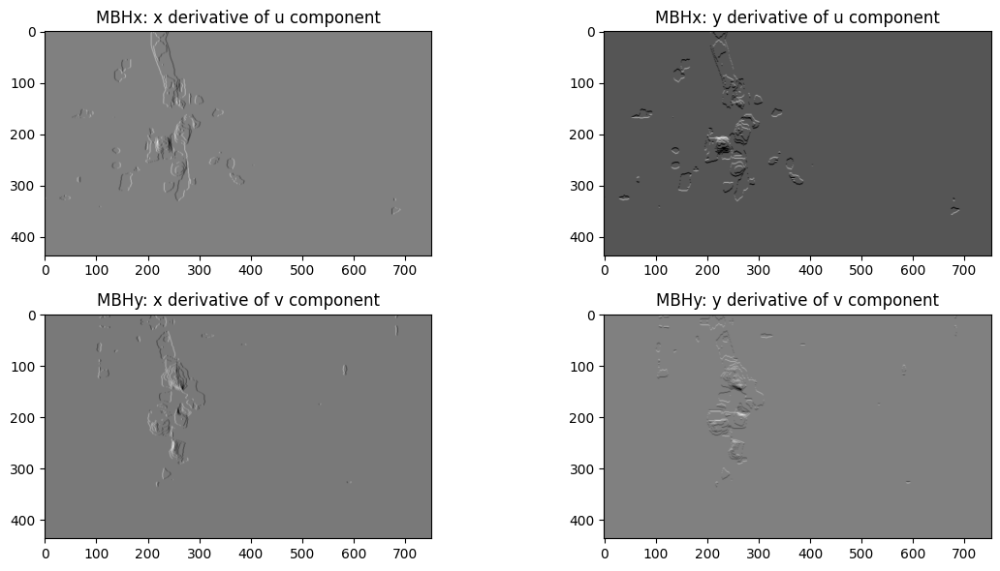

Corner shape: (1284, 1, 2)


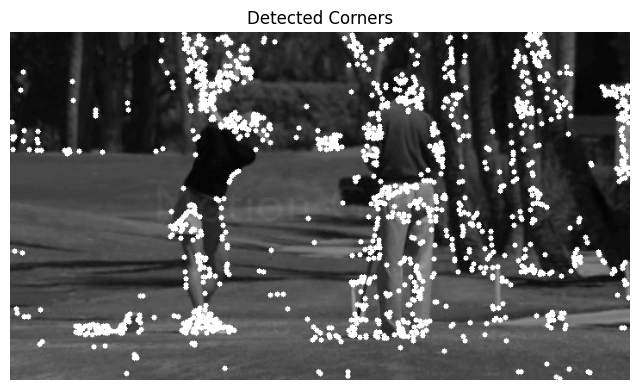

Length of Trajectory: 142
x: 455.0 y: 215.0
x: 249.0 y: 280.0
x: 515.0 y: 140.0
x: 295.0 y: 100.0
x: 200.0 y: 274.0
x: 570.0 y: 285.0
x: 243.0 y: 242.0
x: 425.0 y: 95.0
x: 234.0 y: 284.0
x: 555.0 y: 230.0
x: 209.0 y: 270.0
x: 645.0 y: 80.0
x: 80.0 y: 330.0
x: 395.0 y: 260.0
x: 565.0 y: 160.0
x: 214.0 y: 15.0
x: 670.0 y: 245.0
x: 585.0 y: 40.0
x: 450.0 y: 345.0
x: 225.0 y: 284.0
x: 244.0 y: 98.0
x: 225.0 y: 240.0
x: 510.0 y: 11.0
x: 205.0 y: 285.0
x: 610.0 y: 195.0
x: 455.0 y: 80.0
x: 240.0 y: 195.0
x: 230.0 y: 275.0
x: 510.0 y: 46.0
x: 425.0 y: 70.0
x: 244.0 y: 105.0
x: 635.0 y: 400.0
x: 600.0 y: 95.0
x: 275.0 y: 20.0
x: 234.0 y: 87.0
x: 260.0 y: 166.0
x: 260.0 y: 106.0
x: 240.0 y: 340.0
x: 245.0 y: 238.0
x: 210.0 y: 230.0
x: 575.0 y: 260.0
x: 380.0 y: 135.0
x: 250.0 y: 5.0
x: 199.0 y: 221.0
x: 600.0 y: 150.0
x: 470.0 y: 335.0
x: 710.0 y: 65.0
x: 220.0 y: 320.0
x: 445.0 y: 210.0
x: 219.0 y: 40.0
x: 420.0 y: 245.0
x: 710.0 y: 170.0
x: 715.0 y: 145.0
x: 251.0 y: 242.0
x: 450.0 y: 70.0
x:

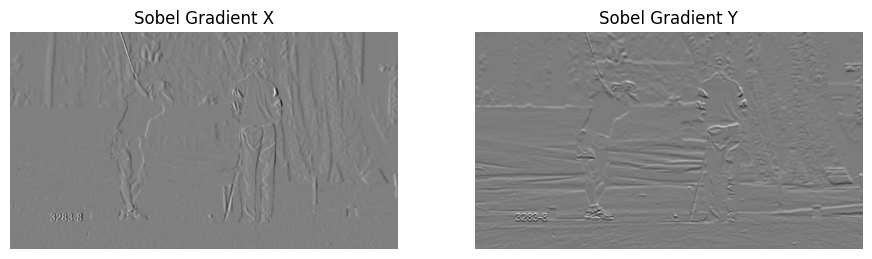

Flow dimension:  3
Flow shape: (404, 720, 2)
Padded Flow shape: (436, 752, 2)


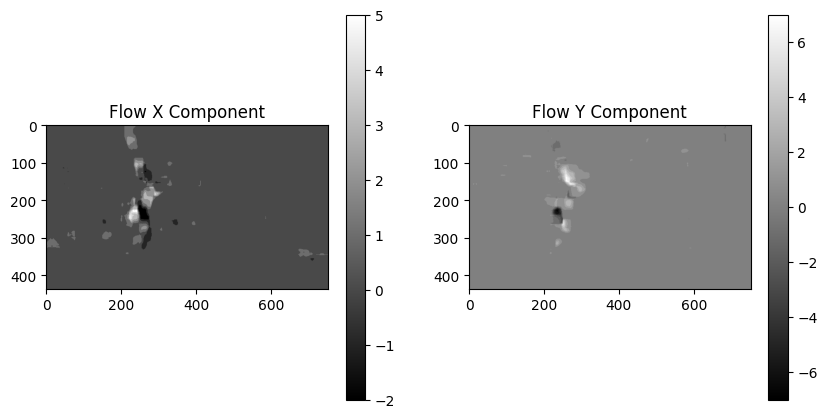

mbhx_padded shape: (436, 752, 2)
mbhy_padded shape: (436, 752, 2)


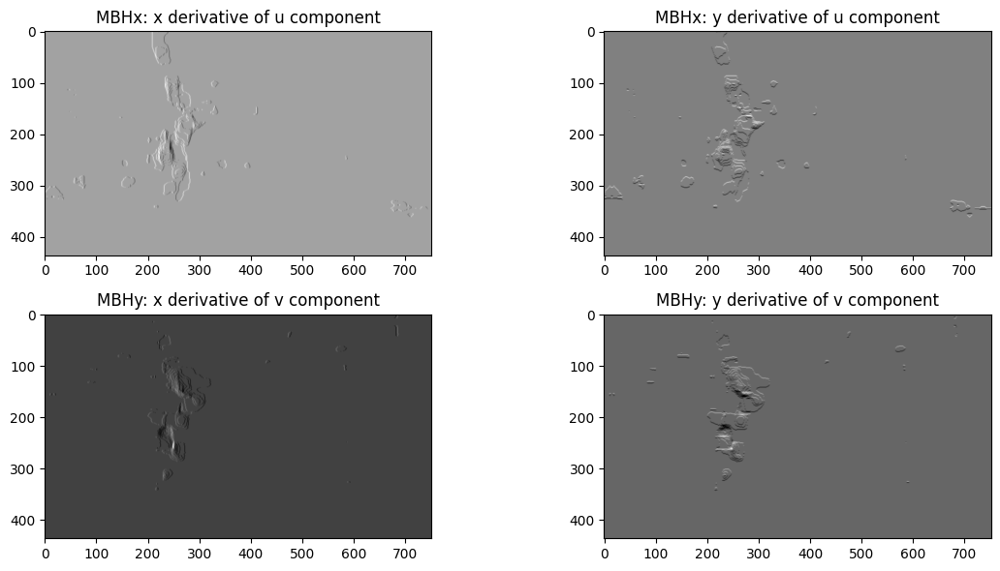

Corner shape: (1334, 1, 2)


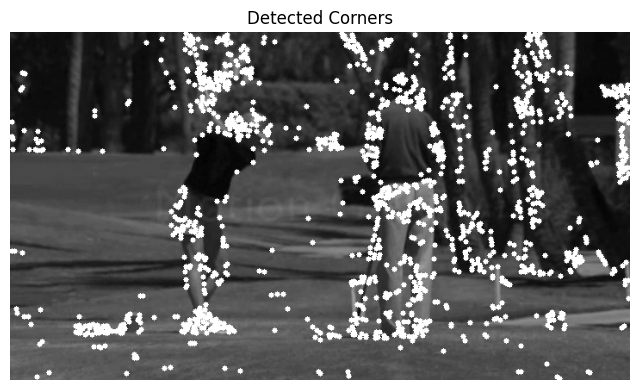

Length of Trajectory: 147
x: 249.0 y: 280.0
x: 295.0 y: 100.0
x: 570.0 y: 285.0
x: 425.0 y: 95.0
x: 235.0 y: 284.0
x: 209.0 y: 270.0
x: 80.0 y: 330.0
x: 565.0 y: 160.0
x: 670.0 y: 245.0
x: 450.0 y: 345.0
x: 226.0 y: 284.0
x: 243.0 y: 100.0
x: 225.0 y: 240.0
x: 510.0 y: 11.0
x: 205.0 y: 285.0
x: 610.0 y: 195.0
x: 455.0 y: 80.0
x: 240.0 y: 197.0
x: 230.0 y: 275.0
x: 510.0 y: 46.0
x: 425.0 y: 70.0
x: 243.0 y: 108.0
x: 635.0 y: 400.0
x: 600.0 y: 95.0
x: 275.0 y: 20.0
x: 236.0 y: 89.0
x: 261.0 y: 166.0
x: 260.0 y: 107.0
x: 240.0 y: 340.0
x: 246.0 y: 240.0
x: 210.0 y: 230.0
x: 575.0 y: 260.0
x: 380.0 y: 135.0
x: 250.0 y: 5.0
x: 200.0 y: 221.0
x: 600.0 y: 150.0
x: 470.0 y: 335.0
x: 710.0 y: 65.0
x: 220.0 y: 320.0
x: 445.0 y: 210.0
x: 220.0 y: 39.0
x: 420.0 y: 245.0
x: 710.0 y: 170.0
x: 715.0 y: 145.0
x: 252.0 y: 243.0
x: 450.0 y: 70.0
x: 270.0 y: 30.0
x: 80.0 y: 340.0
x: 135.0 y: 330.0
x: 460.0 y: 180.0
x: 360.0 y: 135.0
x: 475.0 y: 85.0
x: 715.0 y: 290.0
x: 705.0 y: 305.0
x: 600.0 y: 15.0
x:

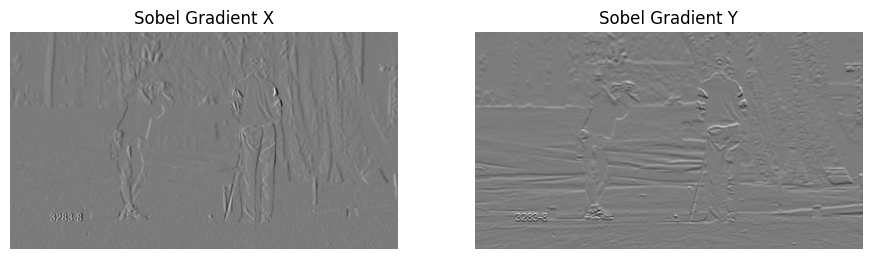

Flow dimension:  3
Flow shape: (404, 720, 2)
Padded Flow shape: (436, 752, 2)


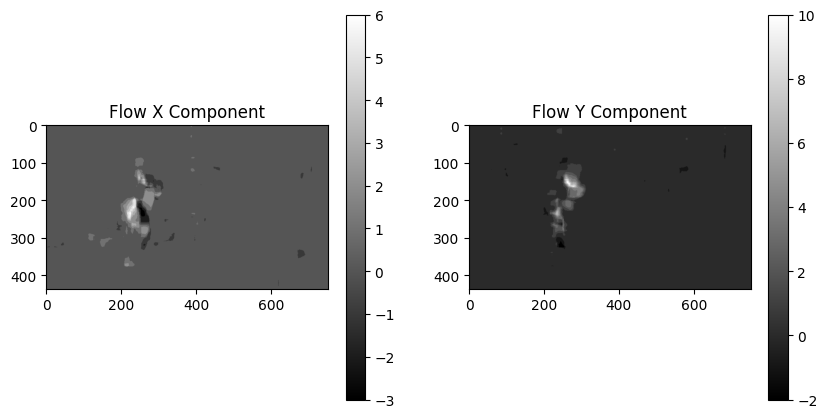

mbhx_padded shape: (436, 752, 2)
mbhy_padded shape: (436, 752, 2)


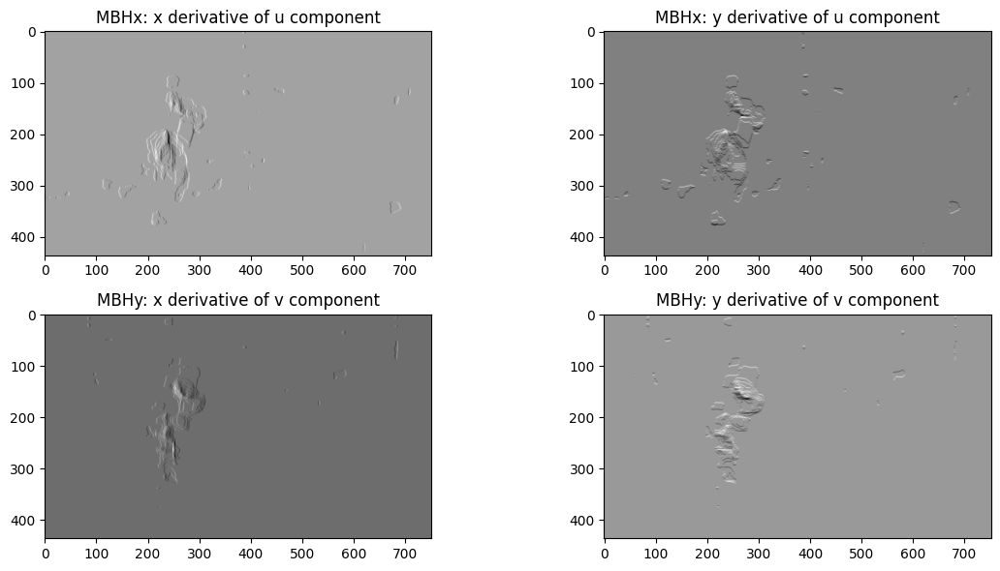

Corner shape: (1484, 1, 2)


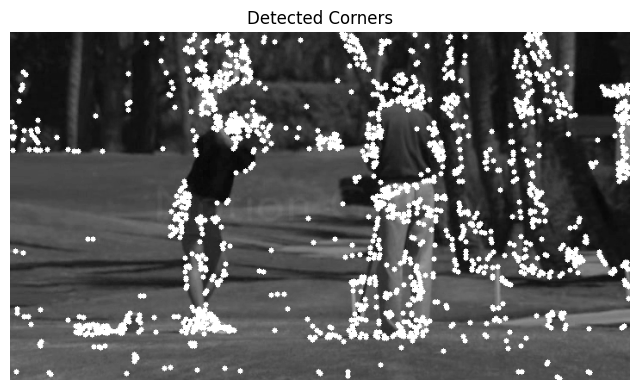

Length of Trajectory: 151
x: 295.0 y: 100.0
x: 570.0 y: 285.0
x: 235.0 y: 284.0
x: 80.0 y: 330.0
x: 670.0 y: 245.0
x: 450.0 y: 345.0
x: 243.0 y: 100.0
x: 510.0 y: 11.0
x: 610.0 y: 195.0
x: 455.0 y: 80.0
x: 240.0 y: 199.0
x: 230.0 y: 275.0
x: 510.0 y: 46.0
x: 425.0 y: 70.0
x: 243.0 y: 113.0
x: 635.0 y: 400.0
x: 600.0 y: 95.0
x: 275.0 y: 20.0
x: 238.0 y: 90.0
x: 263.0 y: 167.0
x: 259.0 y: 109.0
x: 240.0 y: 340.0
x: 246.0 y: 241.0
x: 214.0 y: 229.0
x: 575.0 y: 260.0
x: 380.0 y: 135.0
x: 250.0 y: 5.0
x: 201.0 y: 221.0
x: 600.0 y: 150.0
x: 470.0 y: 335.0
x: 710.0 y: 65.0
x: 220.0 y: 320.0
x: 445.0 y: 210.0
x: 221.0 y: 38.0
x: 420.0 y: 245.0
x: 710.0 y: 170.0
x: 715.0 y: 145.0
x: 252.0 y: 244.0
x: 450.0 y: 70.0
x: 270.0 y: 30.0
x: 80.0 y: 340.0
x: 135.0 y: 330.0
x: 460.0 y: 180.0
x: 360.0 y: 135.0
x: 475.0 y: 85.0
x: 715.0 y: 290.0
x: 705.0 y: 305.0
x: 600.0 y: 15.0
x: 495.0 y: 190.0
x: 415.0 y: 40.0
x: 590.0 y: 205.0
x: 480.0 y: 200.0
x: 570.0 y: 180.0
x: 210.0 y: 335.0
x: 253.0 y: 99.0
x: 

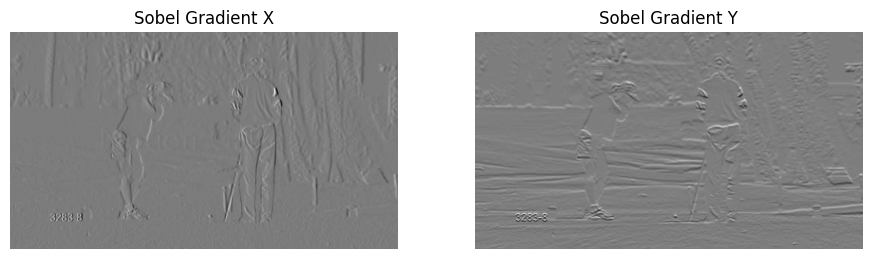

Flow dimension:  3
Flow shape: (404, 720, 2)
Padded Flow shape: (436, 752, 2)


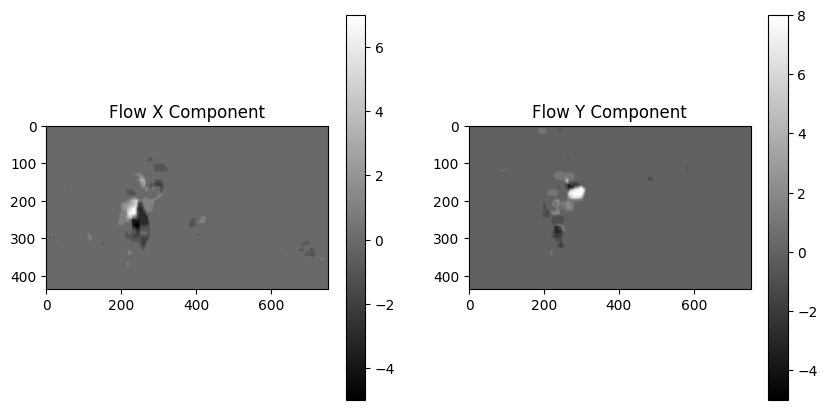

mbhx_padded shape: (436, 752, 2)
mbhy_padded shape: (436, 752, 2)


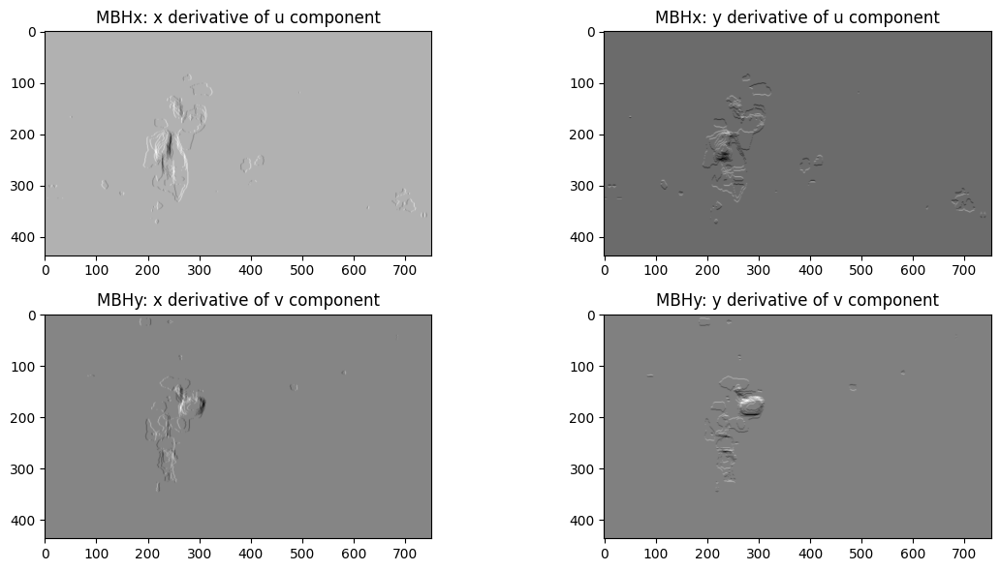

Corner shape: (1468, 1, 2)


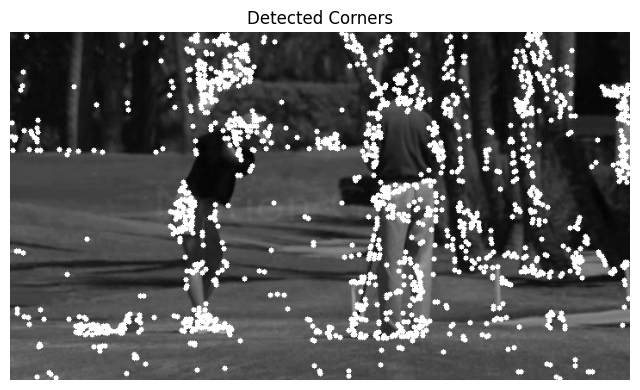

Length of Trajectory: 160
x: 295.0 y: 100.0
x: 235.0 y: 284.0
x: 670.0 y: 245.0
x: 243.0 y: 100.0
x: 610.0 y: 195.0
x: 240.0 y: 199.0
x: 510.0 y: 46.0
x: 243.0 y: 113.0
x: 635.0 y: 400.0
x: 600.0 y: 95.0
x: 275.0 y: 20.0
x: 239.0 y: 90.0
x: 265.0 y: 170.0
x: 259.0 y: 110.0
x: 240.0 y: 340.0
x: 244.0 y: 241.0
x: 216.0 y: 231.0
x: 575.0 y: 260.0
x: 380.0 y: 135.0
x: 250.0 y: 5.0
x: 205.0 y: 222.0
x: 600.0 y: 150.0
x: 470.0 y: 335.0
x: 710.0 y: 65.0
x: 220.0 y: 320.0
x: 445.0 y: 210.0
x: 221.0 y: 38.0
x: 420.0 y: 245.0
x: 710.0 y: 170.0
x: 715.0 y: 145.0
x: 251.0 y: 244.0
x: 450.0 y: 70.0
x: 270.0 y: 30.0
x: 80.0 y: 340.0
x: 135.0 y: 330.0
x: 460.0 y: 180.0
x: 360.0 y: 135.0
x: 475.0 y: 85.0
x: 715.0 y: 290.0
x: 705.0 y: 305.0
x: 600.0 y: 15.0
x: 495.0 y: 190.0
x: 415.0 y: 40.0
x: 590.0 y: 205.0
x: 480.0 y: 200.0
x: 570.0 y: 180.0
x: 210.0 y: 335.0
x: 253.0 y: 100.0
x: 219.0 y: 201.0
x: 220.0 y: 330.0
x: 440.0 y: 330.0
x: 625.0 y: 340.0
x: 495.0 y: 205.0
x: 250.0 y: 233.0
x: 228.0 y: 61.0

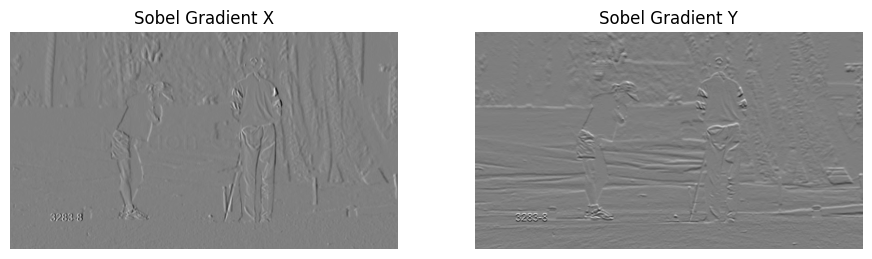

Flow dimension:  3
Flow shape: (404, 720, 2)
Padded Flow shape: (436, 752, 2)


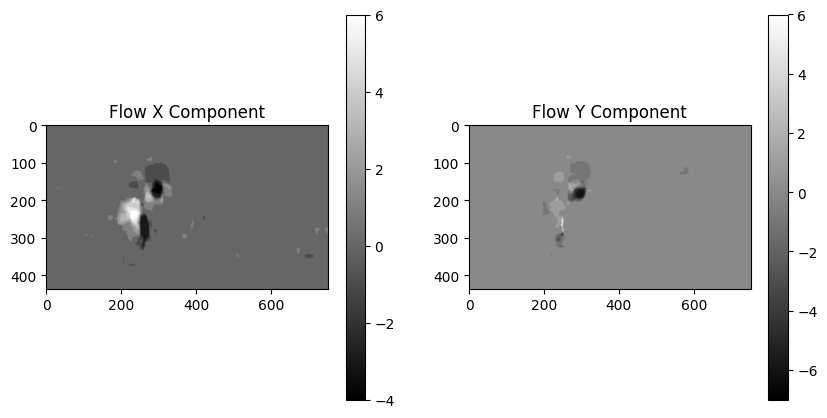

mbhx_padded shape: (436, 752, 2)
mbhy_padded shape: (436, 752, 2)


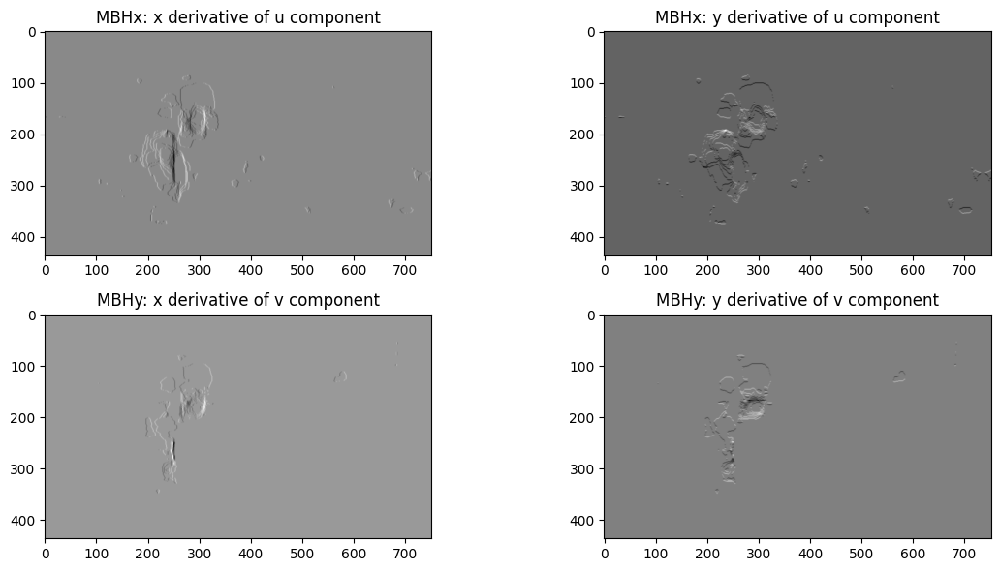

Corner shape: (1594, 1, 2)


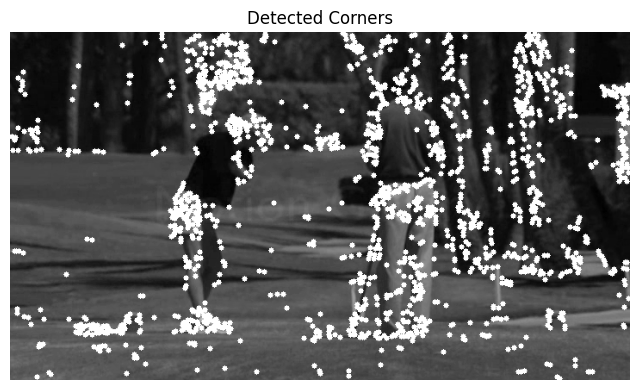

Length of Trajectory: 172
x: 235.0 y: 284.0
x: 243.0 y: 100.0
x: 240.0 y: 199.0
x: 243.0 y: 113.0
x: 600.0 y: 95.0
x: 239.0 y: 90.0
x: 259.0 y: 110.0
x: 240.0 y: 340.0
x: 241.0 y: 241.0
x: 216.0 y: 230.0
x: 575.0 y: 260.0
x: 380.0 y: 135.0
x: 250.0 y: 5.0
x: 210.0 y: 222.0
x: 600.0 y: 150.0
x: 470.0 y: 335.0
x: 710.0 y: 65.0
x: 220.0 y: 320.0
x: 445.0 y: 210.0
x: 221.0 y: 38.0
x: 420.0 y: 245.0
x: 710.0 y: 170.0
x: 715.0 y: 145.0
x: 248.0 y: 244.0
x: 450.0 y: 70.0
x: 270.0 y: 30.0
x: 80.0 y: 340.0
x: 135.0 y: 330.0
x: 460.0 y: 180.0
x: 360.0 y: 135.0
x: 475.0 y: 85.0
x: 715.0 y: 290.0
x: 705.0 y: 305.0
x: 600.0 y: 15.0
x: 495.0 y: 190.0
x: 415.0 y: 40.0
x: 590.0 y: 205.0
x: 480.0 y: 200.0
x: 570.0 y: 180.0
x: 210.0 y: 335.0
x: 253.0 y: 100.0
x: 225.0 y: 202.0
x: 220.0 y: 330.0
x: 440.0 y: 330.0
x: 625.0 y: 340.0
x: 495.0 y: 205.0
x: 247.0 y: 233.0
x: 228.0 y: 61.0
x: 470.0 y: 180.0
x: 600.0 y: 5.0
x: 465.0 y: 285.0
x: 213.0 y: 32.0
x: 221.0 y: 207.0
x: 4.0 y: 255.0
x: 365.0 y: 125.0
x:

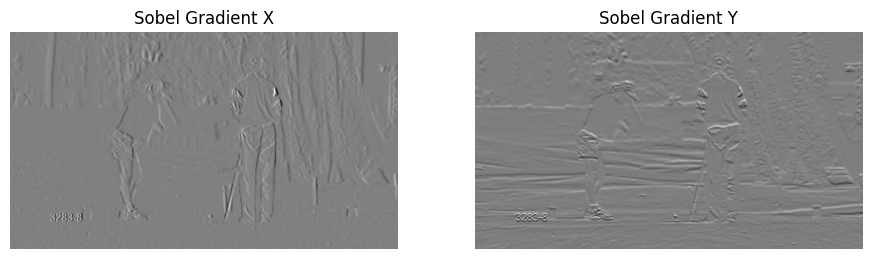

Flow dimension:  3
Flow shape: (404, 720, 2)
Padded Flow shape: (436, 752, 2)


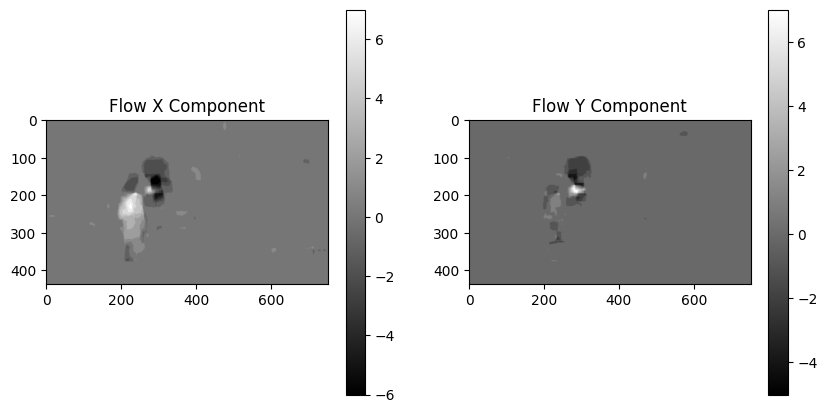

mbhx_padded shape: (436, 752, 2)
mbhy_padded shape: (436, 752, 2)


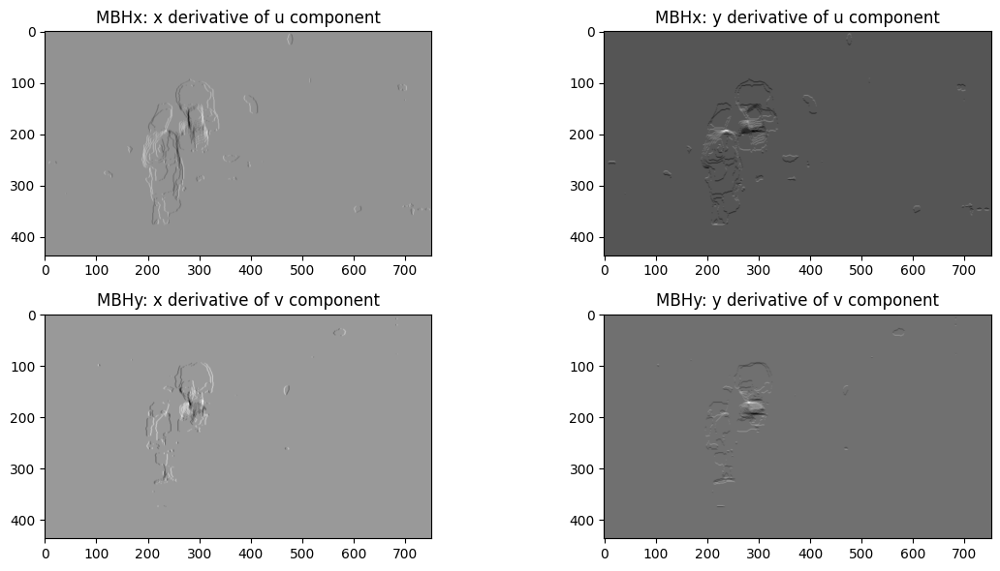

Corner shape: (1553, 1, 2)


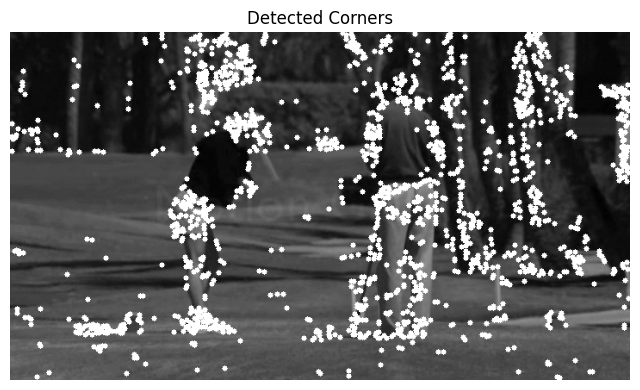

Length of Trajectory: 184
x: 243.0 y: 100.0
x: 243.0 y: 113.0
x: 239.0 y: 90.0
x: 258.0 y: 109.0
x: 241.0 y: 241.0
x: 575.0 y: 260.0
x: 250.0 y: 5.0
x: 600.0 y: 150.0
x: 470.0 y: 335.0
x: 710.0 y: 65.0
x: 220.0 y: 320.0
x: 445.0 y: 210.0
x: 221.0 y: 38.0
x: 420.0 y: 245.0
x: 710.0 y: 170.0
x: 715.0 y: 145.0
x: 245.0 y: 244.0
x: 450.0 y: 70.0
x: 270.0 y: 30.0
x: 80.0 y: 340.0
x: 135.0 y: 330.0
x: 460.0 y: 180.0
x: 360.0 y: 135.0
x: 475.0 y: 85.0
x: 715.0 y: 290.0
x: 705.0 y: 305.0
x: 600.0 y: 15.0
x: 495.0 y: 190.0
x: 415.0 y: 40.0
x: 590.0 y: 205.0
x: 480.0 y: 200.0
x: 570.0 y: 180.0
x: 210.0 y: 335.0
x: 252.0 y: 100.0
x: 229.0 y: 203.0
x: 220.0 y: 330.0
x: 440.0 y: 330.0
x: 625.0 y: 340.0
x: 495.0 y: 205.0
x: 244.0 y: 233.0
x: 228.0 y: 61.0
x: 470.0 y: 180.0
x: 600.0 y: 5.0
x: 465.0 y: 285.0
x: 213.0 y: 32.0
x: 226.0 y: 208.0
x: 4.0 y: 255.0
x: 365.0 y: 125.0
x: 435.0 y: 185.0
x: 705.0 y: 100.0
x: 710.0 y: 120.0
x: 224.0 y: 297.0
x: 245.0 y: 126.0
x: 370.0 y: 205.0
x: 500.0 y: 140.0
x

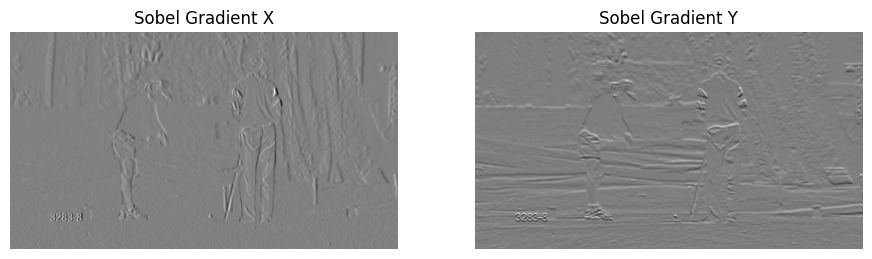

Flow dimension:  3
Flow shape: (404, 720, 2)
Padded Flow shape: (436, 752, 2)


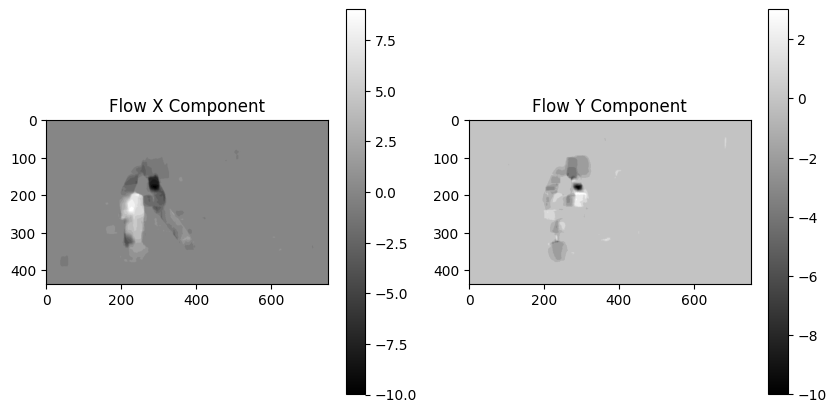

mbhx_padded shape: (436, 752, 2)
mbhy_padded shape: (436, 752, 2)


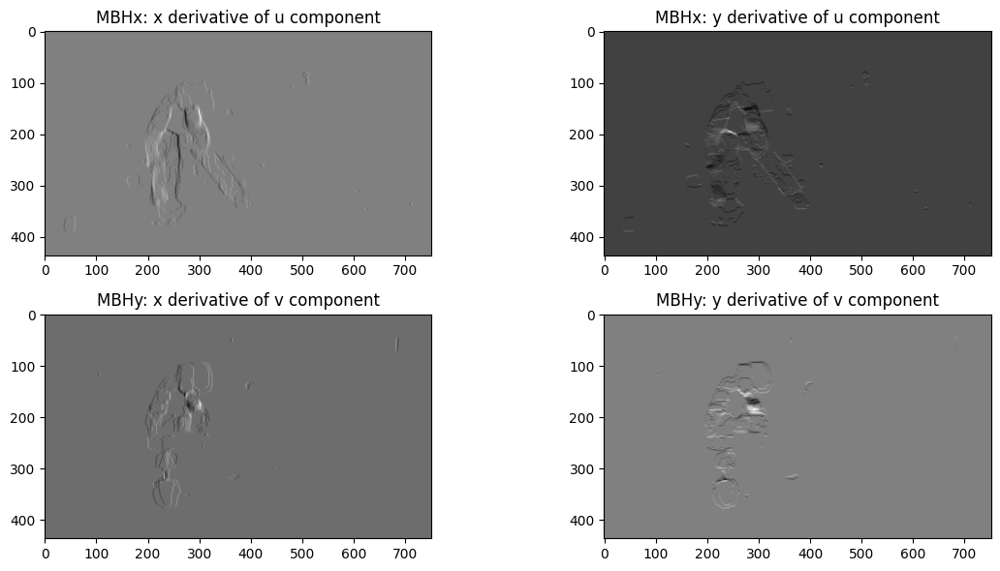

Corner shape: (1639, 1, 2)


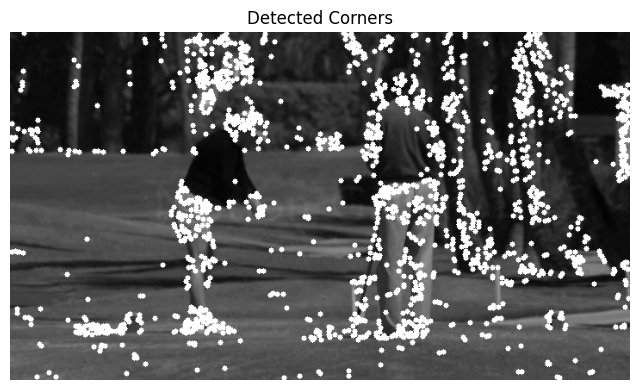

Length of Trajectory: 184
x: 243.0 y: 113.0
x: 258.0 y: 109.0
x: 575.0 y: 260.0
x: 600.0 y: 150.0
x: 710.0 y: 65.0
x: 445.0 y: 210.0
x: 420.0 y: 245.0
x: 715.0 y: 145.0
x: 450.0 y: 70.0
x: 80.0 y: 340.0
x: 135.0 y: 330.0
x: 460.0 y: 180.0
x: 360.0 y: 135.0
x: 475.0 y: 85.0
x: 715.0 y: 290.0
x: 705.0 y: 305.0
x: 600.0 y: 15.0
x: 495.0 y: 190.0
x: 415.0 y: 40.0
x: 590.0 y: 205.0
x: 480.0 y: 200.0
x: 570.0 y: 180.0
x: 210.0 y: 335.0
x: 250.0 y: 98.0
x: 233.0 y: 203.0
x: 221.0 y: 330.0
x: 440.0 y: 330.0
x: 625.0 y: 340.0
x: 495.0 y: 205.0
x: 246.0 y: 233.0
x: 228.0 y: 61.0
x: 470.0 y: 180.0
x: 600.0 y: 5.0
x: 465.0 y: 285.0
x: 213.0 y: 32.0
x: 230.0 y: 209.0
x: 4.0 y: 255.0
x: 365.0 y: 125.0
x: 435.0 y: 185.0
x: 705.0 y: 100.0
x: 710.0 y: 120.0
x: 225.0 y: 295.0
x: 244.0 y: 124.0
x: 370.0 y: 205.0
x: 500.0 y: 140.0
x: 700.0 y: 280.0
x: 242.0 y: 117.0
x: 435.0 y: 200.0
x: 715.0 y: 85.0
x: 560.0 y: 285.0
x: 715.0 y: 155.0
x: 660.0 y: 265.0
x: 660.0 y: 220.0
x: 605.0 y: 270.0
x: 210.0 y: 85.0

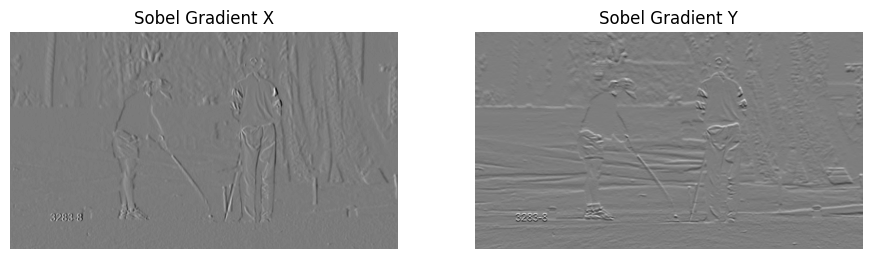

Flow dimension:  3
Flow shape: (404, 720, 2)
Padded Flow shape: (436, 752, 2)


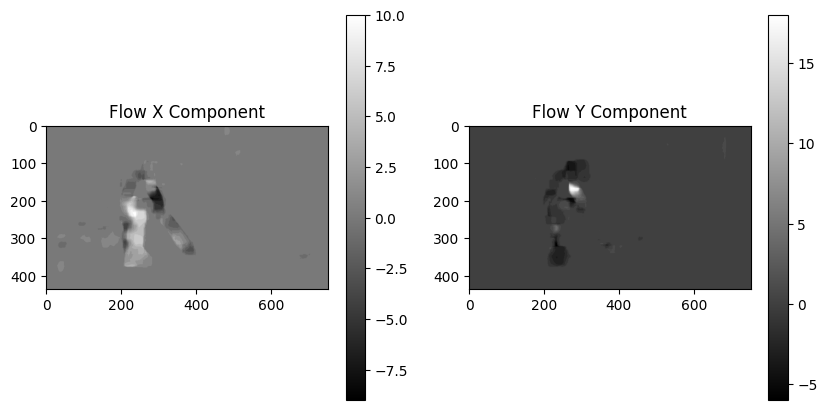

mbhx_padded shape: (436, 752, 2)
mbhy_padded shape: (436, 752, 2)


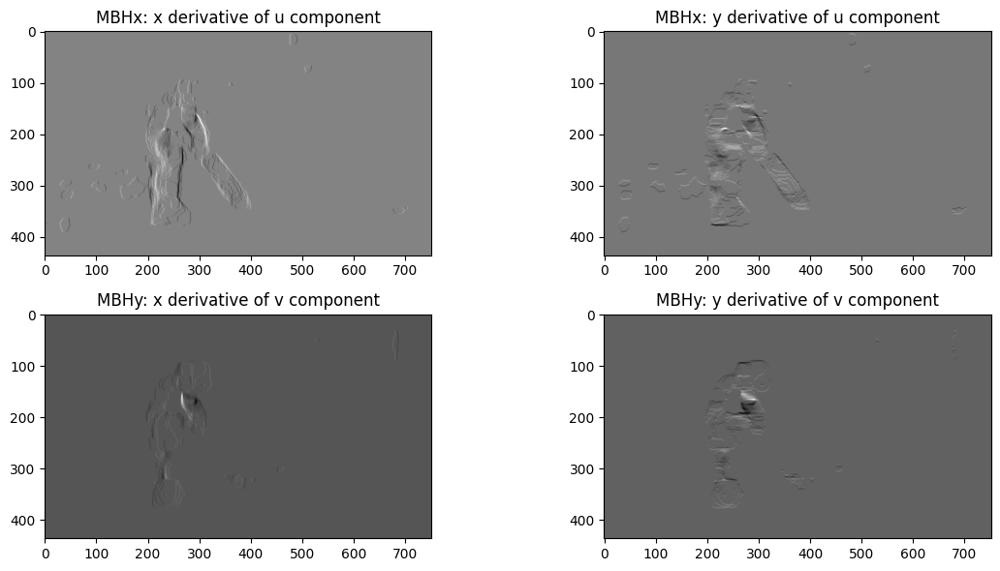

Corner shape: (1529, 1, 2)


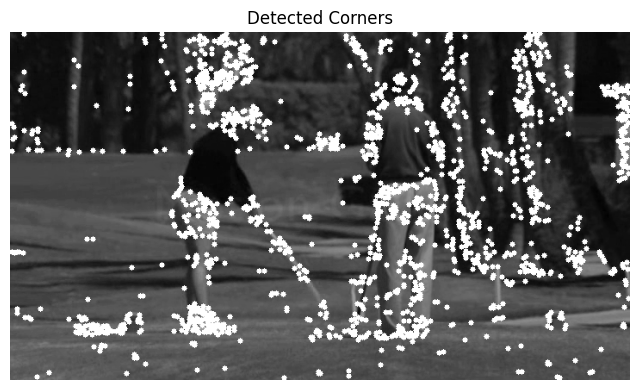

Length of Trajectory: 192
x: 240.0 y: 111.0
x: 575.0 y: 260.0
x: 710.0 y: 65.0
x: 420.0 y: 245.0
x: 450.0 y: 70.0
x: 80.0 y: 340.0
x: 460.0 y: 180.0
x: 475.0 y: 85.0
x: 705.0 y: 305.0
x: 495.0 y: 190.0
x: 590.0 y: 205.0
x: 570.0 y: 180.0
x: 211.0 y: 333.0
x: 248.0 y: 95.0
x: 239.0 y: 203.0
x: 223.0 y: 328.0
x: 440.0 y: 330.0
x: 625.0 y: 340.0
x: 495.0 y: 205.0
x: 248.0 y: 233.0
x: 228.0 y: 61.0
x: 470.0 y: 180.0
x: 600.0 y: 5.0
x: 465.0 y: 285.0
x: 213.0 y: 32.0
x: 236.0 y: 209.0
x: 4.0 y: 255.0
x: 365.0 y: 125.0
x: 435.0 y: 185.0
x: 705.0 y: 100.0
x: 710.0 y: 120.0
x: 229.0 y: 295.0
x: 241.0 y: 121.0
x: 370.0 y: 205.0
x: 500.0 y: 140.0
x: 700.0 y: 280.0
x: 239.0 y: 115.0
x: 435.0 y: 200.0
x: 715.0 y: 85.0
x: 560.0 y: 285.0
x: 715.0 y: 155.0
x: 660.0 y: 265.0
x: 660.0 y: 220.0
x: 605.0 y: 270.0
x: 210.0 y: 85.0
x: 510.0 y: 34.0
x: 475.0 y: 285.0
x: 236.0 y: 59.0
x: 277.0 y: 102.0
x: 635.0 y: 80.0
x: 226.0 y: 269.0
x: 175.0 y: 135.0
x: 425.0 y: 120.0
x: 645.0 y: 340.0
x: 590.0 y: 90.0
x

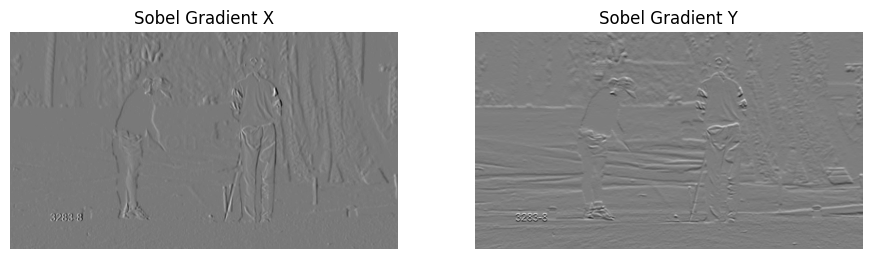

Flow dimension:  3
Flow shape: (404, 720, 2)
Padded Flow shape: (436, 752, 2)


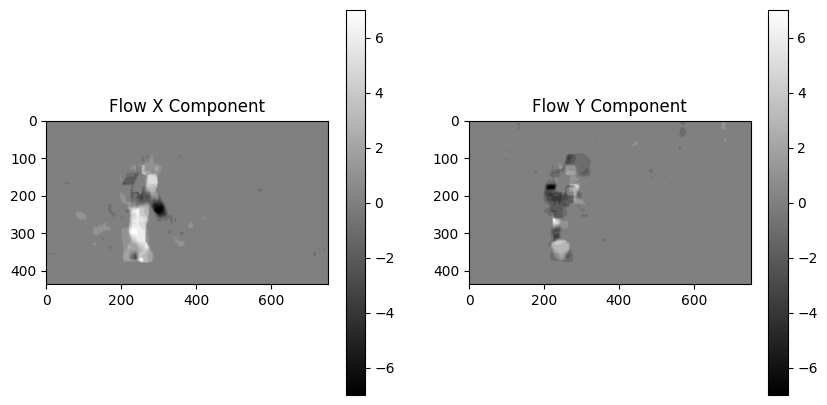

mbhx_padded shape: (436, 752, 2)
mbhy_padded shape: (436, 752, 2)


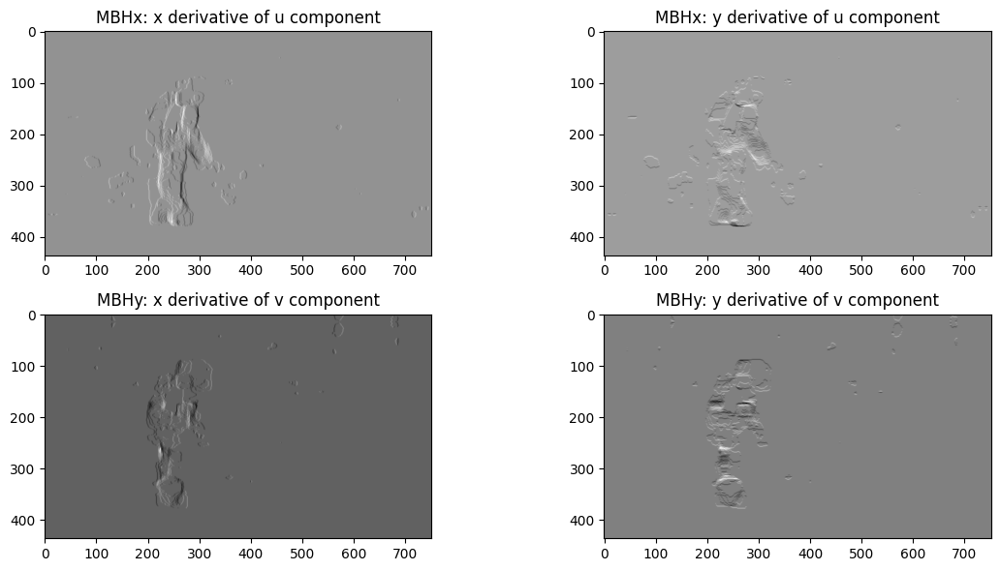

Corner shape: (1507, 1, 2)


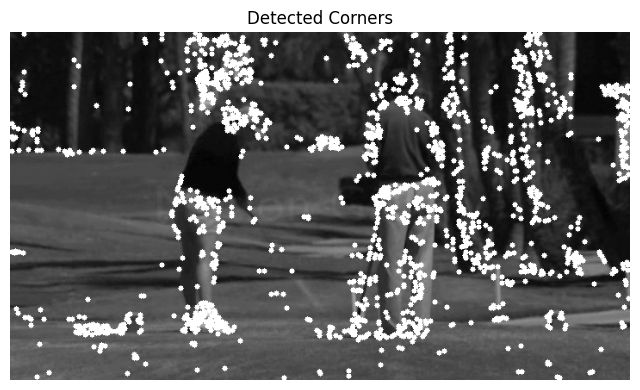

Length of Trajectory: 191
x: 575.0 y: 260.0
x: 420.0 y: 245.0
x: 80.0 y: 340.0
x: 475.0 y: 85.0
x: 495.0 y: 190.0
x: 570.0 y: 180.0
x: 248.0 y: 95.0
x: 223.0 y: 328.0
x: 625.0 y: 340.0
x: 248.0 y: 233.0
x: 470.0 y: 180.0
x: 465.0 y: 285.0
x: 236.0 y: 209.0
x: 4.0 y: 255.0
x: 365.0 y: 125.0
x: 435.0 y: 185.0
x: 705.0 y: 100.0
x: 710.0 y: 120.0
x: 235.0 y: 295.0
x: 238.0 y: 119.0
x: 370.0 y: 205.0
x: 500.0 y: 140.0
x: 700.0 y: 280.0
x: 237.0 y: 112.0
x: 435.0 y: 200.0
x: 715.0 y: 85.0
x: 560.0 y: 285.0
x: 715.0 y: 155.0
x: 660.0 y: 265.0
x: 660.0 y: 220.0
x: 605.0 y: 270.0
x: 210.0 y: 85.0
x: 510.0 y: 34.0
x: 475.0 y: 285.0
x: 236.0 y: 59.0
x: 277.0 y: 100.0
x: 635.0 y: 80.0
x: 231.0 y: 269.0
x: 175.0 y: 135.0
x: 425.0 y: 120.0
x: 645.0 y: 340.0
x: 590.0 y: 90.0
x: 520.0 y: 110.0
x: 465.0 y: 350.0
x: 605.0 y: 185.0
x: 233.0 y: 90.0
x: 245.0 y: 50.0
x: 410.0 y: 30.0
x: 195.0 y: 331.0
x: 226.0 y: 49.0
x: 220.0 y: 24.0
x: 420.0 y: 255.0
x: 219.0 y: 340.0
x: 207.0 y: 342.0
x: 222.0 y: 60.0
x

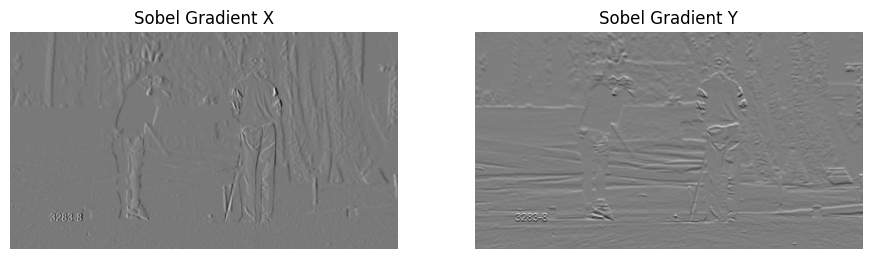

Flow dimension:  3
Flow shape: (404, 720, 2)
Padded Flow shape: (436, 752, 2)


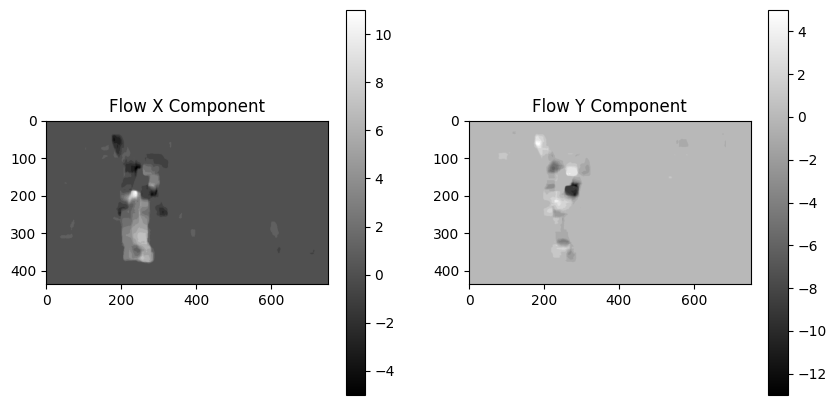

mbhx_padded shape: (436, 752, 2)
mbhy_padded shape: (436, 752, 2)


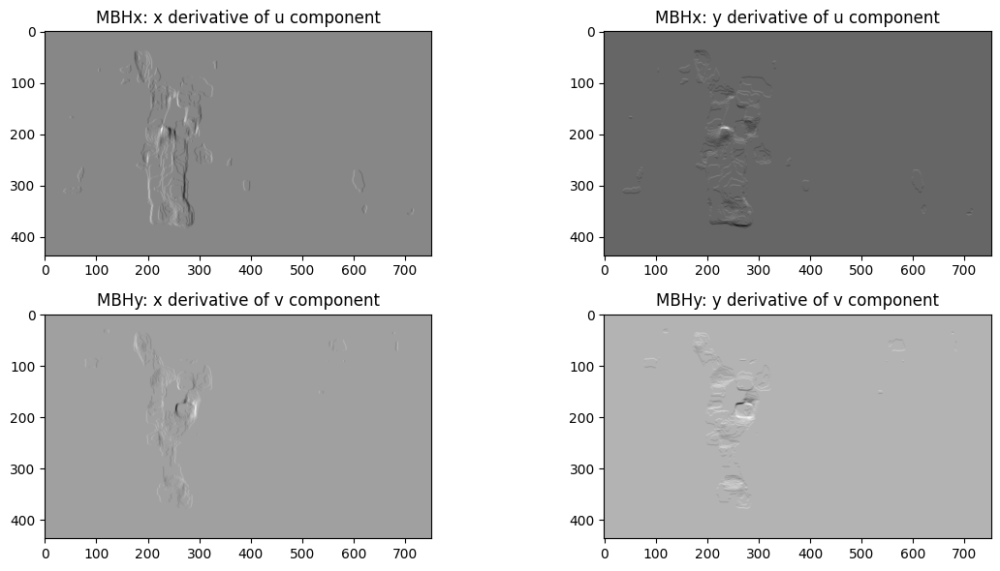

Corner shape: (1245, 1, 2)


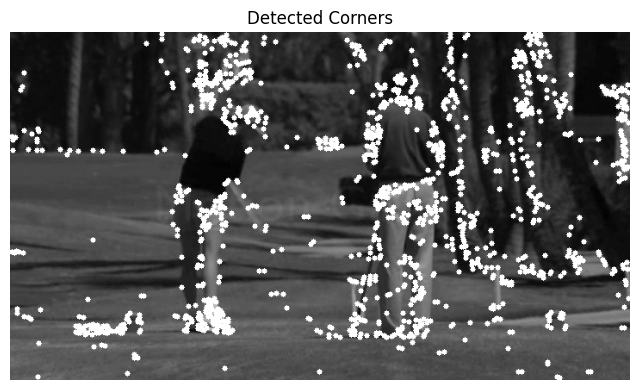

Length of Trajectory: 192
x: 420.0 y: 245.0
x: 475.0 y: 85.0
x: 570.0 y: 180.0
x: 223.0 y: 328.0
x: 248.0 y: 233.0
x: 465.0 y: 285.0
x: 236.0 y: 206.0
x: 365.0 y: 125.0
x: 705.0 y: 100.0
x: 235.0 y: 295.0
x: 370.0 y: 205.0
x: 500.0 y: 140.0
x: 700.0 y: 280.0
x: 237.0 y: 110.0
x: 435.0 y: 200.0
x: 715.0 y: 85.0
x: 560.0 y: 285.0
x: 715.0 y: 155.0
x: 660.0 y: 265.0
x: 660.0 y: 220.0
x: 605.0 y: 270.0
x: 210.0 y: 85.0
x: 510.0 y: 34.0
x: 475.0 y: 285.0
x: 236.0 y: 59.0
x: 277.0 y: 99.0
x: 635.0 y: 80.0
x: 237.0 y: 269.0
x: 175.0 y: 135.0
x: 425.0 y: 120.0
x: 645.0 y: 340.0
x: 590.0 y: 90.0
x: 520.0 y: 110.0
x: 465.0 y: 350.0
x: 605.0 y: 185.0
x: 233.0 y: 90.0
x: 245.0 y: 50.0
x: 410.0 y: 30.0
x: 196.0 y: 331.0
x: 226.0 y: 49.0
x: 220.0 y: 24.0
x: 420.0 y: 255.0
x: 218.0 y: 341.0
x: 208.0 y: 341.0
x: 222.0 y: 60.0
x: 425.0 y: 200.0
x: 250.0 y: 40.0
x: 255.0 y: 60.0
x: 465.0 y: 65.0
x: 525.0 y: 225.0
x: 30.0 y: 125.0
x: 225.0 y: 10.0
x: 210.0 y: 15.0
x: 515.0 y: 95.0
x: 485.0 y: 160.0
x: 56

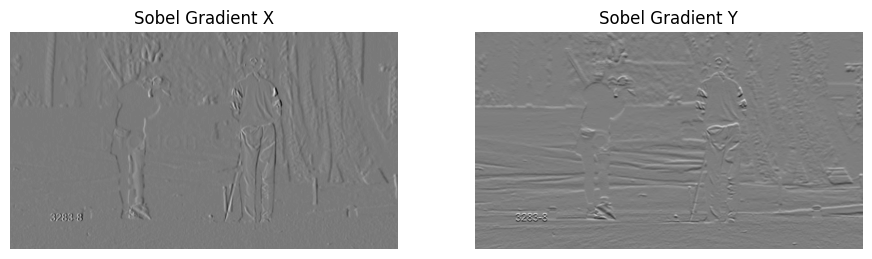

Flow dimension:  3
Flow shape: (404, 720, 2)
Padded Flow shape: (436, 752, 2)


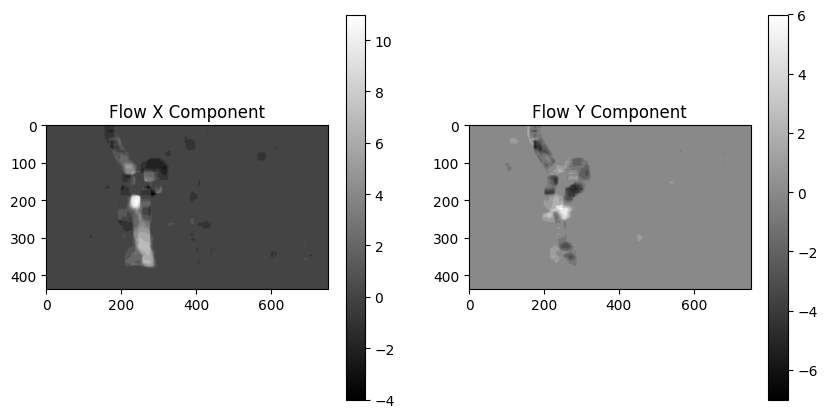

mbhx_padded shape: (436, 752, 2)
mbhy_padded shape: (436, 752, 2)


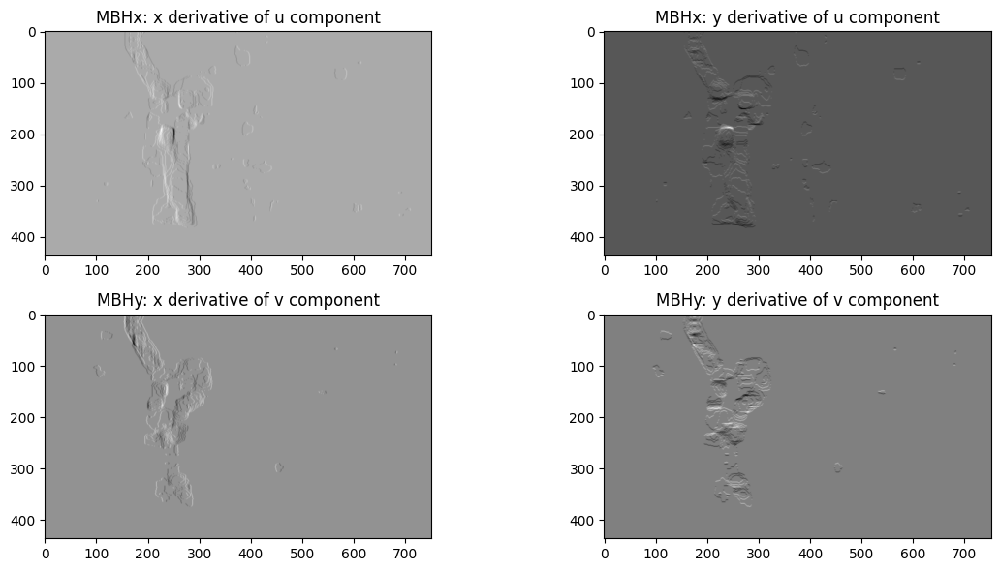

Corner shape: (1295, 1, 2)


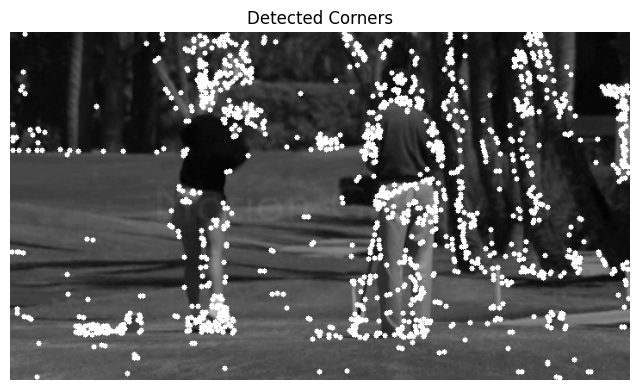

Length of Trajectory: 190
x: 475.0 y: 85.0
x: 223.0 y: 328.0
x: 465.0 y: 285.0
x: 365.0 y: 125.0
x: 235.0 y: 295.0
x: 500.0 y: 140.0
x: 237.0 y: 110.0
x: 715.0 y: 85.0
x: 715.0 y: 155.0
x: 660.0 y: 220.0
x: 210.0 y: 85.0
x: 475.0 y: 285.0
x: 236.0 y: 59.0
x: 276.0 y: 99.0
x: 635.0 y: 80.0
x: 242.0 y: 269.0
x: 175.0 y: 135.0
x: 425.0 y: 120.0
x: 645.0 y: 340.0
x: 590.0 y: 90.0
x: 520.0 y: 110.0
x: 465.0 y: 350.0
x: 605.0 y: 185.0
x: 233.0 y: 90.0
x: 245.0 y: 50.0
x: 410.0 y: 30.0
x: 199.0 y: 331.0
x: 226.0 y: 49.0
x: 220.0 y: 24.0
x: 420.0 y: 255.0
x: 221.0 y: 342.0
x: 212.0 y: 342.0
x: 222.0 y: 60.0
x: 425.0 y: 200.0
x: 250.0 y: 40.0
x: 255.0 y: 60.0
x: 465.0 y: 65.0
x: 525.0 y: 225.0
x: 30.0 y: 125.0
x: 225.0 y: 10.0
x: 210.0 y: 15.0
x: 515.0 y: 95.0
x: 485.0 y: 160.0
x: 560.0 y: 115.0
x: 295.0 y: 103.0
x: 465.0 y: 80.0
x: 255.0 y: 117.0
x: 258.0 y: 215.0
x: 591.0 y: 265.0
x: 605.0 y: 110.0
x: 425.0 y: 135.0
x: 261.0 y: 127.0
x: 455.0 y: 215.0
x: 254.0 y: 223.0
x: 585.0 y: 40.0
x: 615

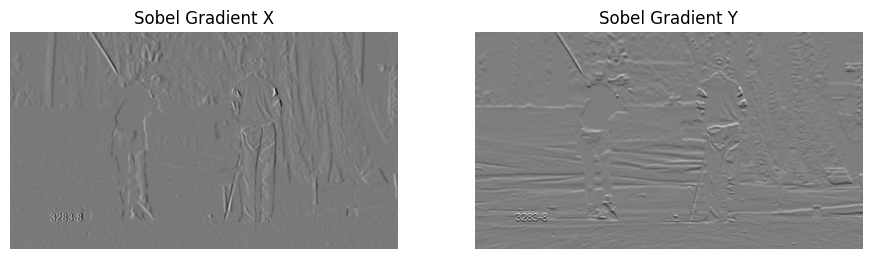

Flow dimension:  3
Flow shape: (404, 720, 2)
Padded Flow shape: (436, 752, 2)


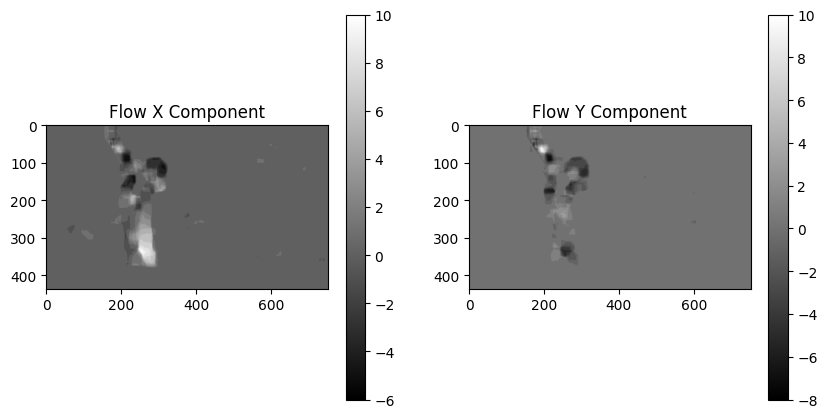

mbhx_padded shape: (436, 752, 2)
mbhy_padded shape: (436, 752, 2)


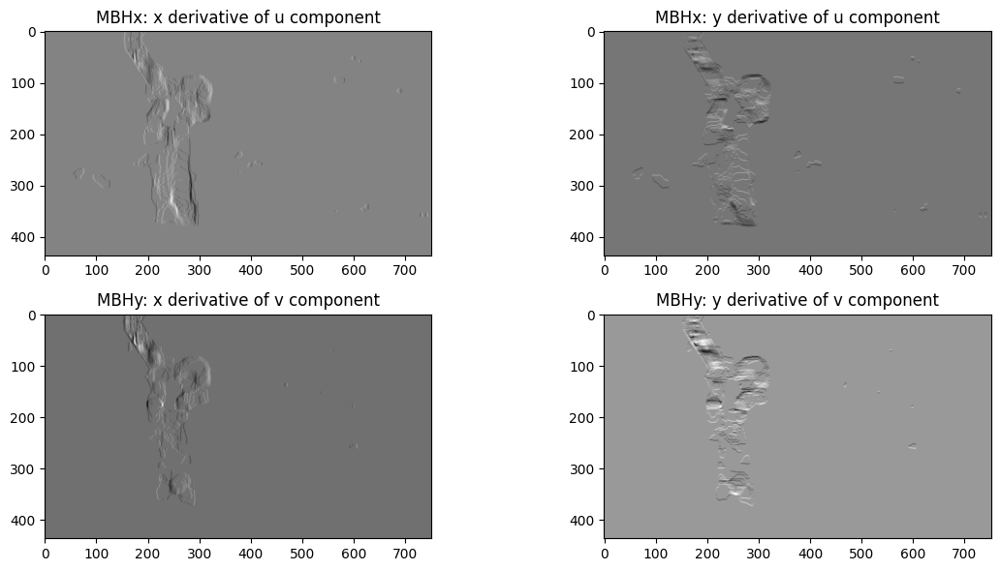

Corner shape: (1236, 1, 2)


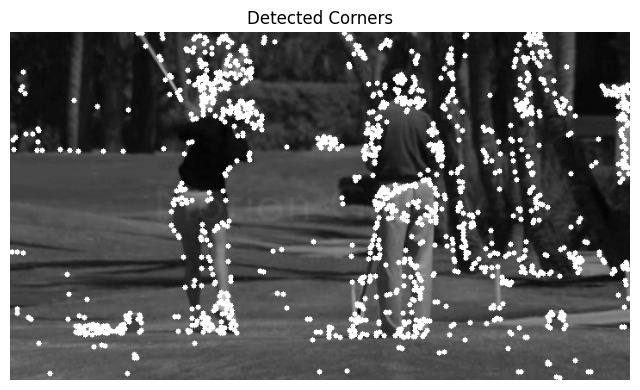

Length of Trajectory: 192
x: 223.0 y: 328.0
x: 365.0 y: 125.0
x: 500.0 y: 140.0
x: 715.0 y: 85.0
x: 660.0 y: 220.0
x: 475.0 y: 285.0
x: 276.0 y: 99.0
x: 242.0 y: 269.0
x: 425.0 y: 120.0
x: 645.0 y: 340.0
x: 590.0 y: 90.0
x: 520.0 y: 110.0
x: 465.0 y: 350.0
x: 605.0 y: 185.0
x: 233.0 y: 90.0
x: 245.0 y: 50.0
x: 410.0 y: 30.0
x: 200.0 y: 331.0
x: 226.0 y: 49.0
x: 220.0 y: 24.0
x: 419.0 y: 255.0
x: 223.0 y: 343.0
x: 214.0 y: 343.0
x: 222.0 y: 60.0
x: 425.0 y: 200.0
x: 250.0 y: 40.0
x: 255.0 y: 60.0
x: 465.0 y: 65.0
x: 525.0 y: 225.0
x: 30.0 y: 125.0
x: 225.0 y: 10.0
x: 210.0 y: 15.0
x: 515.0 y: 95.0
x: 485.0 y: 160.0
x: 560.0 y: 115.0
x: 293.0 y: 101.0
x: 465.0 y: 80.0
x: 257.0 y: 117.0
x: 257.0 y: 215.0
x: 591.0 y: 265.0
x: 605.0 y: 110.0
x: 425.0 y: 135.0
x: 264.0 y: 128.0
x: 455.0 y: 215.0
x: 254.0 y: 224.0
x: 585.0 y: 40.0
x: 615.0 y: 95.0
x: 242.0 y: 232.0
x: 585.0 y: 150.0
x: 575.0 y: 330.0
x: 390.0 y: 15.0
x: 545.0 y: 270.0
x: 505.0 y: 80.0
x: 580.0 y: 245.0
x: 45.0 y: 395.0
x: 90.

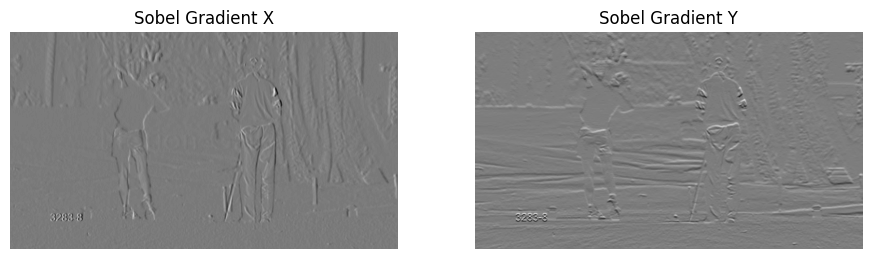

Flow dimension:  3
Flow shape: (404, 720, 2)
Padded Flow shape: (436, 752, 2)


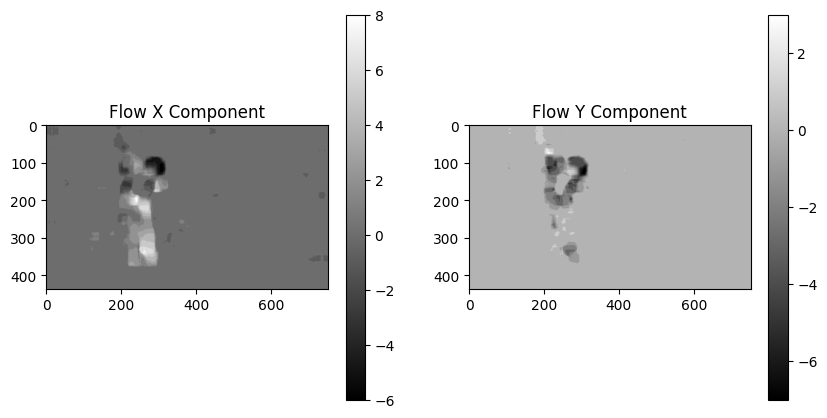

mbhx_padded shape: (436, 752, 2)
mbhy_padded shape: (436, 752, 2)


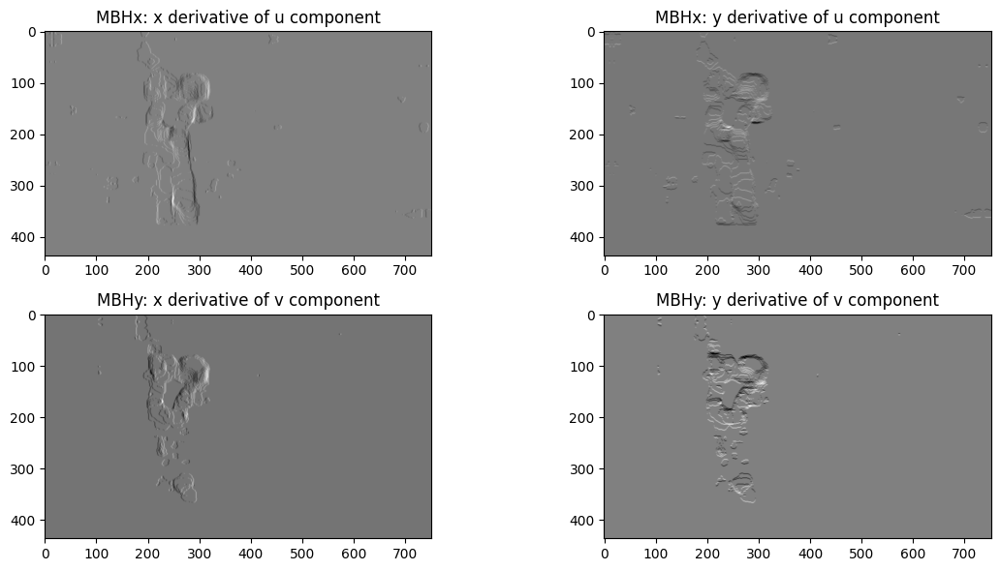

Corner shape: (1312, 1, 2)


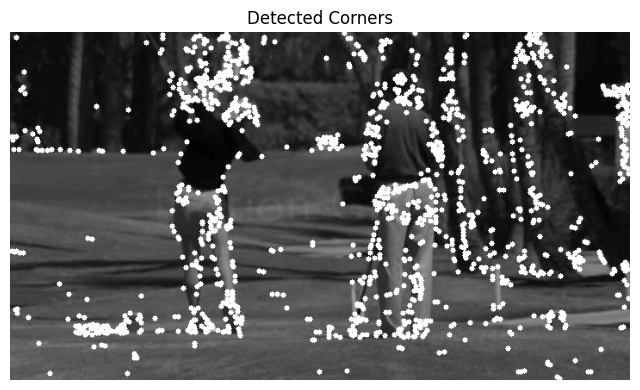

Length of Trajectory: 193
x: 365.0 y: 125.0
x: 715.0 y: 85.0
x: 475.0 y: 285.0
x: 242.0 y: 269.0
x: 425.0 y: 120.0
x: 590.0 y: 90.0
x: 465.0 y: 350.0
x: 233.0 y: 90.0
x: 245.0 y: 50.0
x: 410.0 y: 30.0
x: 200.0 y: 331.0
x: 226.0 y: 49.0
x: 220.0 y: 24.0
x: 419.0 y: 255.0
x: 224.0 y: 343.0
x: 215.0 y: 344.0
x: 222.0 y: 60.0
x: 425.0 y: 200.0
x: 250.0 y: 40.0
x: 255.0 y: 60.0
x: 465.0 y: 65.0
x: 525.0 y: 225.0
x: 30.0 y: 125.0
x: 225.0 y: 10.0
x: 210.0 y: 15.0
x: 515.0 y: 95.0
x: 485.0 y: 160.0
x: 560.0 y: 115.0
x: 289.0 y: 96.0
x: 465.0 y: 80.0
x: 258.0 y: 118.0
x: 258.0 y: 215.0
x: 591.0 y: 265.0
x: 605.0 y: 110.0
x: 425.0 y: 135.0
x: 265.0 y: 128.0
x: 455.0 y: 215.0
x: 256.0 y: 225.0
x: 585.0 y: 40.0
x: 615.0 y: 95.0
x: 245.0 y: 234.0
x: 585.0 y: 150.0
x: 575.0 y: 330.0
x: 390.0 y: 15.0
x: 545.0 y: 270.0
x: 505.0 y: 80.0
x: 580.0 y: 245.0
x: 45.0 y: 395.0
x: 90.0 y: 340.0
x: 269.0 y: 102.0
x: 270.0 y: 290.0
x: 240.0 y: 10.0
x: 715.0 y: 135.0
x: 10.0 y: 80.0
x: 15.0 y: 125.0
x: 5.0 y: 1

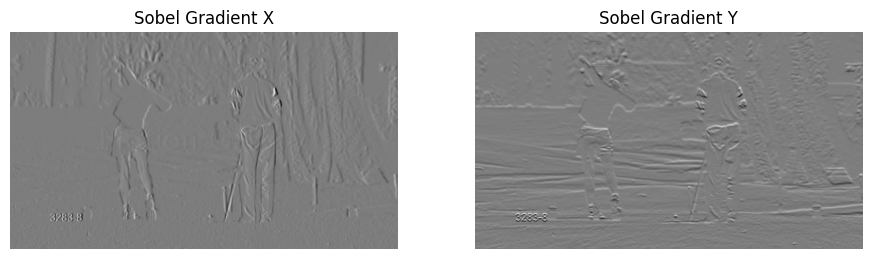

Flow dimension:  3
Flow shape: (404, 720, 2)
Padded Flow shape: (436, 752, 2)


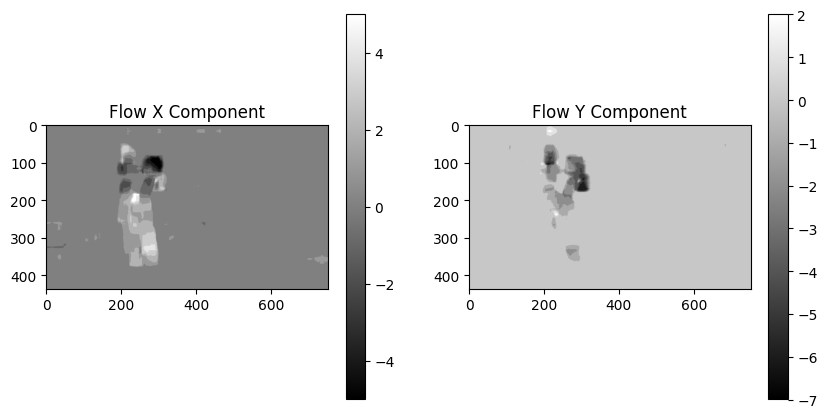

mbhx_padded shape: (436, 752, 2)
mbhy_padded shape: (436, 752, 2)


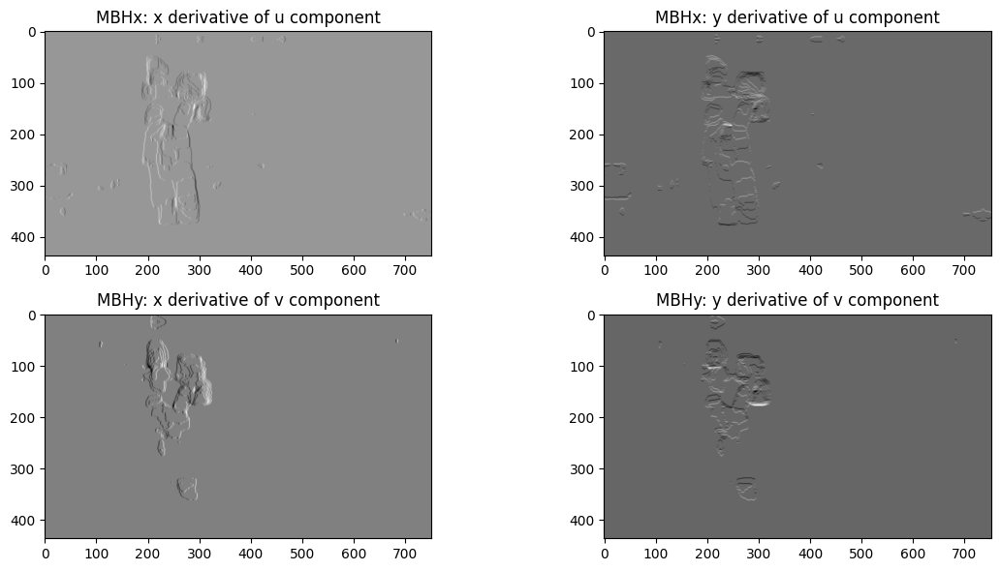

Corner shape: (1281, 1, 2)


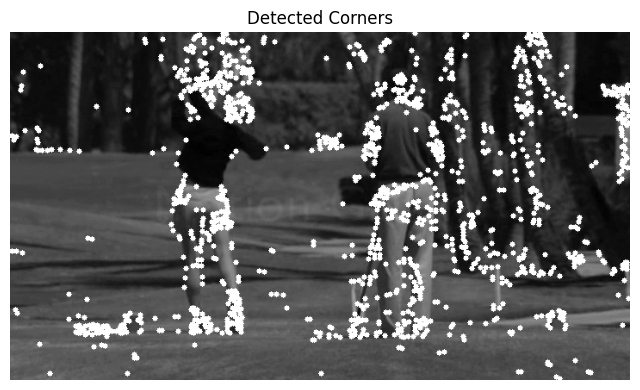

Length of Trajectory: 200
x: 715.0 y: 85.0
x: 475.0 y: 285.0
x: 425.0 y: 120.0
x: 465.0 y: 350.0
x: 236.0 y: 88.0
x: 410.0 y: 30.0
x: 226.0 y: 49.0
x: 419.0 y: 255.0
x: 226.0 y: 343.0
x: 217.0 y: 344.0
x: 222.0 y: 60.0
x: 425.0 y: 200.0
x: 250.0 y: 40.0
x: 255.0 y: 60.0
x: 465.0 y: 65.0
x: 525.0 y: 225.0
x: 30.0 y: 125.0
x: 225.0 y: 10.0
x: 210.0 y: 15.0
x: 515.0 y: 95.0
x: 485.0 y: 160.0
x: 560.0 y: 115.0
x: 283.0 y: 90.0
x: 465.0 y: 80.0
x: 260.0 y: 117.0
x: 263.0 y: 216.0
x: 591.0 y: 265.0
x: 605.0 y: 110.0
x: 425.0 y: 135.0
x: 264.0 y: 124.0
x: 455.0 y: 215.0
x: 260.0 y: 225.0
x: 585.0 y: 40.0
x: 615.0 y: 95.0
x: 247.0 y: 234.0
x: 585.0 y: 150.0
x: 575.0 y: 330.0
x: 390.0 y: 15.0
x: 545.0 y: 270.0
x: 505.0 y: 80.0
x: 580.0 y: 245.0
x: 45.0 y: 395.0
x: 90.0 y: 340.0
x: 268.0 y: 101.0
x: 274.0 y: 290.0
x: 240.0 y: 10.0
x: 715.0 y: 135.0
x: 10.0 y: 80.0
x: 15.0 y: 125.0
x: 5.0 y: 110.0
x: 235.0 y: 347.0
x: 705.0 y: 90.0
x: 91.0 y: 240.0
x: 425.0 y: 150.0
x: 450.0 y: 80.0
x: 260.0 y: 8

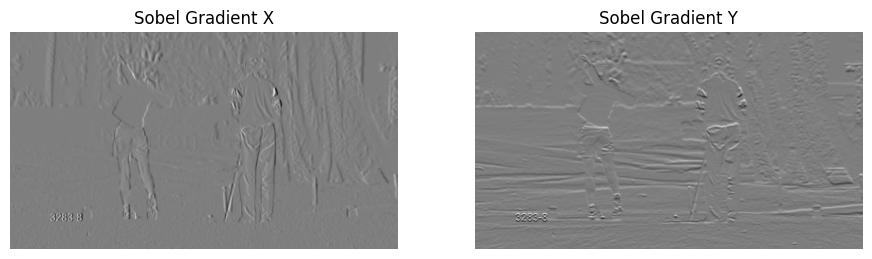

Flow dimension:  3
Flow shape: (404, 720, 2)
Padded Flow shape: (436, 752, 2)


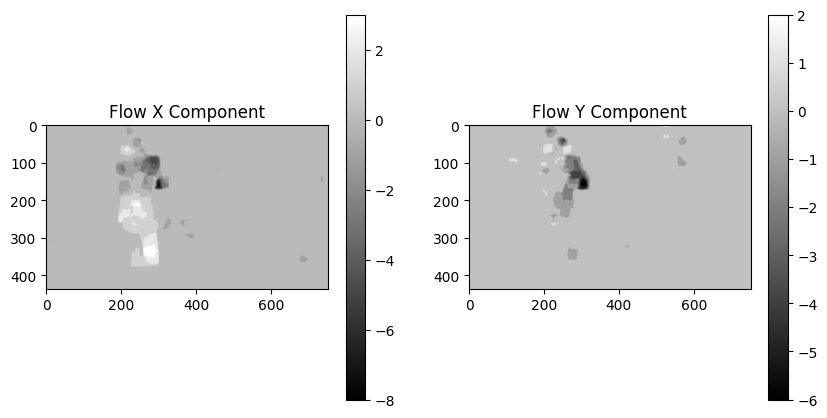

mbhx_padded shape: (436, 752, 2)
mbhy_padded shape: (436, 752, 2)


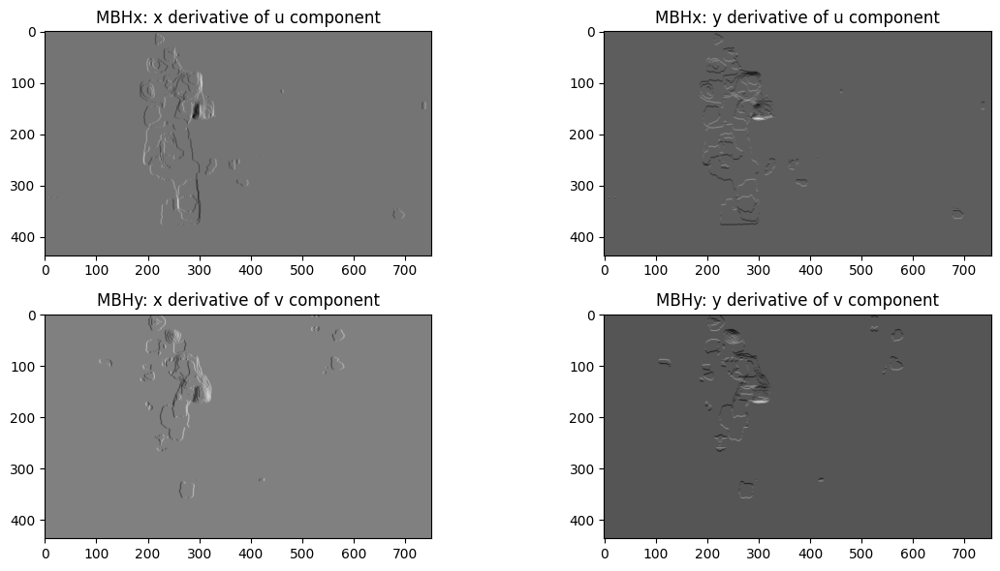

Corner shape: (1449, 1, 2)


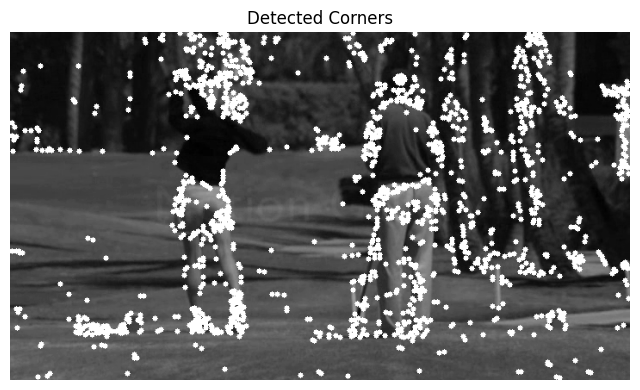

Length of Trajectory: 201
x: 475.0 y: 285.0
x: 465.0 y: 350.0
x: 410.0 y: 30.0
x: 419.0 y: 255.0
x: 217.0 y: 344.0
x: 425.0 y: 200.0
x: 255.0 y: 60.0
x: 525.0 y: 225.0
x: 225.0 y: 10.0
x: 515.0 y: 95.0
x: 485.0 y: 160.0
x: 560.0 y: 115.0
x: 278.0 y: 86.0
x: 465.0 y: 80.0
x: 260.0 y: 114.0
x: 264.0 y: 216.0
x: 591.0 y: 265.0
x: 605.0 y: 110.0
x: 425.0 y: 135.0
x: 263.0 y: 120.0
x: 455.0 y: 215.0
x: 261.0 y: 225.0
x: 585.0 y: 40.0
x: 615.0 y: 95.0
x: 248.0 y: 234.0
x: 585.0 y: 150.0
x: 575.0 y: 330.0
x: 390.0 y: 15.0
x: 545.0 y: 270.0
x: 505.0 y: 80.0
x: 580.0 y: 245.0
x: 45.0 y: 395.0
x: 90.0 y: 340.0
x: 265.0 y: 98.0
x: 277.0 y: 290.0
x: 240.0 y: 10.0
x: 715.0 y: 135.0
x: 10.0 y: 80.0
x: 15.0 y: 125.0
x: 5.0 y: 110.0
x: 237.0 y: 347.0
x: 705.0 y: 90.0
x: 91.0 y: 240.0
x: 425.0 y: 150.0
x: 450.0 y: 80.0
x: 257.0 y: 86.0
x: 430.0 y: 85.0
x: 430.0 y: 65.0
x: 105.0 y: 365.0
x: 450.0 y: 300.0
x: 495.0 y: 110.0
x: 80.0 y: 330.0
x: 705.0 y: 160.0
x: 385.0 y: 90.0
x: 5.0 y: 125.0
x: 510.0 y: 3

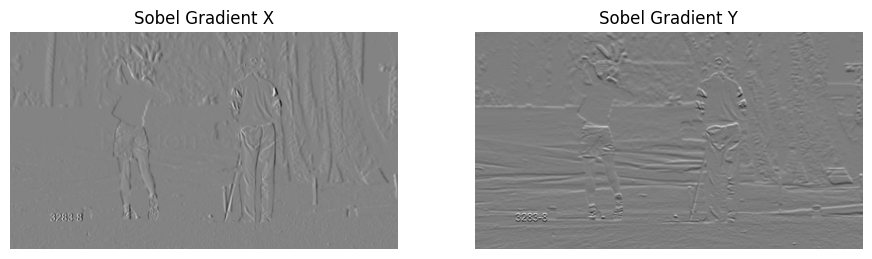

Flow dimension:  3
Flow shape: (404, 720, 2)
Padded Flow shape: (436, 752, 2)


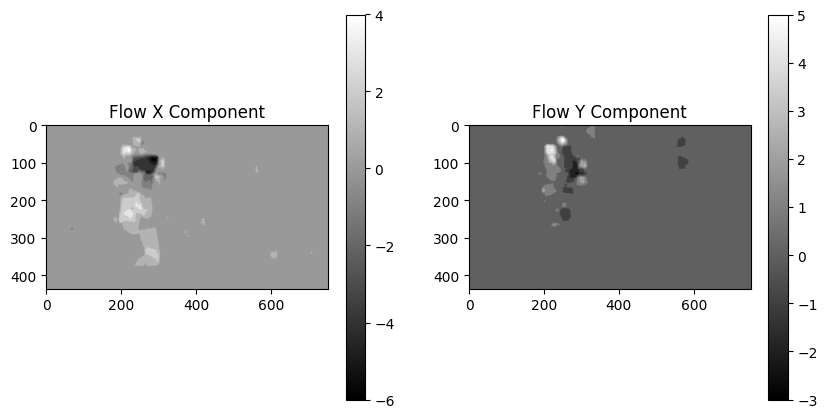

mbhx_padded shape: (436, 752, 2)
mbhy_padded shape: (436, 752, 2)


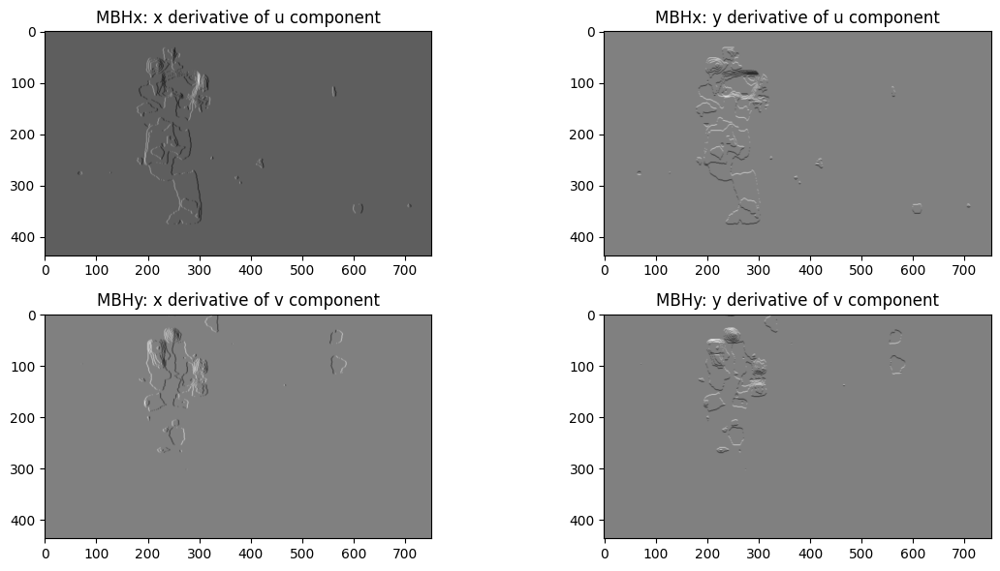

Corner shape: (1569, 1, 2)


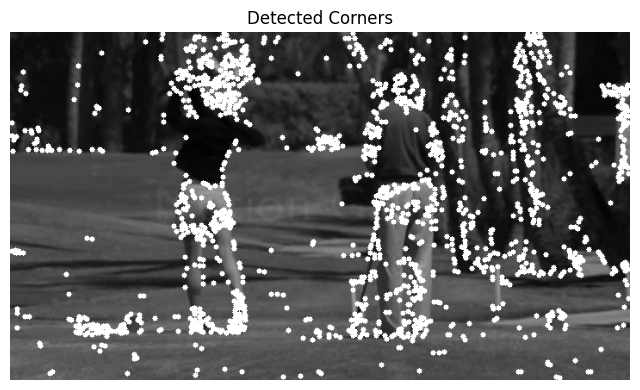

Length of Trajectory: 209
x: 465.0 y: 350.0
x: 419.0 y: 255.0
x: 425.0 y: 200.0
x: 525.0 y: 225.0
x: 515.0 y: 95.0
x: 560.0 y: 115.0
x: 465.0 y: 80.0
x: 264.0 y: 216.0
x: 605.0 y: 110.0
x: 425.0 y: 135.0
x: 262.0 y: 116.0
x: 455.0 y: 215.0
x: 262.0 y: 225.0
x: 585.0 y: 40.0
x: 615.0 y: 95.0
x: 249.0 y: 234.0
x: 585.0 y: 150.0
x: 575.0 y: 330.0
x: 390.0 y: 15.0
x: 545.0 y: 270.0
x: 505.0 y: 80.0
x: 580.0 y: 245.0
x: 45.0 y: 395.0
x: 90.0 y: 340.0
x: 261.0 y: 95.0
x: 279.0 y: 290.0
x: 240.0 y: 10.0
x: 715.0 y: 135.0
x: 10.0 y: 80.0
x: 15.0 y: 125.0
x: 5.0 y: 110.0
x: 238.0 y: 347.0
x: 705.0 y: 90.0
x: 91.0 y: 240.0
x: 425.0 y: 150.0
x: 450.0 y: 80.0
x: 254.0 y: 84.0
x: 430.0 y: 85.0
x: 430.0 y: 65.0
x: 105.0 y: 365.0
x: 450.0 y: 300.0
x: 495.0 y: 110.0
x: 80.0 y: 330.0
x: 705.0 y: 160.0
x: 385.0 y: 90.0
x: 5.0 y: 125.0
x: 510.0 y: 350.0
x: 545.0 y: 230.0
x: 660.0 y: 275.0
x: 130.0 y: 15.0
x: 260.0 y: 122.0
x: 202.0 y: 236.0
x: 475.0 y: 220.0
x: 269.0 y: 250.0
x: 635.0 y: 400.0
x: 258.0 y

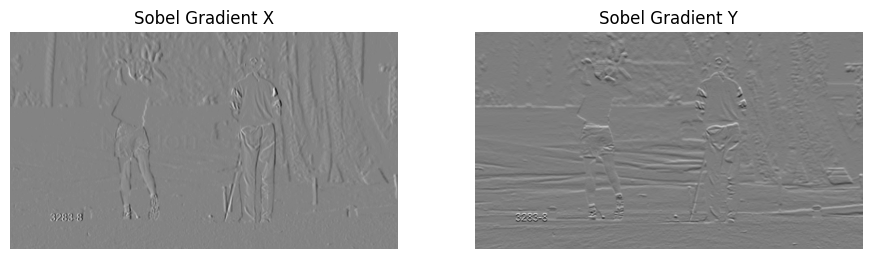

Flow dimension:  3
Flow shape: (404, 720, 2)
Padded Flow shape: (436, 752, 2)


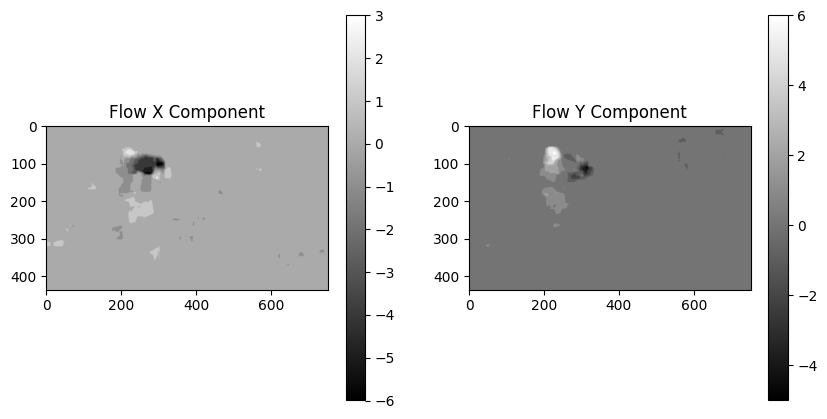

mbhx_padded shape: (436, 752, 2)
mbhy_padded shape: (436, 752, 2)


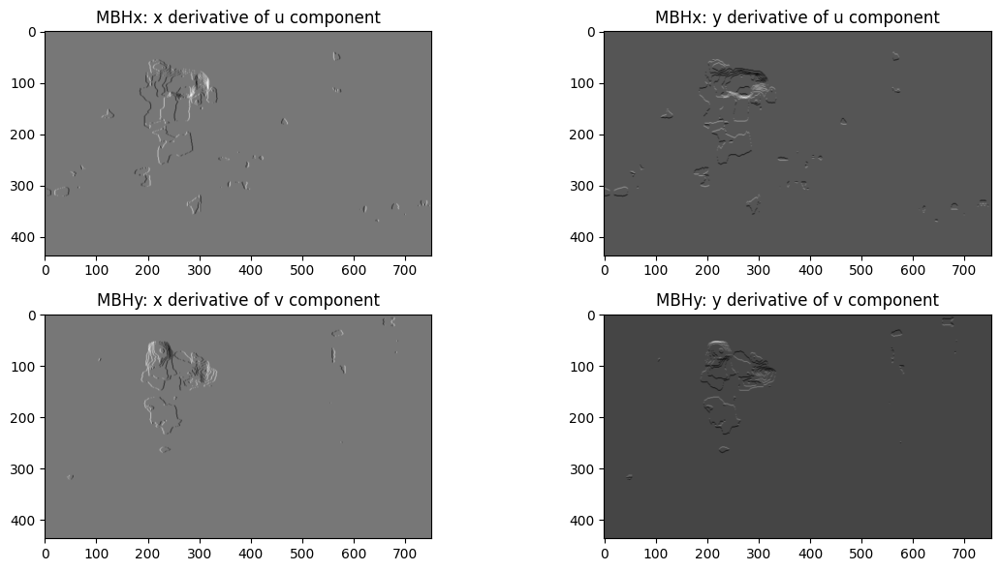

Corner shape: (1613, 1, 2)


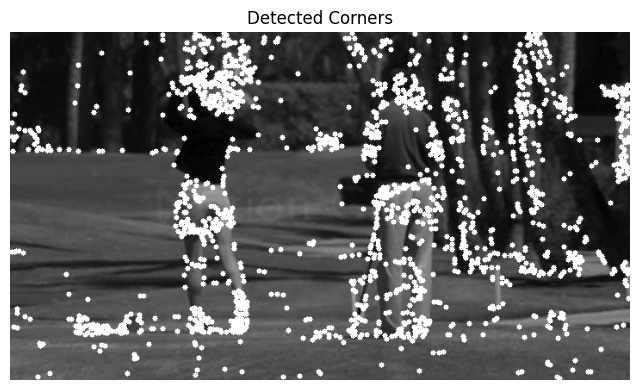

Length of Trajectory: 214
x: 419.0 y: 255.0
x: 525.0 y: 225.0
x: 560.0 y: 115.0
x: 264.0 y: 216.0
x: 425.0 y: 135.0
x: 455.0 y: 215.0
x: 585.0 y: 40.0
x: 249.0 y: 234.0
x: 575.0 y: 330.0
x: 545.0 y: 270.0
x: 580.0 y: 245.0
x: 90.0 y: 340.0
x: 257.0 y: 93.0
x: 280.0 y: 290.0
x: 240.0 y: 10.0
x: 715.0 y: 135.0
x: 10.0 y: 80.0
x: 15.0 y: 125.0
x: 5.0 y: 110.0
x: 239.0 y: 347.0
x: 705.0 y: 90.0
x: 91.0 y: 240.0
x: 425.0 y: 150.0
x: 450.0 y: 80.0
x: 250.0 y: 83.0
x: 430.0 y: 85.0
x: 430.0 y: 65.0
x: 105.0 y: 365.0
x: 450.0 y: 300.0
x: 495.0 y: 110.0
x: 80.0 y: 330.0
x: 705.0 y: 160.0
x: 385.0 y: 90.0
x: 5.0 y: 125.0
x: 510.0 y: 350.0
x: 545.0 y: 230.0
x: 660.0 y: 275.0
x: 130.0 y: 15.0
x: 258.0 y: 120.0
x: 204.0 y: 236.0
x: 475.0 y: 220.0
x: 269.0 y: 250.0
x: 635.0 y: 400.0
x: 258.0 y: 257.0
x: 202.0 y: 121.0
x: 258.0 y: 220.0
x: 213.0 y: 338.0
x: 295.0 y: 10.0
x: 430.0 y: 175.0
x: 257.0 y: 144.0
x: 610.0 y: 195.0
x: 256.0 y: 159.0
x: 485.0 y: 10.0
x: 140.0 y: 50.0
x: 670.0 y: 240.0
x: 520.

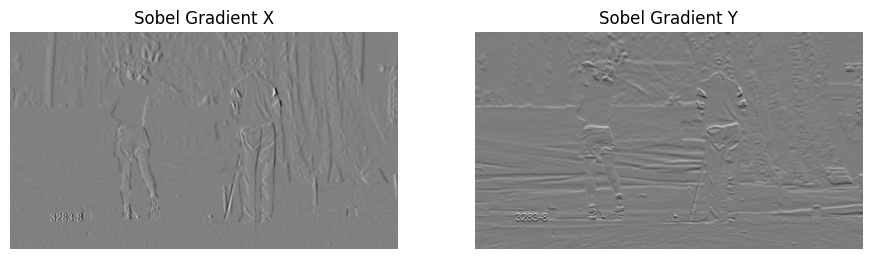

Flow dimension:  3
Flow shape: (404, 720, 2)
Padded Flow shape: (436, 752, 2)


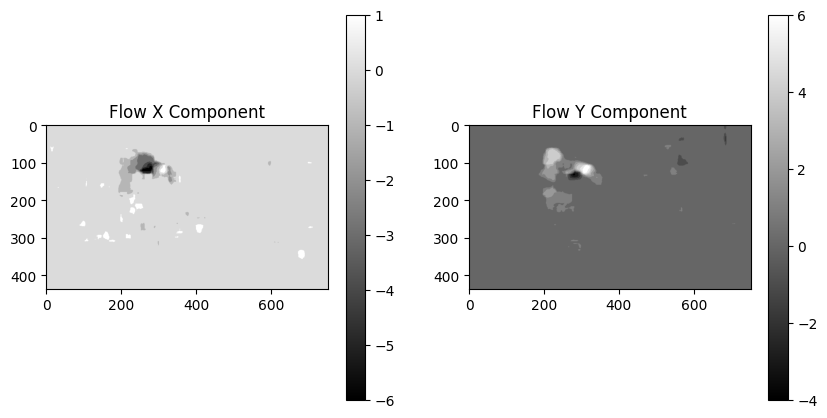

mbhx_padded shape: (436, 752, 2)
mbhy_padded shape: (436, 752, 2)


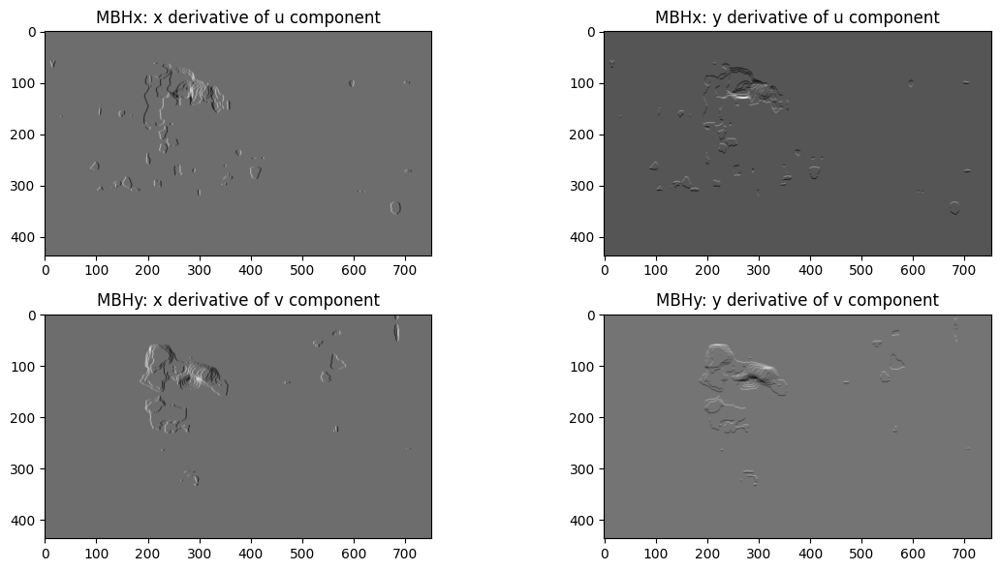

Corner shape: (1486, 1, 2)


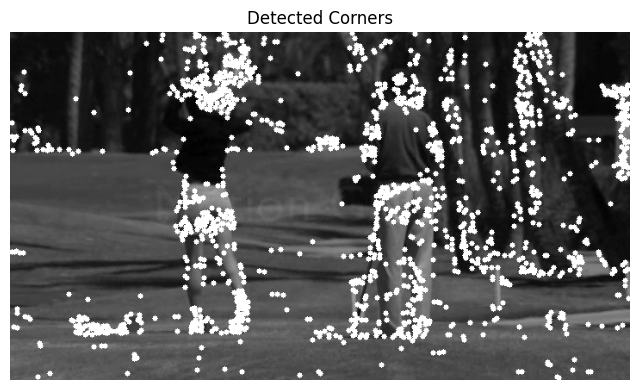

Length of Trajectory: 217
x: 525.0 y: 225.0
x: 264.0 y: 216.0
x: 455.0 y: 215.0
x: 249.0 y: 234.0
x: 545.0 y: 270.0
x: 90.0 y: 340.0
x: 280.0 y: 290.0
x: 715.0 y: 135.0
x: 15.0 y: 125.0
x: 239.0 y: 347.0
x: 91.0 y: 240.0
x: 425.0 y: 150.0
x: 450.0 y: 80.0
x: 246.0 y: 83.0
x: 430.0 y: 85.0
x: 430.0 y: 65.0
x: 105.0 y: 365.0
x: 450.0 y: 300.0
x: 495.0 y: 110.0
x: 80.0 y: 330.0
x: 705.0 y: 160.0
x: 385.0 y: 90.0
x: 5.0 y: 125.0
x: 510.0 y: 350.0
x: 545.0 y: 230.0
x: 660.0 y: 275.0
x: 130.0 y: 15.0
x: 257.0 y: 118.0
x: 204.0 y: 236.0
x: 475.0 y: 220.0
x: 269.0 y: 250.0
x: 635.0 y: 400.0
x: 258.0 y: 257.0
x: 201.0 y: 122.0
x: 259.0 y: 220.0
x: 213.0 y: 338.0
x: 295.0 y: 10.0
x: 430.0 y: 175.0
x: 256.0 y: 144.0
x: 610.0 y: 195.0
x: 256.0 y: 159.0
x: 485.0 y: 10.0
x: 140.0 y: 50.0
x: 670.0 y: 240.0
x: 520.0 y: 120.0
x: 610.0 y: 215.0
x: 276.0 y: 279.0
x: 269.0 y: 180.0
x: 415.0 y: 115.0
x: 250.0 y: 67.0
x: 225.0 y: 321.0
x: 243.0 y: 205.0
x: 565.0 y: 160.0
x: 500.0 y: 165.0
x: 15.0 y: 45.0
x:

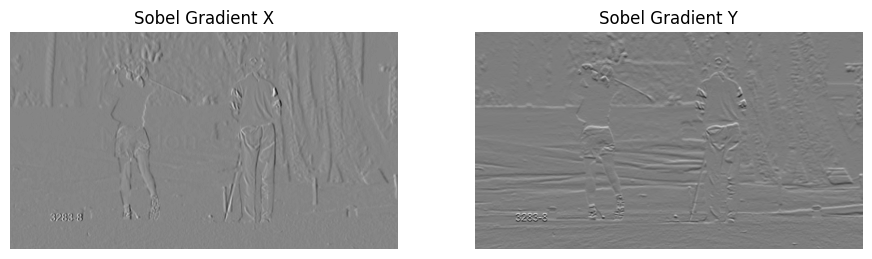

Flow dimension:  3
Flow shape: (404, 720, 2)
Padded Flow shape: (436, 752, 2)


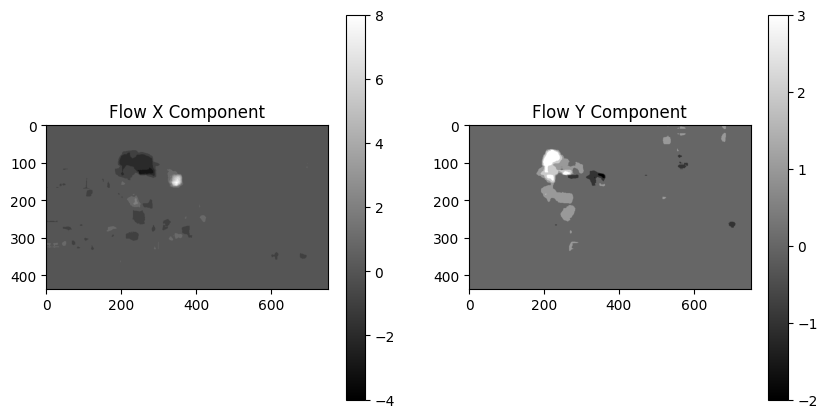

mbhx_padded shape: (436, 752, 2)
mbhy_padded shape: (436, 752, 2)


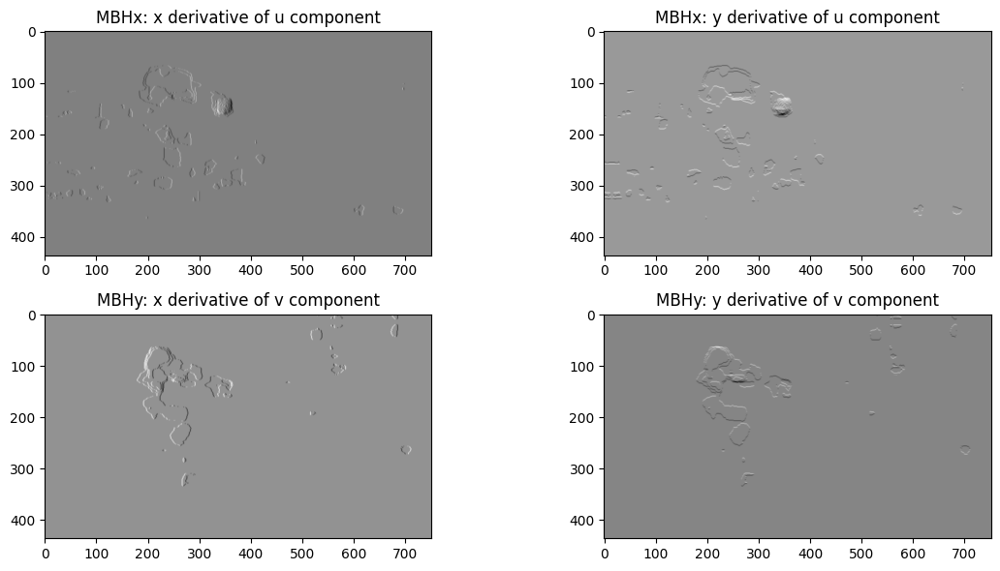

Corner shape: (1545, 1, 2)


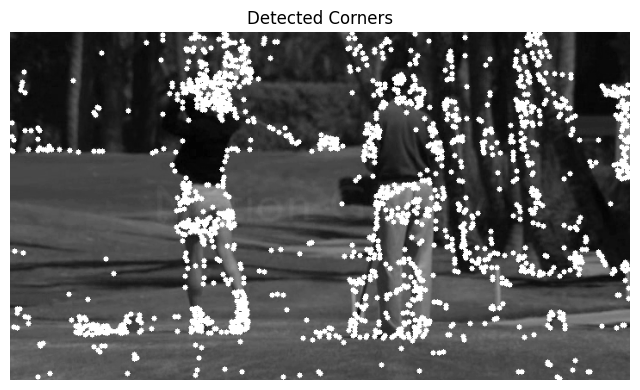

Length of Trajectory: 215
x: 264.0 y: 216.0
x: 249.0 y: 234.0
x: 90.0 y: 340.0
x: 715.0 y: 135.0
x: 239.0 y: 347.0
x: 425.0 y: 150.0
x: 246.0 y: 83.0
x: 430.0 y: 65.0
x: 450.0 y: 300.0
x: 80.0 y: 330.0
x: 385.0 y: 90.0
x: 510.0 y: 350.0
x: 660.0 y: 275.0
x: 257.0 y: 118.0
x: 204.0 y: 236.0
x: 475.0 y: 220.0
x: 269.0 y: 250.0
x: 635.0 y: 400.0
x: 258.0 y: 257.0
x: 200.0 y: 124.0
x: 259.0 y: 220.0
x: 213.0 y: 338.0
x: 295.0 y: 10.0
x: 430.0 y: 175.0
x: 256.0 y: 144.0
x: 610.0 y: 195.0
x: 256.0 y: 159.0
x: 485.0 y: 10.0
x: 140.0 y: 50.0
x: 670.0 y: 240.0
x: 520.0 y: 120.0
x: 610.0 y: 215.0
x: 276.0 y: 279.0
x: 269.0 y: 180.0
x: 415.0 y: 115.0
x: 247.0 y: 67.0
x: 225.0 y: 321.0
x: 243.0 y: 206.0
x: 565.0 y: 160.0
x: 500.0 y: 165.0
x: 15.0 y: 45.0
x: 450.0 y: 345.0
x: 215.0 y: 5.0
x: 400.0 y: 35.0
x: 228.0 y: 95.0
x: 254.0 y: 99.0
x: 210.0 y: 213.0
x: 225.0 y: 110.0
x: 90.0 y: 310.0
x: 191.0 y: 148.0
x: 650.0 y: 255.0
x: 219.0 y: 41.0
x: 710.0 y: 170.0
x: 10.0 y: 255.0
x: 396.0 y: 260.0
x: 

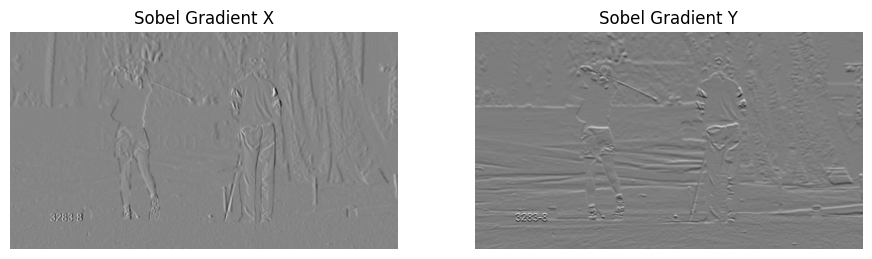

Flow dimension:  3
Flow shape: (404, 720, 2)
Padded Flow shape: (436, 752, 2)


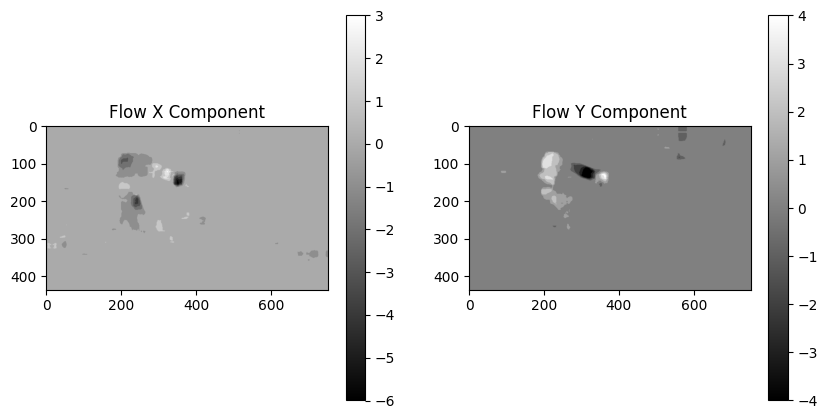

mbhx_padded shape: (436, 752, 2)
mbhy_padded shape: (436, 752, 2)


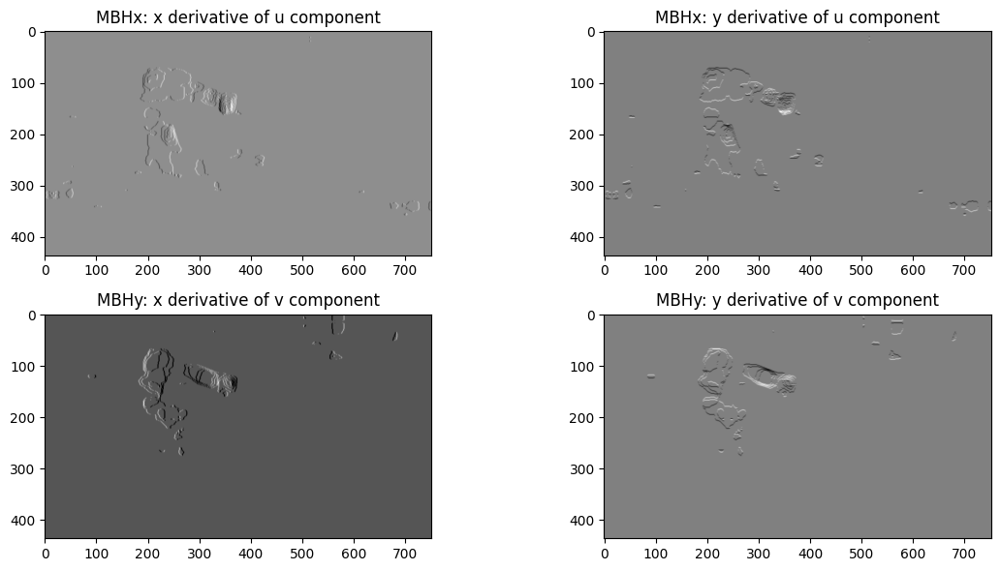

Corner shape: (1557, 1, 2)


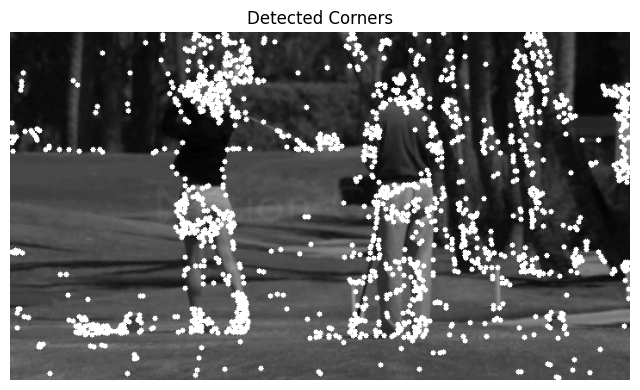

Length of Trajectory: 210
x: 249.0 y: 234.0
x: 90.0 y: 340.0
x: 239.0 y: 347.0
x: 246.0 y: 83.0
x: 450.0 y: 300.0
x: 385.0 y: 90.0
x: 660.0 y: 275.0
x: 256.0 y: 117.0
x: 475.0 y: 220.0
x: 635.0 y: 400.0
x: 200.0 y: 124.0
x: 213.0 y: 338.0
x: 430.0 y: 175.0
x: 610.0 y: 195.0
x: 485.0 y: 10.0
x: 670.0 y: 240.0
x: 610.0 y: 215.0
x: 276.0 y: 279.0
x: 269.0 y: 180.0
x: 415.0 y: 115.0
x: 245.0 y: 67.0
x: 225.0 y: 321.0
x: 243.0 y: 207.0
x: 565.0 y: 160.0
x: 500.0 y: 165.0
x: 15.0 y: 45.0
x: 450.0 y: 345.0
x: 215.0 y: 5.0
x: 400.0 y: 35.0
x: 226.0 y: 96.0
x: 252.0 y: 100.0
x: 210.0 y: 213.0
x: 224.0 y: 111.0
x: 90.0 y: 310.0
x: 191.0 y: 149.0
x: 650.0 y: 255.0
x: 219.0 y: 41.0
x: 710.0 y: 170.0
x: 10.0 y: 255.0
x: 396.0 y: 260.0
x: 253.0 y: 78.0
x: 250.0 y: 30.0
x: 224.0 y: 76.0
x: 230.0 y: 237.0
x: 680.0 y: 150.0
x: 605.0 y: 245.0
x: 274.0 y: 312.0
x: 323.0 y: 255.0
x: 470.0 y: 55.0
x: 338.0 y: 280.0
x: 260.0 y: 90.0
x: 715.0 y: 290.0
x: 281.0 y: 328.0
x: 450.0 y: 55.0
x: 715.0 y: 145.0
x: 4

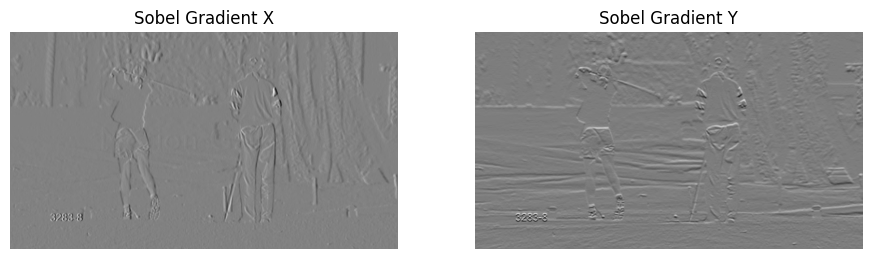

Flow dimension:  3
Flow shape: (404, 720, 2)
Padded Flow shape: (436, 752, 2)


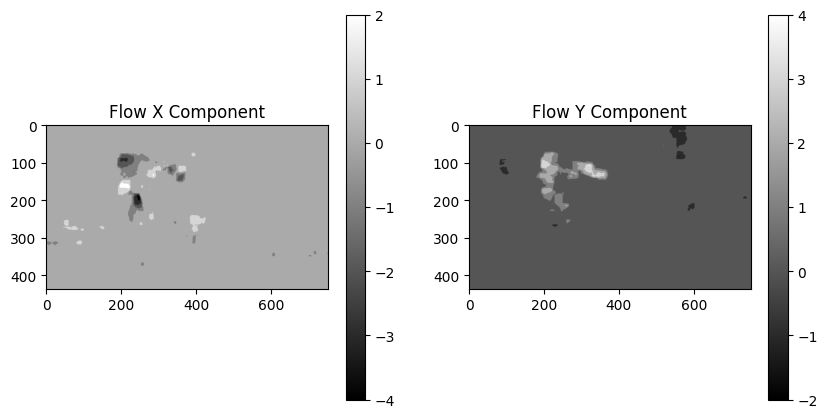

mbhx_padded shape: (436, 752, 2)
mbhy_padded shape: (436, 752, 2)


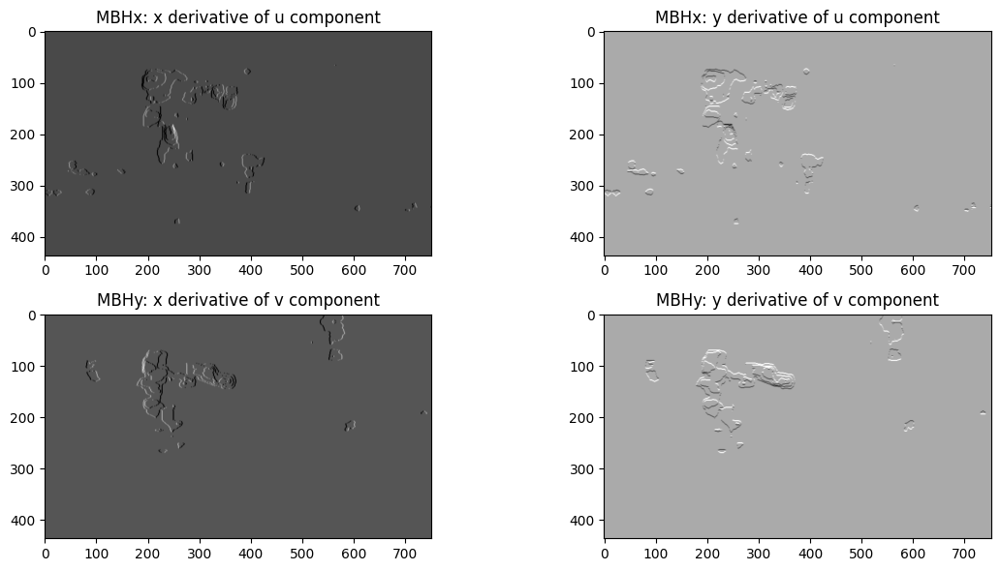

Corner shape: (1555, 1, 2)


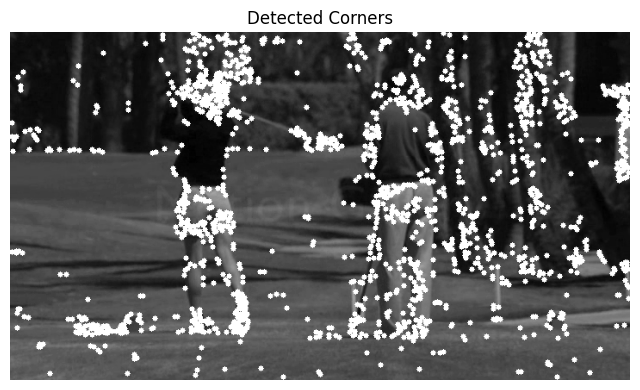

Length of Trajectory: 199
x: 90.0 y: 340.0
x: 246.0 y: 83.0
x: 385.0 y: 90.0
x: 256.0 y: 117.0
x: 635.0 y: 400.0
x: 213.0 y: 338.0
x: 610.0 y: 195.0
x: 670.0 y: 240.0
x: 276.0 y: 279.0
x: 415.0 y: 115.0
x: 225.0 y: 321.0
x: 565.0 y: 160.0
x: 15.0 y: 45.0
x: 215.0 y: 5.0
x: 226.0 y: 96.0
x: 210.0 y: 213.0
x: 90.0 y: 310.0
x: 650.0 y: 255.0
x: 219.0 y: 41.0
x: 710.0 y: 170.0
x: 10.0 y: 255.0
x: 396.0 y: 260.0
x: 252.0 y: 78.0
x: 250.0 y: 30.0
x: 223.0 y: 77.0
x: 230.0 y: 237.0
x: 680.0 y: 150.0
x: 605.0 y: 245.0
x: 274.0 y: 312.0
x: 323.0 y: 255.0
x: 470.0 y: 55.0
x: 338.0 y: 280.0
x: 260.0 y: 89.0
x: 715.0 y: 290.0
x: 281.0 y: 328.0
x: 450.0 y: 55.0
x: 715.0 y: 145.0
x: 495.0 y: 220.0
x: 360.0 y: 135.0
x: 525.0 y: 180.0
x: 380.0 y: 135.0
x: 285.0 y: 40.0
x: 600.0 y: 15.0
x: 100.0 y: 85.0
x: 600.0 y: 150.0
x: 286.0 y: 326.0
x: 227.0 y: 336.0
x: 246.0 y: 192.0
x: 475.0 y: 300.0
x: 710.0 y: 65.0
x: 234.0 y: 193.0
x: 600.0 y: 70.0
x: 615.0 y: 55.0
x: 200.0 y: 176.0
x: 590.0 y: 205.0
x: 195.

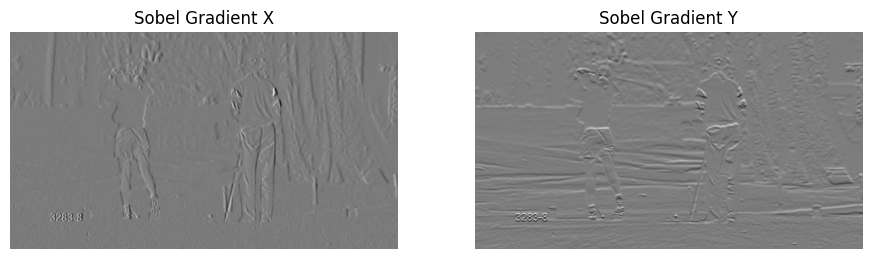

Flow dimension:  3
Flow shape: (404, 720, 2)
Padded Flow shape: (436, 752, 2)


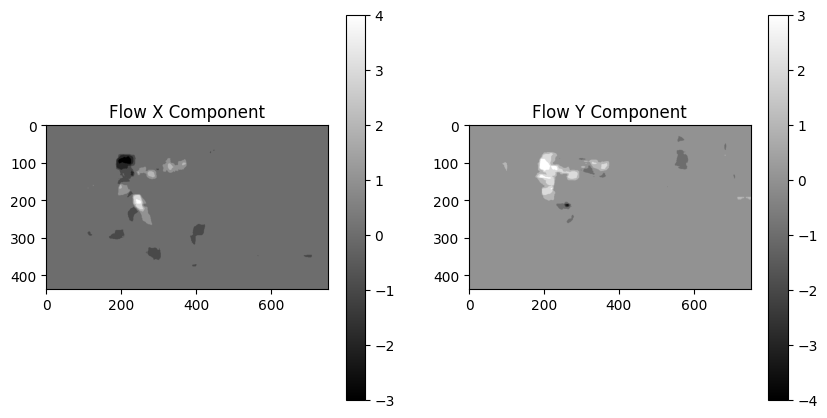

mbhx_padded shape: (436, 752, 2)
mbhy_padded shape: (436, 752, 2)


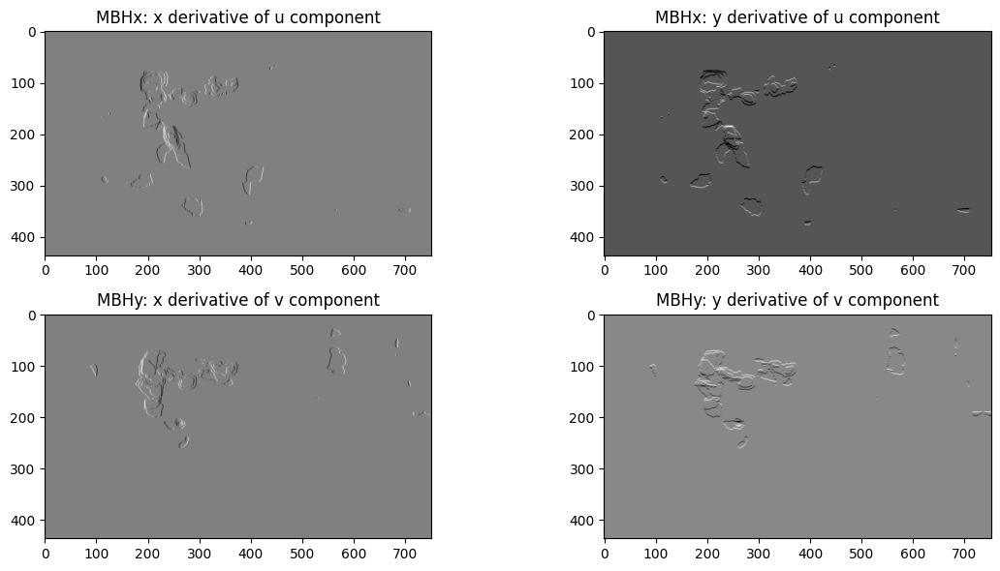

Corner shape: (1309, 1, 2)


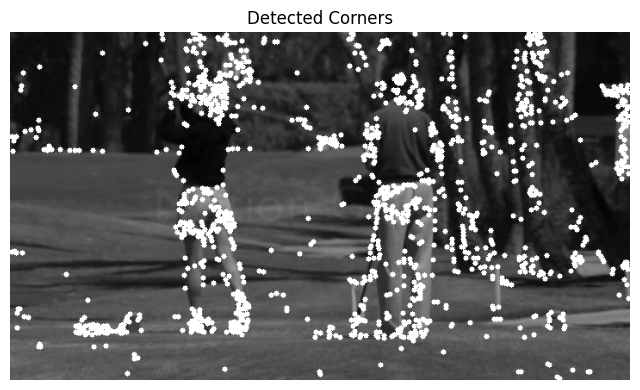

Length of Trajectory: 194
x: 246.0 y: 83.0
x: 256.0 y: 117.0
x: 213.0 y: 338.0
x: 670.0 y: 240.0
x: 415.0 y: 115.0
x: 565.0 y: 160.0
x: 215.0 y: 5.0
x: 210.0 y: 213.0
x: 650.0 y: 255.0
x: 710.0 y: 170.0
x: 396.0 y: 260.0
x: 250.0 y: 30.0
x: 230.0 y: 237.0
x: 605.0 y: 245.0
x: 274.0 y: 312.0
x: 323.0 y: 255.0
x: 470.0 y: 55.0
x: 338.0 y: 280.0
x: 260.0 y: 90.0
x: 715.0 y: 290.0
x: 281.0 y: 328.0
x: 450.0 y: 55.0
x: 715.0 y: 145.0
x: 495.0 y: 220.0
x: 360.0 y: 135.0
x: 525.0 y: 180.0
x: 380.0 y: 135.0
x: 285.0 y: 40.0
x: 600.0 y: 15.0
x: 100.0 y: 85.0
x: 600.0 y: 150.0
x: 286.0 y: 326.0
x: 227.0 y: 336.0
x: 246.0 y: 193.0
x: 475.0 y: 300.0
x: 710.0 y: 65.0
x: 232.0 y: 194.0
x: 600.0 y: 70.0
x: 615.0 y: 55.0
x: 200.0 y: 177.0
x: 590.0 y: 205.0
x: 195.0 y: 228.0
x: 415.0 y: 165.0
x: 430.0 y: 345.0
x: 269.0 y: 340.0
x: 227.0 y: 78.0
x: 238.0 y: 329.0
x: 204.0 y: 198.0
x: 261.0 y: 301.0
x: 645.0 y: 80.0
x: 400.0 y: 25.0
x: 710.0 y: 120.0
x: 600.0 y: 95.0
x: 550.0 y: 145.0
x: 450.0 y: 70.0
x:

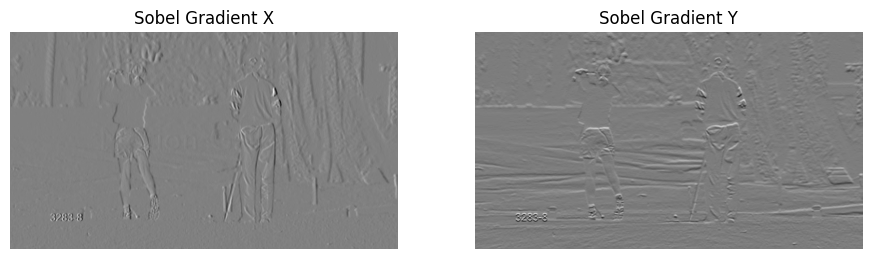

Flow dimension:  3
Flow shape: (404, 720, 2)
Padded Flow shape: (436, 752, 2)


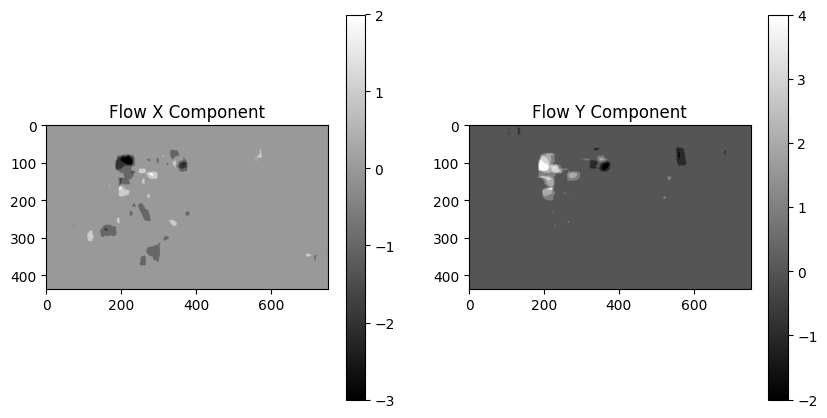

mbhx_padded shape: (436, 752, 2)
mbhy_padded shape: (436, 752, 2)


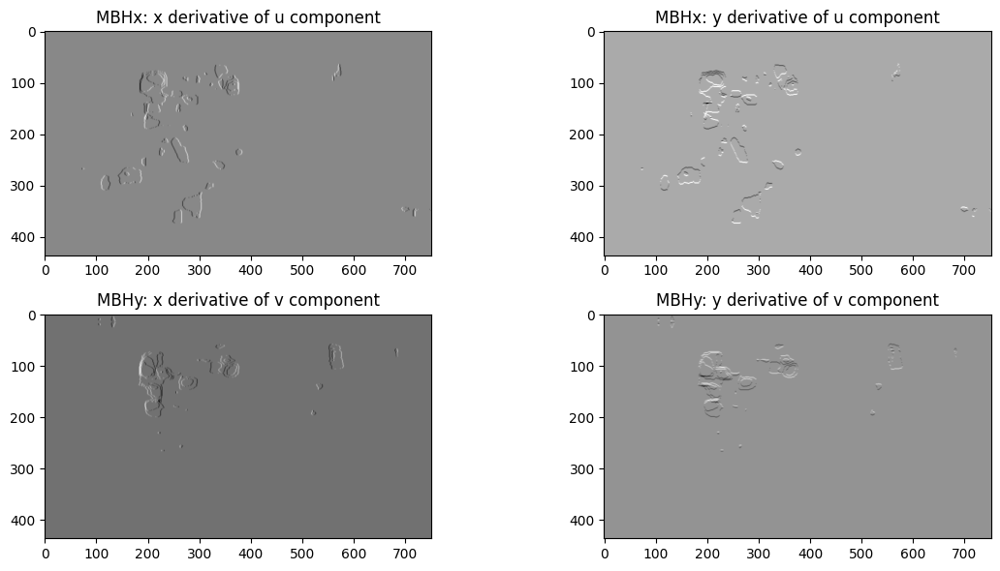

Corner shape: (1308, 1, 2)


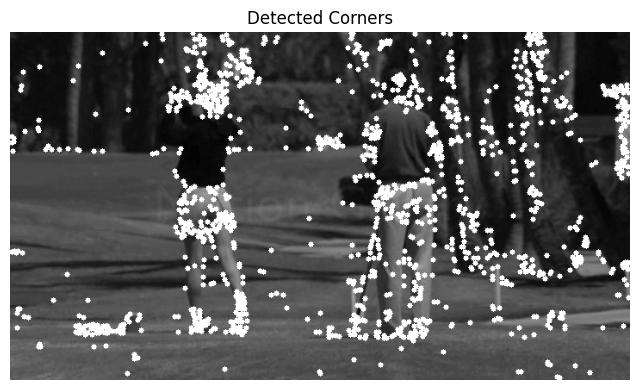

Length of Trajectory: 187
x: 256.0 y: 117.0
x: 670.0 y: 240.0
x: 565.0 y: 160.0
x: 210.0 y: 213.0
x: 710.0 y: 170.0
x: 250.0 y: 30.0
x: 605.0 y: 245.0
x: 323.0 y: 255.0
x: 338.0 y: 280.0
x: 715.0 y: 290.0
x: 450.0 y: 55.0
x: 495.0 y: 220.0
x: 525.0 y: 180.0
x: 285.0 y: 40.0
x: 100.0 y: 85.0
x: 286.0 y: 326.0
x: 227.0 y: 336.0
x: 246.0 y: 191.0
x: 475.0 y: 300.0
x: 710.0 y: 65.0
x: 235.0 y: 193.0
x: 600.0 y: 70.0
x: 615.0 y: 55.0
x: 200.0 y: 178.0
x: 590.0 y: 205.0
x: 195.0 y: 228.0
x: 415.0 y: 165.0
x: 430.0 y: 345.0
x: 269.0 y: 340.0
x: 227.0 y: 78.0
x: 238.0 y: 329.0
x: 204.0 y: 198.0
x: 261.0 y: 301.0
x: 645.0 y: 80.0
x: 400.0 y: 25.0
x: 710.0 y: 120.0
x: 600.0 y: 95.0
x: 550.0 y: 145.0
x: 450.0 y: 70.0
x: 430.0 y: 190.0
x: 510.0 y: 26.0
x: 510.0 y: 35.0
x: 575.0 y: 260.0
x: 620.0 y: 280.0
x: 490.0 y: 170.0
x: 655.0 y: 380.0
x: 440.0 y: 15.0
x: 520.0 y: 195.0
x: 625.0 y: 35.0
x: 640.0 y: 325.0
x: 178.0 y: 74.0
x: 275.0 y: 342.0
x: 199.0 y: 104.0
x: 195.0 y: 201.0
x: 260.0 y: 193.0
x

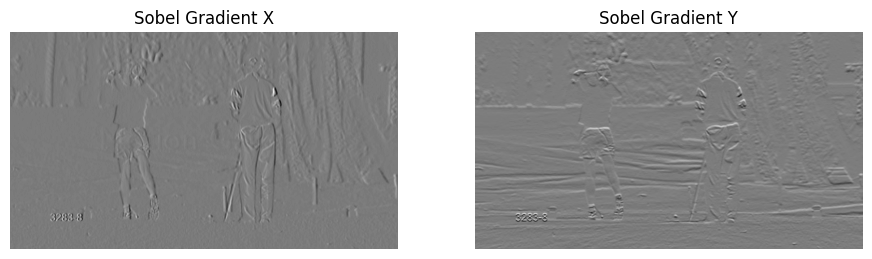

Flow dimension:  3
Flow shape: (404, 720, 2)
Padded Flow shape: (436, 752, 2)


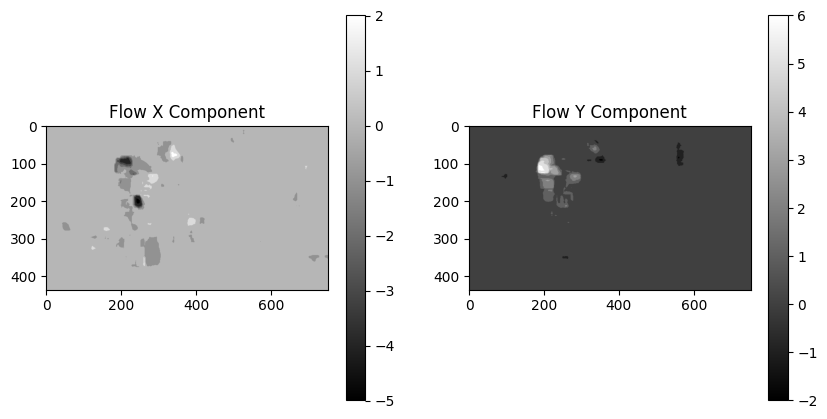

mbhx_padded shape: (436, 752, 2)
mbhy_padded shape: (436, 752, 2)


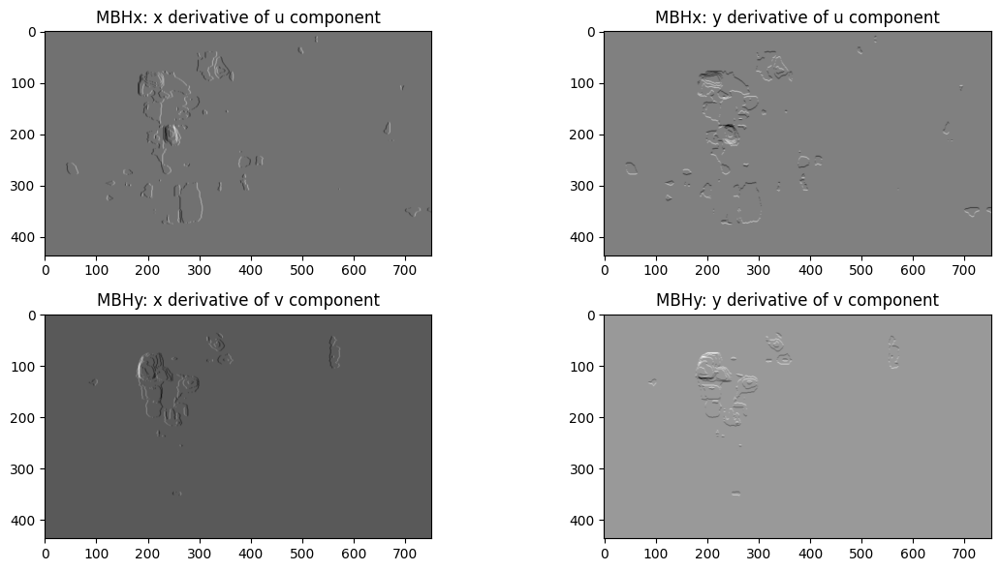

Corner shape: (1209, 1, 2)


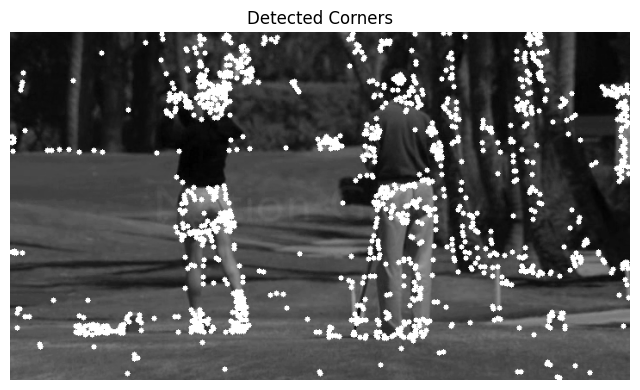

Length of Trajectory: 180
x: 670.0 y: 240.0
x: 210.0 y: 213.0
x: 250.0 y: 30.0
x: 323.0 y: 255.0
x: 715.0 y: 290.0
x: 495.0 y: 220.0
x: 285.0 y: 40.0
x: 286.0 y: 326.0
x: 246.0 y: 191.0
x: 710.0 y: 65.0
x: 600.0 y: 70.0
x: 200.0 y: 178.0
x: 195.0 y: 228.0
x: 430.0 y: 345.0
x: 269.0 y: 340.0
x: 227.0 y: 78.0
x: 238.0 y: 329.0
x: 204.0 y: 198.0
x: 261.0 y: 301.0
x: 645.0 y: 80.0
x: 400.0 y: 25.0
x: 710.0 y: 120.0
x: 600.0 y: 95.0
x: 550.0 y: 145.0
x: 450.0 y: 70.0
x: 430.0 y: 190.0
x: 510.0 y: 26.0
x: 510.0 y: 35.0
x: 575.0 y: 260.0
x: 620.0 y: 280.0
x: 490.0 y: 170.0
x: 655.0 y: 380.0
x: 440.0 y: 15.0
x: 520.0 y: 195.0
x: 625.0 y: 35.0
x: 640.0 y: 325.0
x: 176.0 y: 77.0
x: 274.0 y: 342.0
x: 198.0 y: 106.0
x: 195.0 y: 201.0
x: 260.0 y: 193.0
x: 252.0 y: 114.0
x: 232.0 y: 59.0
x: 480.0 y: 80.0
x: 440.0 y: 325.0
x: 250.0 y: 227.0
x: 490.0 y: 120.0
x: 213.0 y: 320.0
x: 230.0 y: 85.0
x: 645.0 y: 340.0
x: 660.0 y: 220.0
x: 665.0 y: 265.0
x: 705.0 y: 305.0
x: 425.0 y: 110.0
x: 80.0 y: 340.0
x:

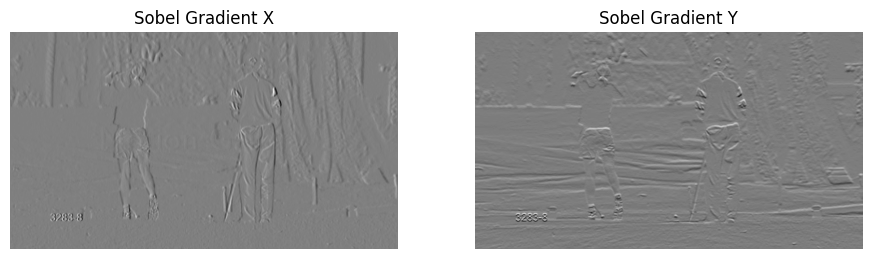

Flow dimension:  3
Flow shape: (404, 720, 2)
Padded Flow shape: (436, 752, 2)


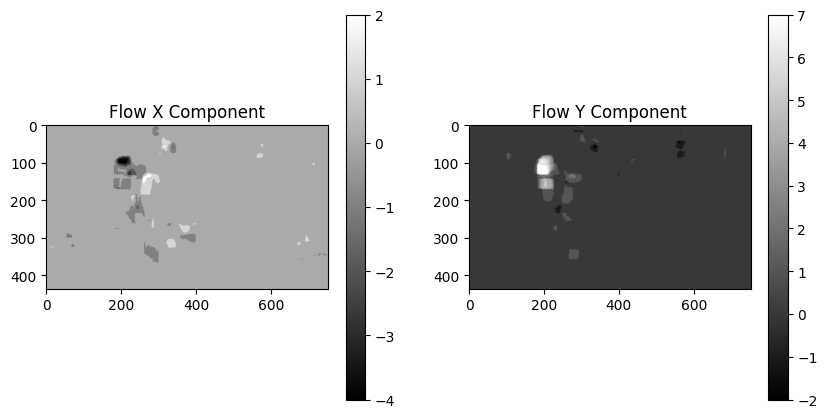

mbhx_padded shape: (436, 752, 2)
mbhy_padded shape: (436, 752, 2)


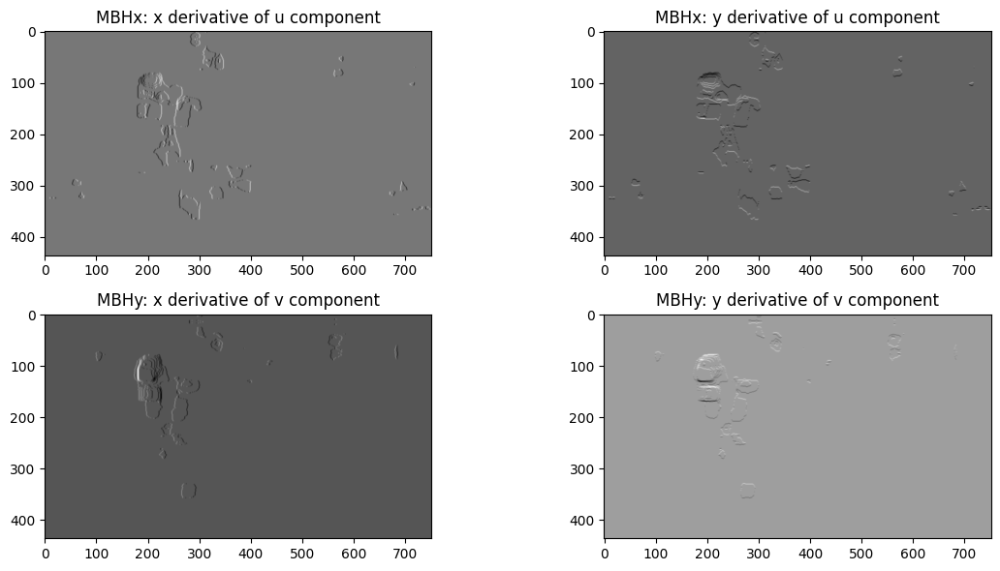

Corner shape: (1172, 1, 2)


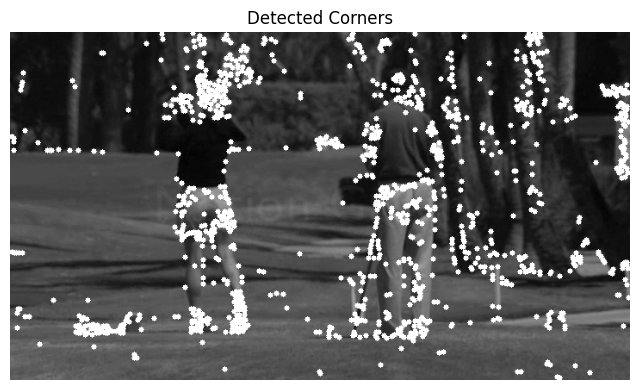

Length of Trajectory: 173
x: 210.0 y: 213.0
x: 323.0 y: 255.0
x: 495.0 y: 220.0
x: 286.0 y: 326.0
x: 710.0 y: 65.0
x: 200.0 y: 178.0
x: 430.0 y: 345.0
x: 227.0 y: 78.0
x: 204.0 y: 198.0
x: 645.0 y: 80.0
x: 710.0 y: 120.0
x: 550.0 y: 145.0
x: 430.0 y: 190.0
x: 510.0 y: 26.0
x: 510.0 y: 35.0
x: 575.0 y: 260.0
x: 620.0 y: 280.0
x: 490.0 y: 170.0
x: 655.0 y: 380.0
x: 440.0 y: 15.0
x: 520.0 y: 195.0
x: 625.0 y: 35.0
x: 640.0 y: 325.0
x: 173.0 y: 82.0
x: 273.0 y: 342.0
x: 197.0 y: 109.0
x: 194.0 y: 201.0
x: 260.0 y: 193.0
x: 252.0 y: 115.0
x: 232.0 y: 59.0
x: 480.0 y: 80.0
x: 440.0 y: 325.0
x: 250.0 y: 227.0
x: 490.0 y: 120.0
x: 213.0 y: 320.0
x: 229.0 y: 85.0
x: 645.0 y: 340.0
x: 660.0 y: 220.0
x: 665.0 y: 265.0
x: 705.0 y: 305.0
x: 425.0 y: 110.0
x: 80.0 y: 340.0
x: 199.0 y: 83.0
x: 605.0 y: 5.0
x: 550.0 y: 110.0
x: 224.0 y: 250.0
x: 195.0 y: 330.0
x: 194.0 y: 146.0
x: 590.0 y: 90.0
x: 410.0 y: 345.0
x: 450.0 y: 185.0
x: 166.0 y: 140.0
x: 605.0 y: 185.0
x: 600.0 y: 45.0
x: 192.0 y: 74.0
x:

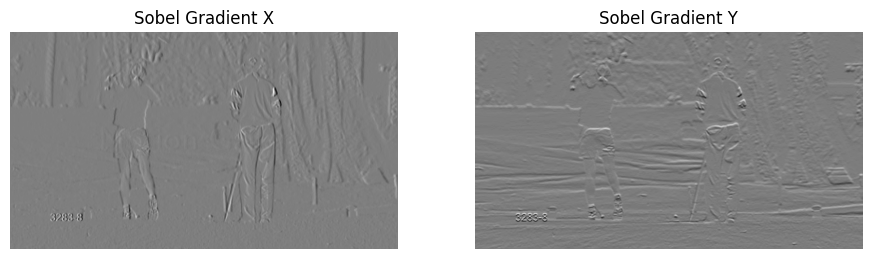

Flow dimension:  3
Flow shape: (404, 720, 2)
Padded Flow shape: (436, 752, 2)


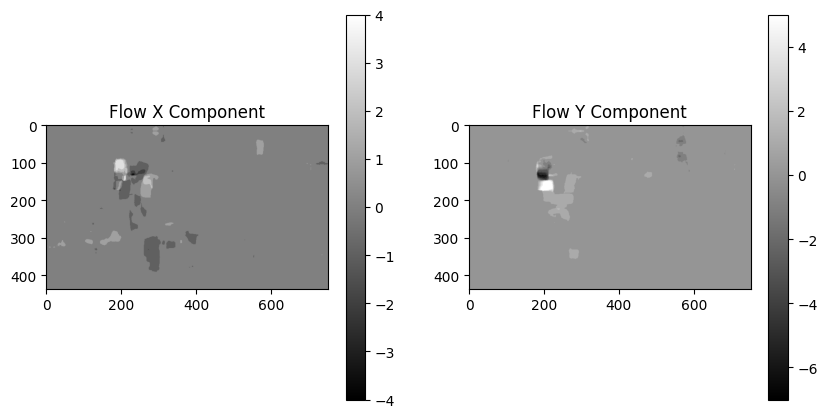

mbhx_padded shape: (436, 752, 2)
mbhy_padded shape: (436, 752, 2)


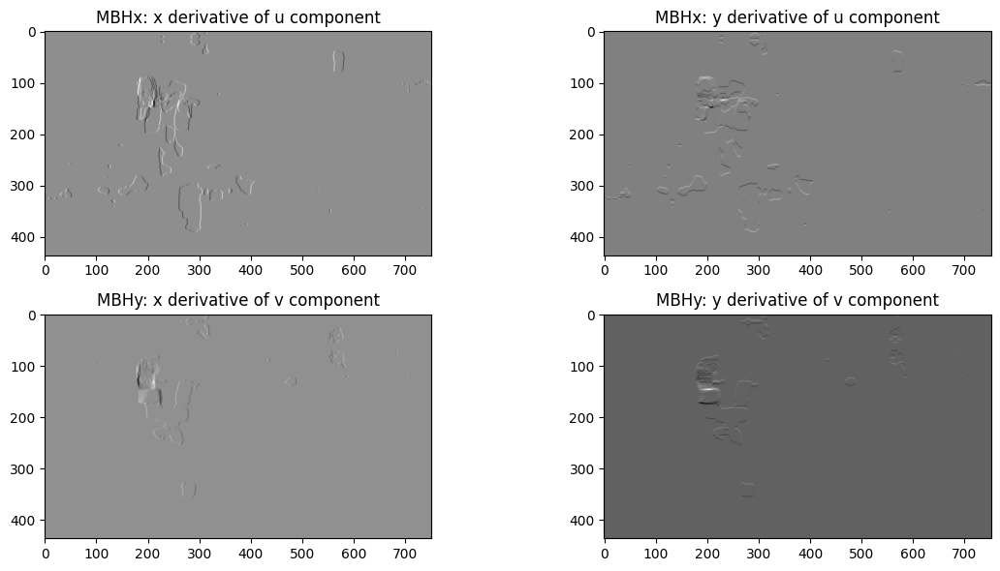

Corner shape: (1194, 1, 2)


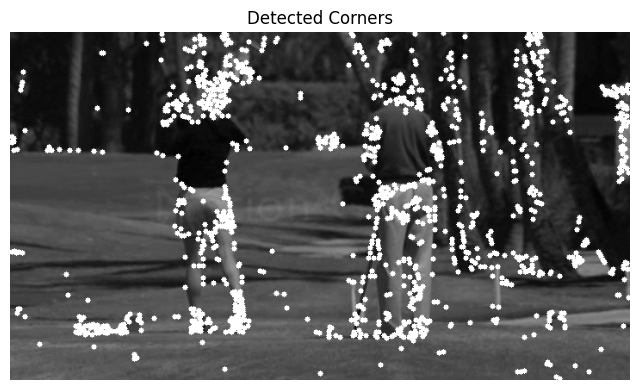

Length of Trajectory: 173
x: 323.0 y: 255.0
x: 286.0 y: 326.0
x: 200.0 y: 178.0
x: 227.0 y: 78.0
x: 645.0 y: 80.0
x: 550.0 y: 145.0
x: 430.0 y: 190.0
x: 510.0 y: 35.0
x: 620.0 y: 280.0
x: 655.0 y: 380.0
x: 520.0 y: 195.0
x: 640.0 y: 325.0
x: 171.0 y: 88.0
x: 272.0 y: 342.0
x: 196.0 y: 114.0
x: 194.0 y: 201.0
x: 260.0 y: 193.0
x: 253.0 y: 116.0
x: 232.0 y: 59.0
x: 480.0 y: 80.0
x: 440.0 y: 325.0
x: 250.0 y: 228.0
x: 490.0 y: 120.0
x: 213.0 y: 320.0
x: 229.0 y: 85.0
x: 645.0 y: 340.0
x: 660.0 y: 220.0
x: 665.0 y: 265.0
x: 705.0 y: 305.0
x: 425.0 y: 110.0
x: 80.0 y: 340.0
x: 195.0 y: 87.0
x: 605.0 y: 5.0
x: 550.0 y: 110.0
x: 224.0 y: 250.0
x: 195.0 y: 330.0
x: 193.0 y: 150.0
x: 590.0 y: 90.0
x: 410.0 y: 345.0
x: 450.0 y: 185.0
x: 165.0 y: 140.0
x: 605.0 y: 185.0
x: 600.0 y: 45.0
x: 188.0 y: 79.0
x: 248.0 y: 71.0
x: 267.0 y: 320.0
x: 202.0 y: 225.0
x: 715.0 y: 85.0
x: 270.0 y: 40.0
x: 470.0 y: 200.0
x: 216.0 y: 71.0
x: 45.0 y: 135.0
x: 235.0 y: 65.0
x: 175.0 y: 345.0
x: 220.0 y: 330.0
x: 4

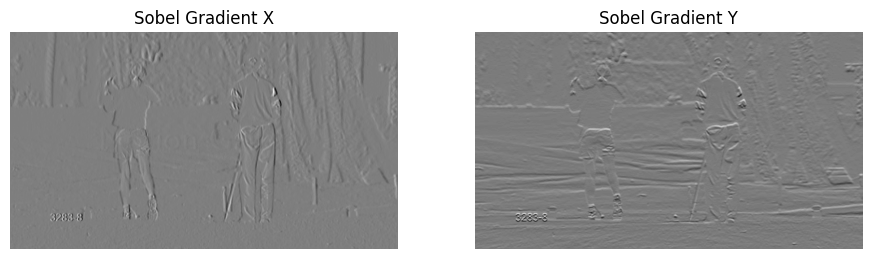

Flow dimension:  3
Flow shape: (404, 720, 2)
Padded Flow shape: (436, 752, 2)


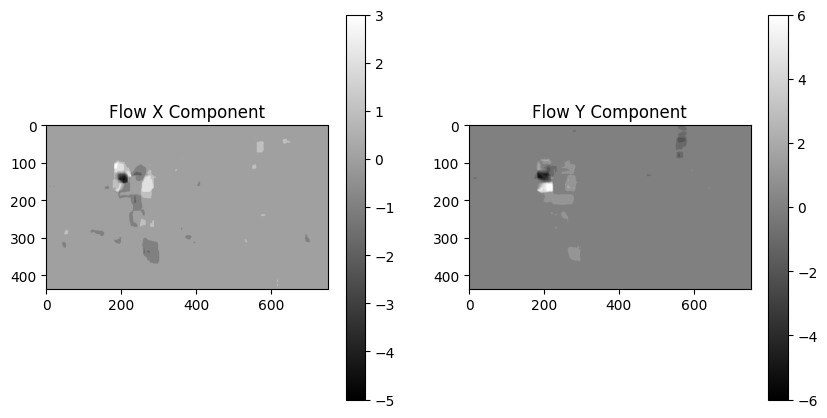

mbhx_padded shape: (436, 752, 2)
mbhy_padded shape: (436, 752, 2)


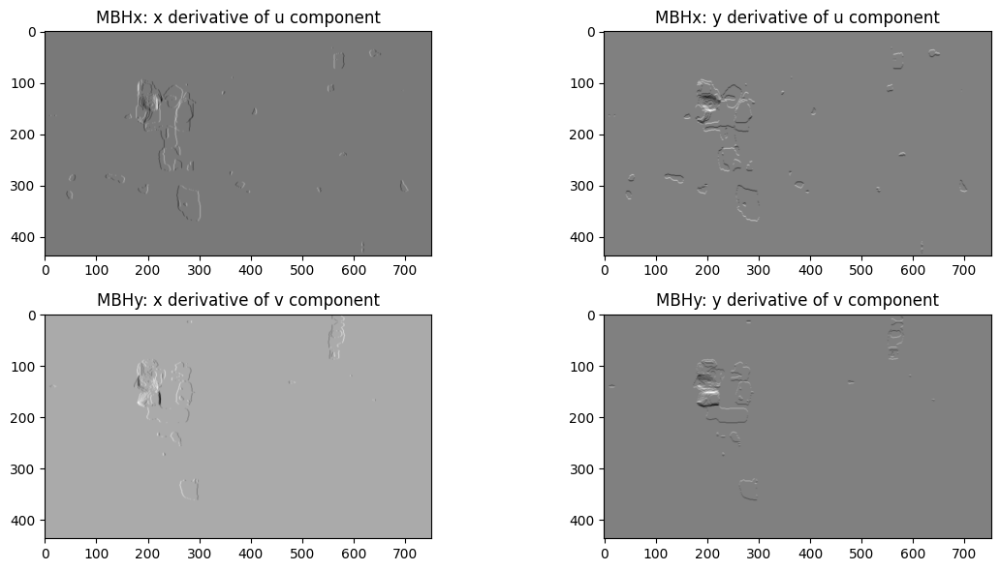

Corner shape: (1335, 1, 2)


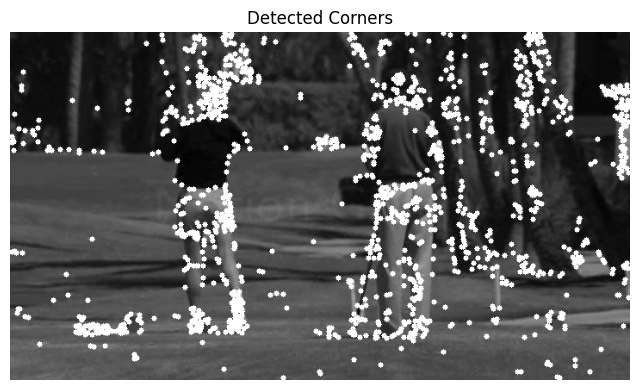

Length of Trajectory: 175
x: 286.0 y: 326.0
x: 227.0 y: 78.0
x: 550.0 y: 145.0
x: 510.0 y: 35.0
x: 655.0 y: 380.0
x: 640.0 y: 325.0
x: 272.0 y: 342.0
x: 194.0 y: 201.0
x: 253.0 y: 116.0
x: 480.0 y: 80.0
x: 250.0 y: 228.0
x: 490.0 y: 120.0
x: 213.0 y: 320.0
x: 228.0 y: 85.0
x: 645.0 y: 340.0
x: 660.0 y: 220.0
x: 665.0 y: 265.0
x: 705.0 y: 305.0
x: 425.0 y: 110.0
x: 80.0 y: 340.0
x: 196.0 y: 86.0
x: 605.0 y: 5.0
x: 550.0 y: 110.0
x: 223.0 y: 250.0
x: 195.0 y: 330.0
x: 192.0 y: 155.0
x: 590.0 y: 90.0
x: 410.0 y: 345.0
x: 450.0 y: 185.0
x: 164.0 y: 140.0
x: 605.0 y: 185.0
x: 600.0 y: 45.0
x: 191.0 y: 79.0
x: 248.0 y: 71.0
x: 266.0 y: 321.0
x: 202.0 y: 225.0
x: 714.0 y: 85.0
x: 270.0 y: 40.0
x: 470.0 y: 200.0
x: 216.0 y: 71.0
x: 45.0 y: 135.0
x: 235.0 y: 65.0
x: 175.0 y: 345.0
x: 220.0 y: 330.0
x: 475.0 y: 285.0
x: 475.0 y: 245.0
x: 269.0 y: 291.0
x: 405.0 y: 335.0
x: 258.0 y: 211.0
x: 219.0 y: 240.0
x: 460.0 y: 90.0
x: 254.0 y: 337.0
x: 470.0 y: 180.0
x: 221.0 y: 230.0
x: 570.0 y: 140.0
x:

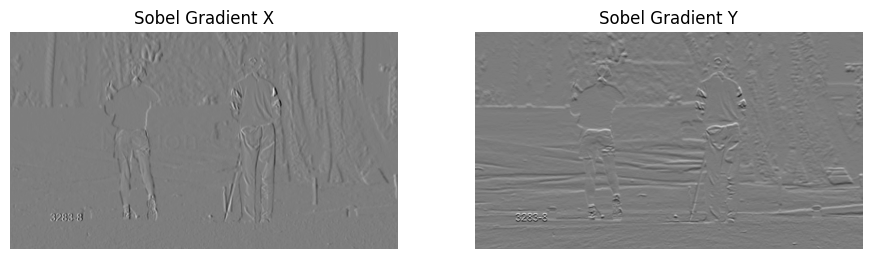

Flow dimension:  3
Flow shape: (404, 720, 2)
Padded Flow shape: (436, 752, 2)


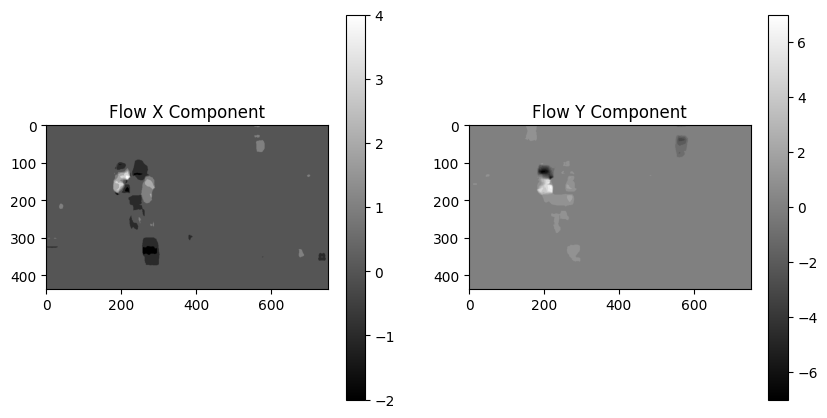

mbhx_padded shape: (436, 752, 2)
mbhy_padded shape: (436, 752, 2)


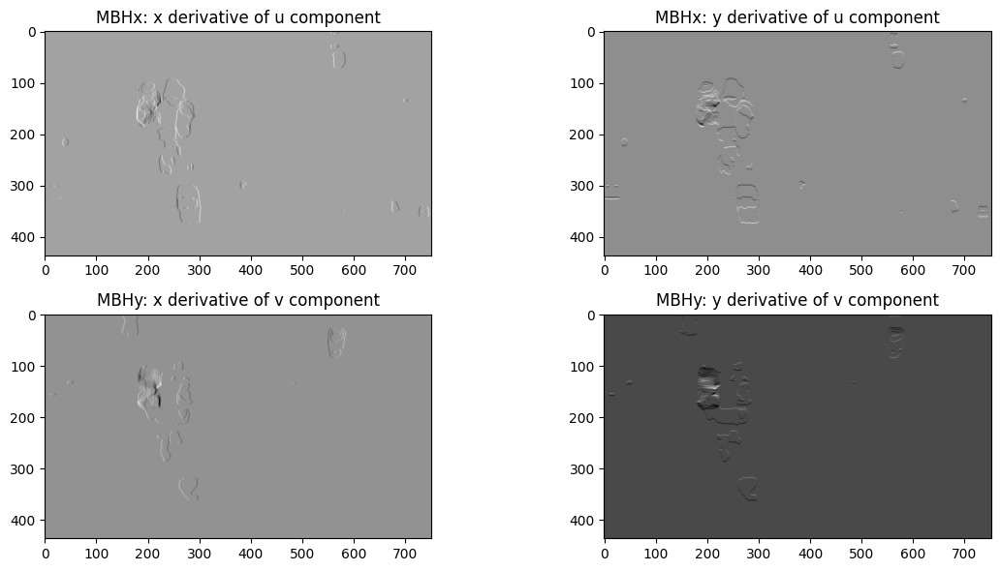

Corner shape: (1274, 1, 2)


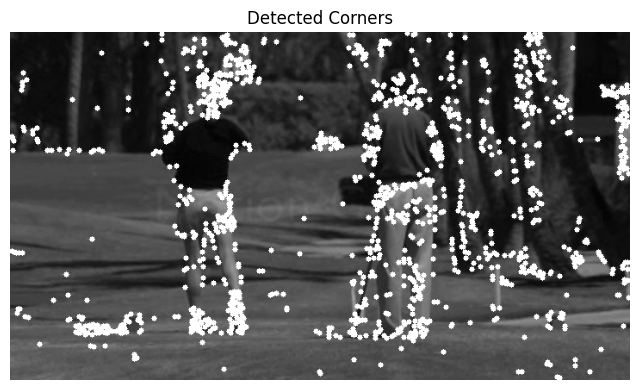

Length of Trajectory: 172
x: 227.0 y: 78.0
x: 510.0 y: 35.0
x: 640.0 y: 325.0
x: 194.0 y: 201.0
x: 480.0 y: 80.0
x: 490.0 y: 120.0
x: 228.0 y: 85.0
x: 660.0 y: 220.0
x: 705.0 y: 305.0
x: 80.0 y: 340.0
x: 196.0 y: 87.0
x: 605.0 y: 5.0
x: 550.0 y: 110.0
x: 222.0 y: 250.0
x: 195.0 y: 330.0
x: 191.0 y: 161.0
x: 590.0 y: 90.0
x: 410.0 y: 345.0
x: 450.0 y: 185.0
x: 165.0 y: 140.0
x: 605.0 y: 185.0
x: 600.0 y: 45.0
x: 191.0 y: 81.0
x: 248.0 y: 71.0
x: 265.0 y: 322.0
x: 202.0 y: 225.0
x: 714.0 y: 85.0
x: 270.0 y: 40.0
x: 470.0 y: 200.0
x: 216.0 y: 71.0
x: 45.0 y: 135.0
x: 235.0 y: 65.0
x: 175.0 y: 345.0
x: 220.0 y: 330.0
x: 475.0 y: 285.0
x: 475.0 y: 245.0
x: 269.0 y: 291.0
x: 405.0 y: 335.0
x: 258.0 y: 211.0
x: 219.0 y: 240.0
x: 460.0 y: 90.0
x: 253.0 y: 338.0
x: 470.0 y: 180.0
x: 221.0 y: 230.0
x: 570.0 y: 140.0
x: 425.0 y: 210.0
x: 615.0 y: 105.0
x: 445.0 y: 220.0
x: 340.0 y: 355.0
x: 206.0 y: 226.0
x: 590.0 y: 395.0
x: 475.0 y: 335.0
x: 250.0 y: 216.0
x: 135.0 y: 330.0
x: 224.0 y: 285.0
x:

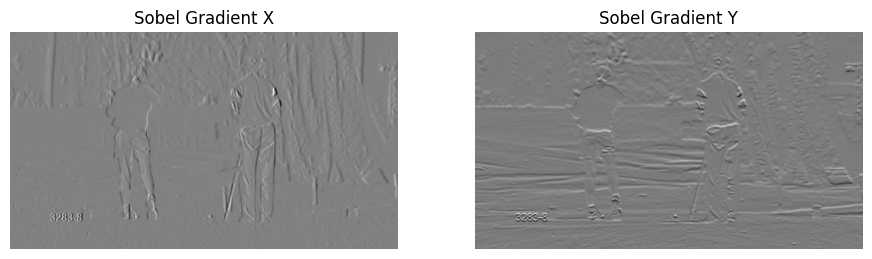

Flow dimension:  3
Flow shape: (404, 720, 2)
Padded Flow shape: (436, 752, 2)


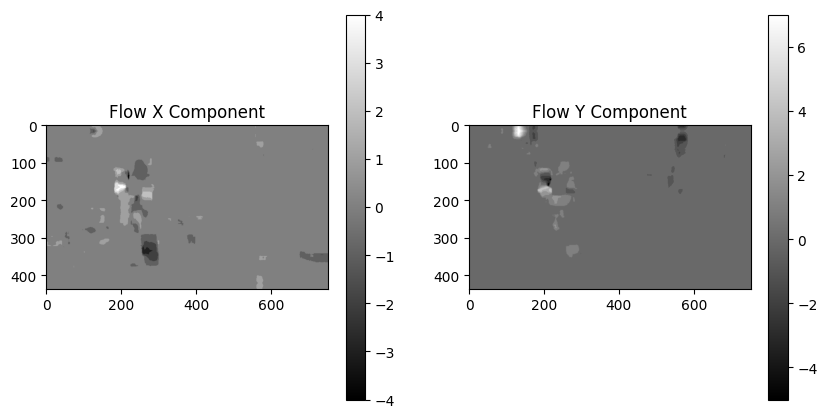

mbhx_padded shape: (436, 752, 2)
mbhy_padded shape: (436, 752, 2)


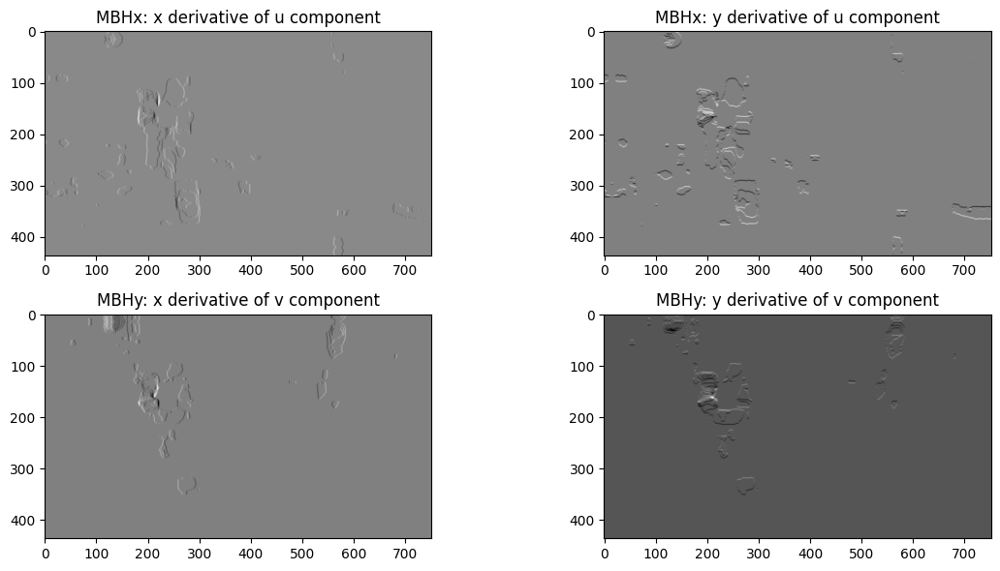

Corner shape: (1351, 1, 2)


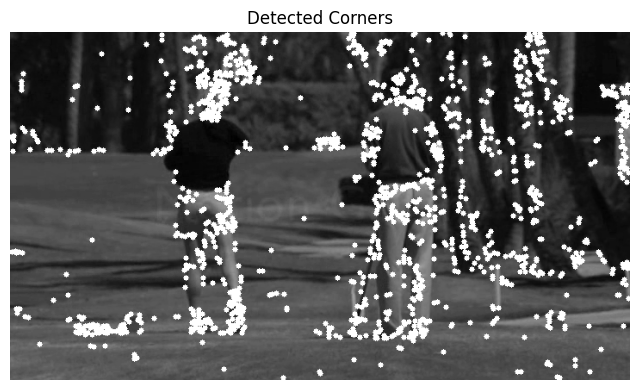

Length of Trajectory: 172
x: 510.0 y: 35.0
x: 640.0 y: 325.0
x: 480.0 y: 80.0
x: 228.0 y: 85.0
x: 705.0 y: 305.0
x: 80.0 y: 340.0
x: 605.0 y: 5.0
x: 222.0 y: 250.0
x: 191.0 y: 161.0
x: 410.0 y: 345.0
x: 165.0 y: 140.0
x: 600.0 y: 45.0
x: 191.0 y: 81.0
x: 248.0 y: 71.0
x: 263.0 y: 323.0
x: 202.0 y: 225.0
x: 714.0 y: 85.0
x: 270.0 y: 40.0
x: 470.0 y: 200.0
x: 216.0 y: 71.0
x: 45.0 y: 135.0
x: 235.0 y: 65.0
x: 175.0 y: 345.0
x: 220.0 y: 330.0
x: 475.0 y: 285.0
x: 475.0 y: 245.0
x: 268.0 y: 291.0
x: 405.0 y: 335.0
x: 258.0 y: 211.0
x: 219.0 y: 241.0
x: 460.0 y: 90.0
x: 252.0 y: 338.0
x: 470.0 y: 180.0
x: 221.0 y: 231.0
x: 570.0 y: 140.0
x: 425.0 y: 210.0
x: 615.0 y: 105.0
x: 445.0 y: 220.0
x: 340.0 y: 355.0
x: 206.0 y: 227.0
x: 590.0 y: 395.0
x: 475.0 y: 335.0
x: 250.0 y: 216.0
x: 135.0 y: 330.0
x: 224.0 y: 285.0
x: 210.0 y: 85.0
x: 705.0 y: 100.0
x: 226.0 y: 189.0
x: 610.0 y: 330.0
x: 205.0 y: 265.0
x: 260.0 y: 82.0
x: 500.0 y: 50.0
x: 410.0 y: 205.0
x: 630.0 y: 55.0
x: 230.0 y: 10.0
x: 5

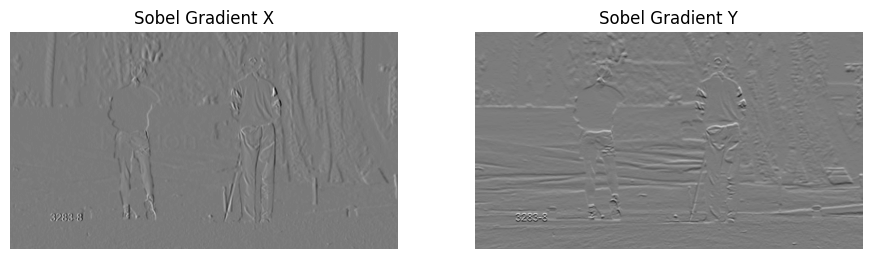

Flow dimension:  3
Flow shape: (404, 720, 2)
Padded Flow shape: (436, 752, 2)


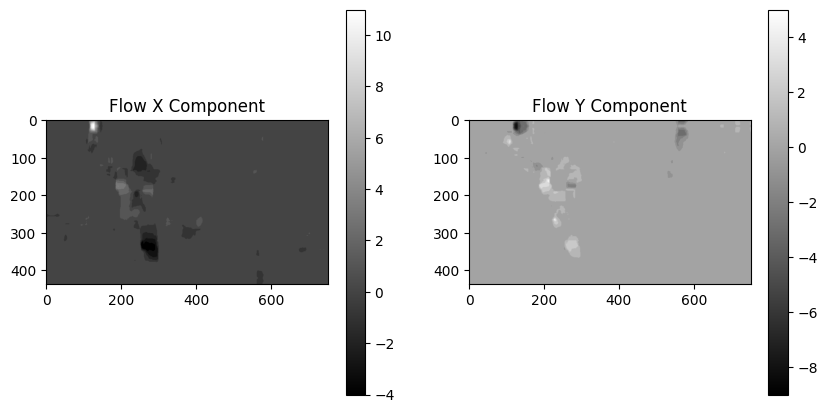

mbhx_padded shape: (436, 752, 2)
mbhy_padded shape: (436, 752, 2)


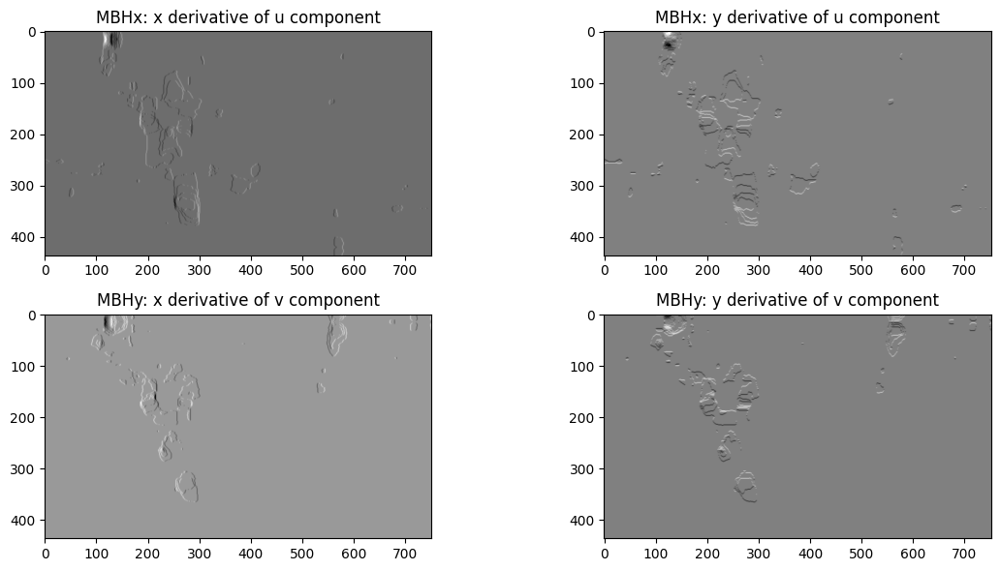

Corner shape: (1125, 1, 2)


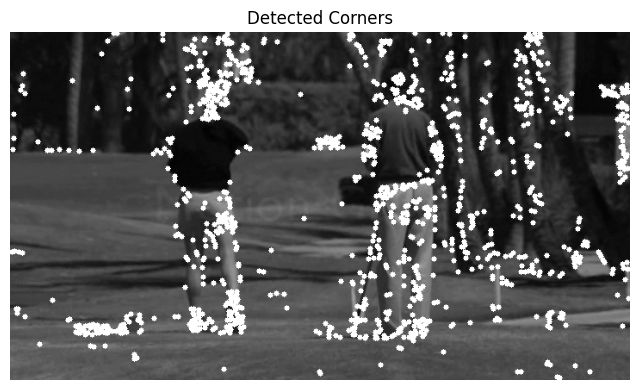

Length of Trajectory: 170
x: 640.0 y: 325.0
x: 228.0 y: 85.0
x: 80.0 y: 340.0
x: 222.0 y: 250.0
x: 410.0 y: 345.0
x: 600.0 y: 45.0
x: 248.0 y: 71.0
x: 202.0 y: 225.0
x: 270.0 y: 40.0
x: 216.0 y: 71.0
x: 235.0 y: 65.0
x: 220.0 y: 330.0
x: 475.0 y: 285.0
x: 475.0 y: 245.0
x: 267.0 y: 291.0
x: 405.0 y: 335.0
x: 258.0 y: 211.0
x: 219.0 y: 241.0
x: 460.0 y: 90.0
x: 251.0 y: 338.0
x: 470.0 y: 180.0
x: 222.0 y: 231.0
x: 570.0 y: 140.0
x: 425.0 y: 210.0
x: 615.0 y: 105.0
x: 445.0 y: 220.0
x: 340.0 y: 355.0
x: 206.0 y: 227.0
x: 590.0 y: 395.0
x: 475.0 y: 335.0
x: 249.0 y: 216.0
x: 135.0 y: 330.0
x: 224.0 y: 285.0
x: 210.0 y: 85.0
x: 705.0 y: 100.0
x: 225.0 y: 190.0
x: 610.0 y: 330.0
x: 205.0 y: 265.0
x: 260.0 y: 82.0
x: 500.0 y: 50.0
x: 410.0 y: 205.0
x: 630.0 y: 55.0
x: 230.0 y: 10.0
x: 5.0 y: 95.0
x: 535.0 y: 270.0
x: 254.0 y: 320.0
x: 211.0 y: 197.0
x: 360.0 y: 125.0
x: 239.0 y: 231.0
x: 230.0 y: 77.0
x: 425.0 y: 100.0
x: 198.0 y: 220.0
x: 314.0 y: 117.0
x: 207.0 y: 68.0
x: 213.0 y: 221.0
x:

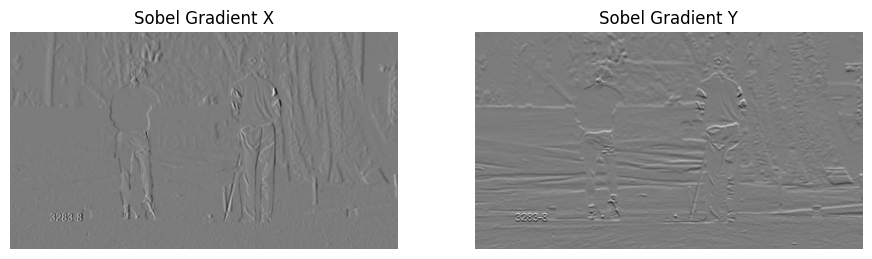

Flow dimension:  3
Flow shape: (404, 720, 2)
Padded Flow shape: (436, 752, 2)


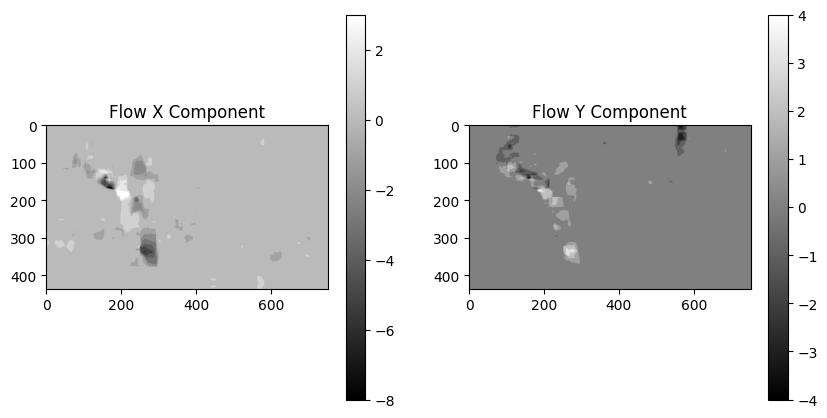

mbhx_padded shape: (436, 752, 2)
mbhy_padded shape: (436, 752, 2)


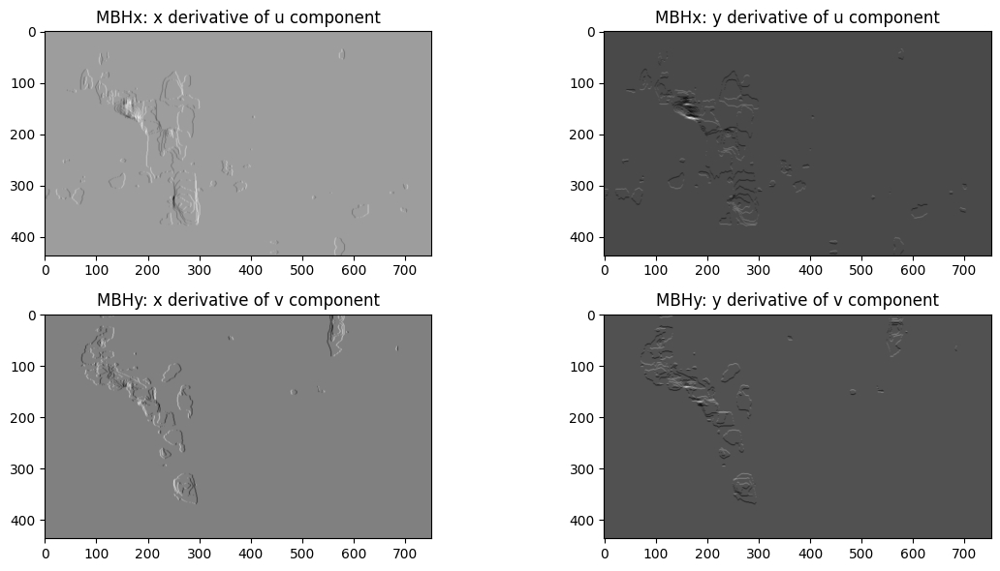

Corner shape: (1163, 1, 2)


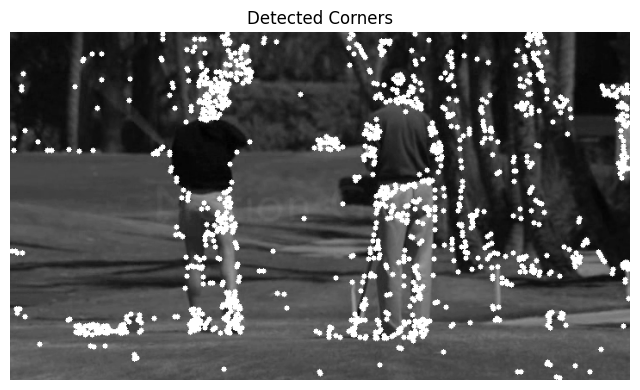

Length of Trajectory: 165
x: 228.0 y: 85.0
x: 222.0 y: 250.0
x: 600.0 y: 45.0
x: 202.0 y: 225.0
x: 216.0 y: 71.0
x: 220.0 y: 330.0
x: 475.0 y: 245.0
x: 405.0 y: 335.0
x: 219.0 y: 241.0
x: 251.0 y: 338.0
x: 222.0 y: 231.0
x: 425.0 y: 210.0
x: 445.0 y: 220.0
x: 206.0 y: 227.0
x: 590.0 y: 395.0
x: 475.0 y: 335.0
x: 248.0 y: 216.0
x: 135.0 y: 330.0
x: 224.0 y: 285.0
x: 210.0 y: 85.0
x: 705.0 y: 100.0
x: 224.0 y: 191.0
x: 610.0 y: 330.0
x: 205.0 y: 265.0
x: 260.0 y: 82.0
x: 500.0 y: 50.0
x: 410.0 y: 205.0
x: 630.0 y: 55.0
x: 230.0 y: 10.0
x: 5.0 y: 95.0
x: 535.0 y: 270.0
x: 250.0 y: 322.0
x: 211.0 y: 198.0
x: 360.0 y: 125.0
x: 239.0 y: 231.0
x: 229.0 y: 77.0
x: 425.0 y: 100.0
x: 199.0 y: 220.0
x: 314.0 y: 117.0
x: 207.0 y: 68.0
x: 213.0 y: 221.0
x: 585.0 y: 225.0
x: 204.0 y: 285.0
x: 505.0 y: 230.0
x: 219.0 y: 271.0
x: 321.0 y: 122.0
x: 234.0 y: 99.0
x: 184.0 y: 83.0
x: 455.0 y: 220.0
x: 525.0 y: 225.0
x: 420.0 y: 130.0
x: 455.0 y: 80.0
x: 211.0 y: 194.0
x: 395.0 y: 45.0
x: 705.0 y: 160.0
x

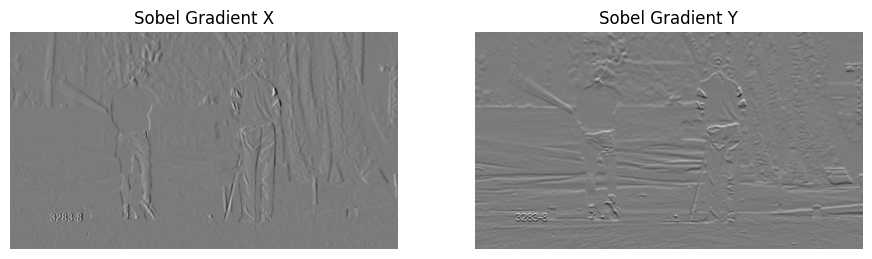

Flow dimension:  3
Flow shape: (404, 720, 2)
Padded Flow shape: (436, 752, 2)


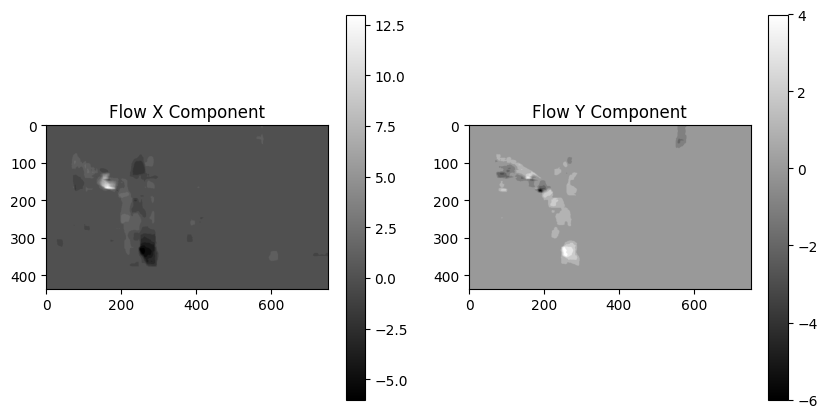

mbhx_padded shape: (436, 752, 2)
mbhy_padded shape: (436, 752, 2)


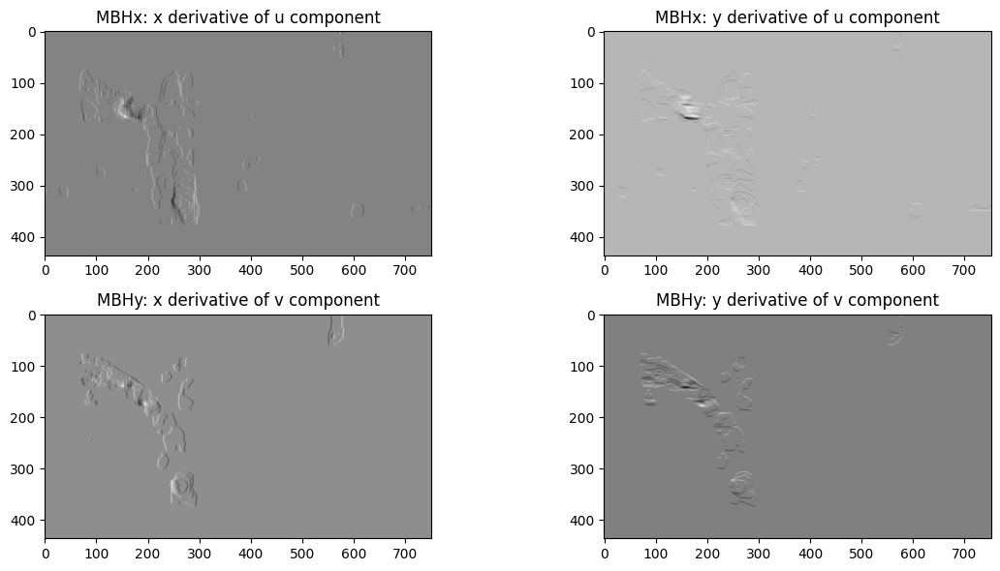

Corner shape: (1123, 1, 2)


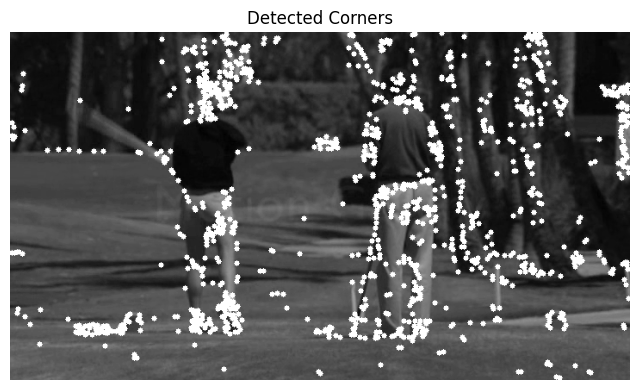

Length of Trajectory: 161
x: 222.0 y: 250.0
x: 202.0 y: 225.0
x: 220.0 y: 330.0
x: 405.0 y: 335.0
x: 251.0 y: 338.0
x: 425.0 y: 210.0
x: 206.0 y: 227.0
x: 475.0 y: 335.0
x: 135.0 y: 330.0
x: 210.0 y: 85.0
x: 224.0 y: 191.0
x: 205.0 y: 265.0
x: 500.0 y: 50.0
x: 630.0 y: 55.0
x: 5.0 y: 95.0
x: 250.0 y: 322.0
x: 211.0 y: 199.0
x: 360.0 y: 125.0
x: 239.0 y: 232.0
x: 228.0 y: 77.0
x: 425.0 y: 100.0
x: 200.0 y: 220.0
x: 314.0 y: 117.0
x: 207.0 y: 68.0
x: 213.0 y: 221.0
x: 585.0 y: 225.0
x: 204.0 y: 285.0
x: 505.0 y: 230.0
x: 219.0 y: 271.0
x: 321.0 y: 122.0
x: 232.0 y: 100.0
x: 184.0 y: 83.0
x: 455.0 y: 220.0
x: 525.0 y: 225.0
x: 420.0 y: 130.0
x: 455.0 y: 80.0
x: 211.0 y: 196.0
x: 395.0 y: 45.0
x: 705.0 y: 160.0
x: 530.0 y: 99.0
x: 119.0 y: 280.0
x: 223.0 y: 266.0
x: 505.0 y: 85.0
x: 80.0 y: 330.0
x: 585.0 y: 40.0
x: 35.0 y: 365.0
x: 620.0 y: 10.0
x: 271.0 y: 139.0
x: 555.0 y: 255.0
x: 520.0 y: 124.0
x: 395.0 y: 340.0
x: 225.0 y: 99.0
x: 225.0 y: 60.0
x: 245.0 y: 50.0
x: 465.0 y: 285.0
x: 3

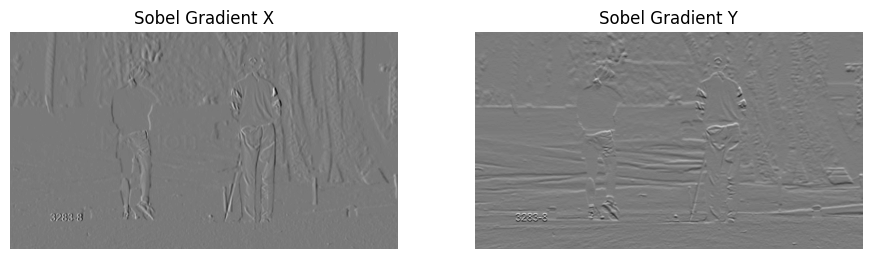

Flow dimension:  3
Flow shape: (404, 720, 2)
Padded Flow shape: (436, 752, 2)


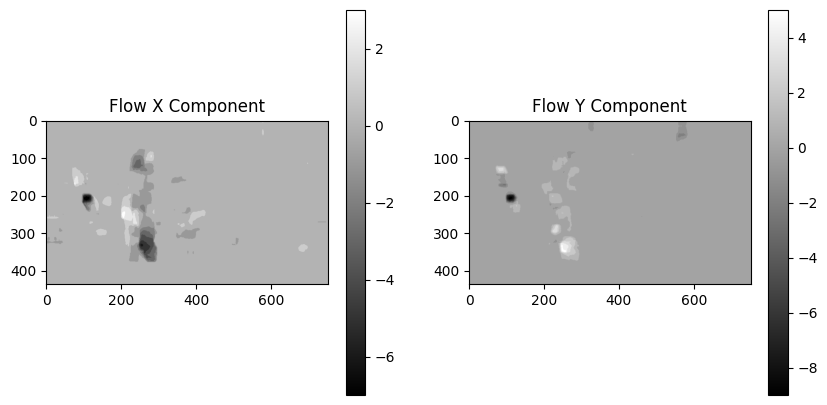

mbhx_padded shape: (436, 752, 2)
mbhy_padded shape: (436, 752, 2)


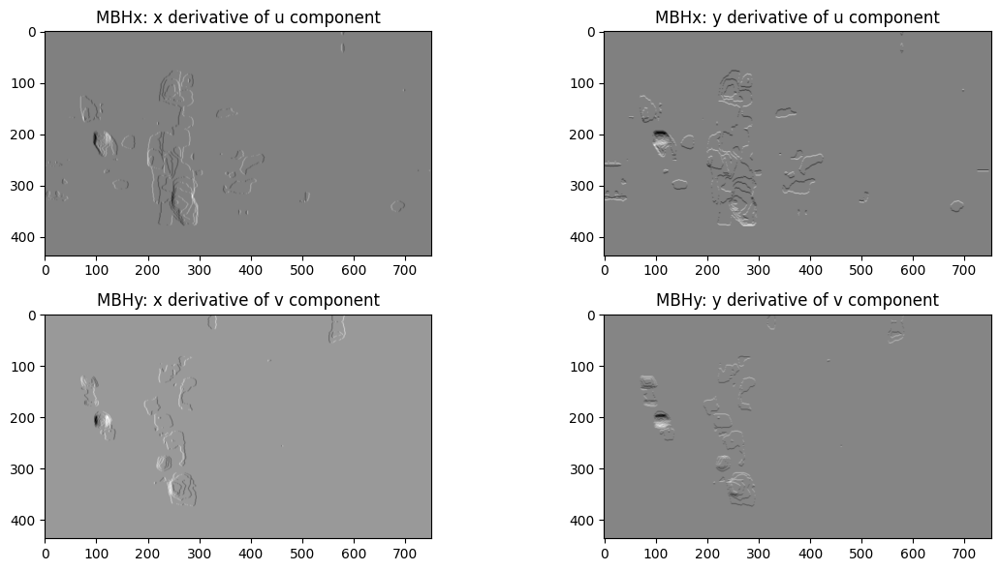

Corner shape: (1251, 1, 2)


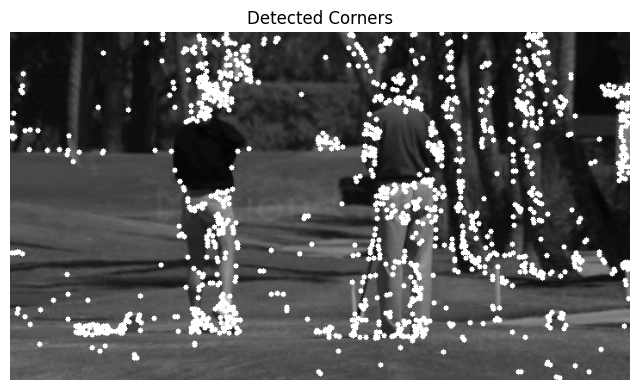

Length of Trajectory: 152
x: 202.0 y: 225.0
x: 220.0 y: 330.0
x: 251.0 y: 338.0
x: 206.0 y: 227.0
x: 135.0 y: 330.0
x: 224.0 y: 191.0
x: 500.0 y: 50.0
x: 5.0 y: 95.0
x: 245.0 y: 325.0
x: 360.0 y: 125.0
x: 228.0 y: 77.0
x: 200.0 y: 220.0
x: 207.0 y: 68.0
x: 585.0 y: 225.0
x: 505.0 y: 230.0
x: 321.0 y: 122.0
x: 230.0 y: 100.0
x: 184.0 y: 83.0
x: 455.0 y: 220.0
x: 525.0 y: 225.0
x: 420.0 y: 130.0
x: 455.0 y: 80.0
x: 211.0 y: 198.0
x: 395.0 y: 45.0
x: 705.0 y: 160.0
x: 530.0 y: 99.0
x: 119.0 y: 280.0
x: 223.0 y: 267.0
x: 505.0 y: 85.0
x: 80.0 y: 330.0
x: 585.0 y: 40.0
x: 35.0 y: 365.0
x: 620.0 y: 10.0
x: 271.0 y: 139.0
x: 555.0 y: 255.0
x: 520.0 y: 124.0
x: 395.0 y: 340.0
x: 223.0 y: 99.0
x: 225.0 y: 60.0
x: 245.0 y: 50.0
x: 465.0 y: 285.0
x: 344.0 y: 135.0
x: 475.0 y: 165.0
x: 280.0 y: 102.0
x: 198.0 y: 176.0
x: 255.0 y: 50.0
x: 261.0 y: 224.0
x: 635.0 y: 400.0
x: 238.0 y: 187.0
x: 450.0 y: 345.0
x: 435.0 y: 200.0
x: 385.0 y: 200.0
x: 700.0 y: 275.0
x: 258.0 y: 343.0
x: 500.0 y: 155.0
x: 

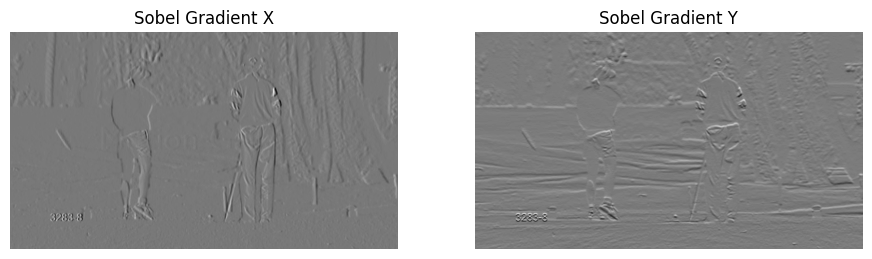

Flow dimension:  3
Flow shape: (404, 720, 2)
Padded Flow shape: (436, 752, 2)


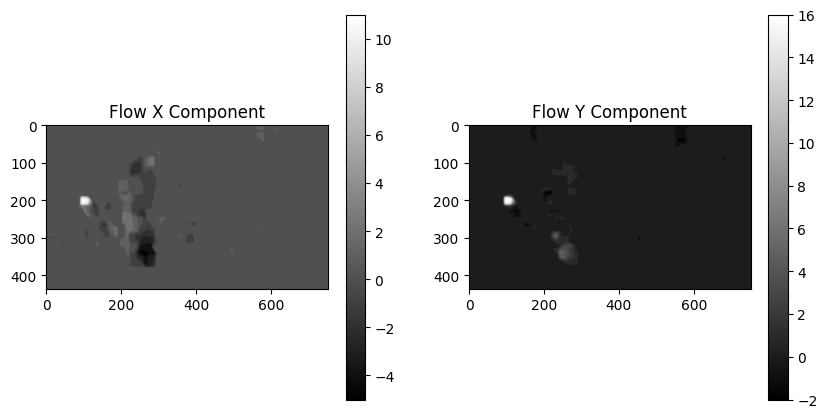

mbhx_padded shape: (436, 752, 2)
mbhy_padded shape: (436, 752, 2)


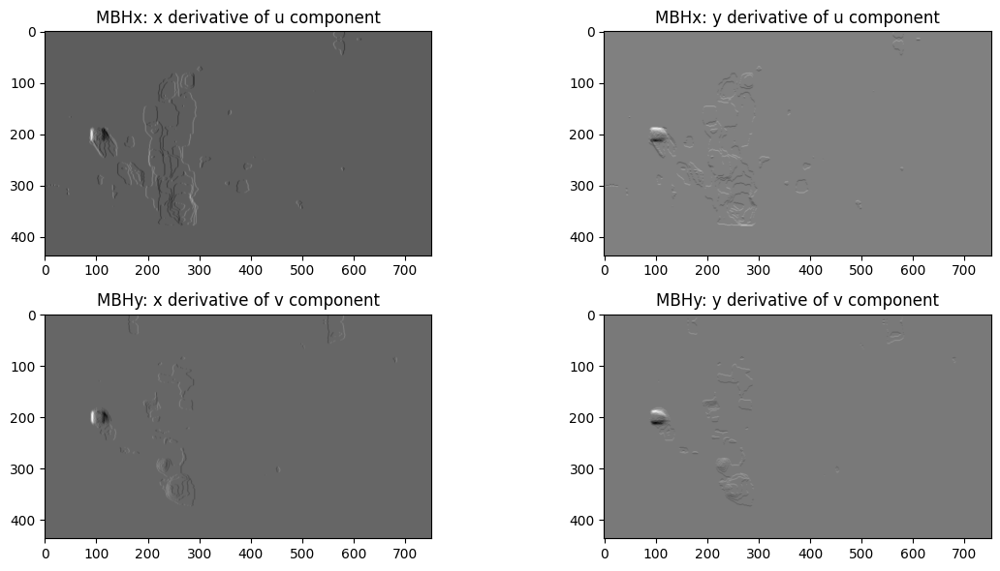

Corner shape: (1072, 1, 2)


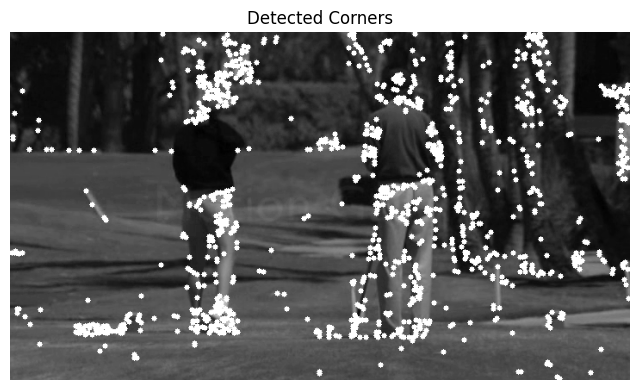

Length of Trajectory: 151
x: 220.0 y: 330.0
x: 206.0 y: 227.0
x: 224.0 y: 191.0
x: 5.0 y: 95.0
x: 360.0 y: 125.0
x: 200.0 y: 220.0
x: 585.0 y: 225.0
x: 321.0 y: 122.0
x: 184.0 y: 83.0
x: 525.0 y: 225.0
x: 455.0 y: 80.0
x: 395.0 y: 45.0
x: 530.0 y: 99.0
x: 223.0 y: 267.0
x: 505.0 y: 85.0
x: 80.0 y: 330.0
x: 585.0 y: 40.0
x: 35.0 y: 365.0
x: 620.0 y: 10.0
x: 271.0 y: 139.0
x: 555.0 y: 255.0
x: 520.0 y: 124.0
x: 395.0 y: 340.0
x: 220.0 y: 100.0
x: 225.0 y: 60.0
x: 245.0 y: 50.0
x: 465.0 y: 285.0
x: 343.0 y: 135.0
x: 475.0 y: 165.0
x: 280.0 y: 102.0
x: 198.0 y: 176.0
x: 255.0 y: 50.0
x: 261.0 y: 224.0
x: 635.0 y: 400.0
x: 237.0 y: 187.0
x: 450.0 y: 345.0
x: 435.0 y: 200.0
x: 385.0 y: 200.0
x: 700.0 y: 275.0
x: 255.0 y: 344.0
x: 500.0 y: 155.0
x: 195.0 y: 79.0
x: 360.0 y: 135.0
x: 600.0 y: 55.0
x: 259.0 y: 250.0
x: 217.0 y: 210.0
x: 600.0 y: 150.0
x: 520.0 y: 95.0
x: 490.0 y: 105.0
x: 475.0 y: 300.0
x: 247.0 y: 337.0
x: 186.0 y: 74.0
x: 205.0 y: 211.0
x: 540.0 y: 230.0
x: 255.0 y: 65.0
x: 2

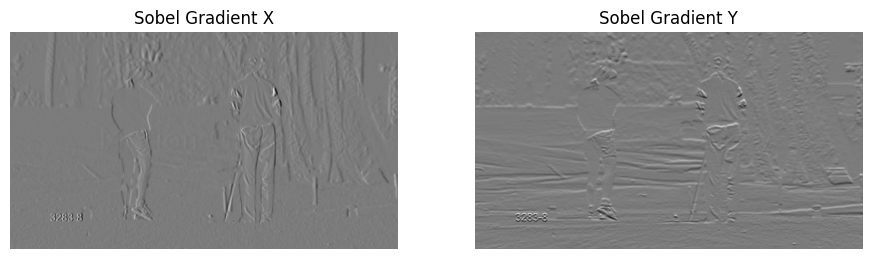

Overall Displacement: 4.0
Overall Displacement: 0.0
Overall Displacement: 1.0
Overall Displacement: 0.0
Overall Displacement: 5.414213538169861
Gradient_volumne (15, 32, 32, 2)
Optical Flow Volume (15, 32, 32, 2)
MBHx Volume (15, 32, 32, 2)
MBHy Volume (15, 32, 32, 2)
Overall Displacement: 28.738768935203552
Gradient_volumne (15, 32, 32, 2)
Optical Flow Volume (15, 32, 32, 2)
MBHx Volume (15, 32, 32, 2)
MBHy Volume (15, 32, 32, 2)
Overall Displacement: 2.0
Overall Displacement: 0.0
Overall Displacement: 10.222125053405762
Gradient_volumne (15, 32, 32, 2)
Optical Flow Volume (15, 32, 32, 2)
MBHx Volume (15, 32, 32, 2)
MBHy Volume (15, 32, 32, 2)
Overall Displacement: 0.0
Overall Displacement: 0.0
Overall Displacement: 0.0
Overall Displacement: 13.071067690849304
Gradient_volumne (15, 32, 32, 2)
Optical Flow Volume (15, 32, 32, 2)
MBHx Volume (15, 32, 32, 2)
MBHy Volume (15, 32, 32, 2)
Overall Displacement: 13.242640614509583
Gradient_volumne (15, 32, 32, 2)
Optical Flow Volume (15, 32, 

In [8]:
descriptors_from_trajectories(trajectories_from_video(r"/home/riddhish143/Desktop/DenseTrajectory/Dense Track/dense-trajectories-action-recognition/data/Extracted/2_1.avi"),"/home/riddhish143/Desktop/DenseTrajectory/Dense Track/dense-trajectories-action-recognition/data/Extracted/2_1.avi")

In [9]:
class VideoRepresentation:
    __slots__ = (
        'filepath',
        'descriptors',
        'pca_descriptors',
        'fisher_vector',
        'label',
        'predicted_label'
    )

    def __init__(self, filepath=None, descriptors=None, label=None):
        self.filepath = filepath
        self.descriptors = descriptors
        self.pca_descriptors = None
        self.fisher_vector = None
        self.label = label
        self.predicted_label = None


In [10]:
train_videos = []
test_videos = []

train_lines = []
with open(join(data_dir, 'train.txt'), 'r') as train_f:
    train_lines = train_f.readlines()
for l in train_lines:
    filepath, label = l.split()
    print("Filepath:",filepath)
    print("Label:",label)
    descriptor_path = join(video_descriptors_path,
                            f'{filepath.split("/")[1].replace(".avi", "-descriptors.txt")}')
    print("Descriptor Path:",descriptor_path)
    video_representation = VideoRepresentation(filepath, np.loadtxt("/home/riddhish143/Downloads/Dense Tracjectory Updated/Dense Track/"+descriptor_path), label)
    train_videos.append(video_representation)
print(len(train_videos))
all_train_descriptors = np.concatenate([v.descriptors for v in train_videos], axis=0)
# print(f'total number of train descriptors: {all_train_descriptors.shape}')
print(f'total number of train descriptors: {all_train_descriptors.shape[0]}')
print(f'length of each train descriptor: {all_train_descriptors.shape[1]}')

Filepath: Extracted/2_1.avi
Label: Golf-Swing-Back
Descriptor Path: out/video_descriptors/2_1-descriptors.txt
Filepath: Extracted/2_2.avi
Label: Golf-Swing-Back
Descriptor Path: out/video_descriptors/2_2-descriptors.txt
Filepath: Extracted/2_3.avi
Label: Golf-Swing-Back
Descriptor Path: out/video_descriptors/2_3-descriptors.txt
Filepath: Extracted/3_1.avi
Label: Golf-Swing-Front
Descriptor Path: out/video_descriptors/3_1-descriptors.txt
Filepath: Extracted/3_2.avi
Label: Golf-Swing-Front
Descriptor Path: out/video_descriptors/3_2-descriptors.txt
Filepath: Extracted/3_3.avi
Label: Golf-Swing-Front
Descriptor Path: out/video_descriptors/3_3-descriptors.txt
Filepath: Extracted/3_4.avi
Label: Golf-Swing-Front
Descriptor Path: out/video_descriptors/3_4-descriptors.txt
Filepath: Extracted/3_5.avi
Label: Golf-Swing-Front
Descriptor Path: out/video_descriptors/3_5-descriptors.txt
Filepath: Extracted/3_6.avi
Label: Golf-Swing-Front
Descriptor Path: out/video_descriptors/3_6-descriptors.txt
File

In [11]:
import numpy as np
import os
from os.path import join
from trajectory import Trajectory
from settings import *
from visualize import *
from sklearn import decomposition as decomp
import matplotlib.pyplot as plt


from sklearn import decomposition as decomp
pca = decomp.PCA(64)
pca = pca.fit(all_train_descriptors)
print(pca)

PCA(n_components=64)


In [12]:
# transform descriptors of each video
for v in train_videos:
    v.pca_descriptors = pca.transform(v.descriptors)
    print("pca_descriptor shape",v.pca_descriptors.shape)
    print("pca_descriptor",v.pca_descriptors)

pca_descriptor shape (150, 64)
pca_descriptor [[-0.23201131  0.0908666  -0.64344998 ... -0.0364258   0.03019016
  -0.04288323]
 [ 0.63092918  0.40307479 -0.41917805 ...  0.06070533 -0.03070207
  -0.0282603 ]
 [ 0.05035028  0.23873282  0.88558497 ...  0.01694337  0.11908327
   0.13277462]
 ...
 [ 0.16582457  0.41067773 -0.00409334 ...  0.05778682 -0.04207232
  -0.08346997]
 [ 0.26678656  0.42429268  0.06313175 ...  0.07464097  0.0565229
  -0.05381164]
 [-0.19955441  0.41616574  0.43514986 ... -0.15103838  0.04101017
  -0.12316403]]
pca_descriptor shape (161, 64)
pca_descriptor [[-0.26690152 -0.28232703  0.69852502 ...  0.17272233  0.12735724
  -0.06261953]
 [ 0.38492241  0.36191004  0.28673692 ...  0.03088269  0.02772856
   0.116587  ]
 [ 0.5373694   0.31816445  0.16915504 ... -0.12053166  0.0825155
  -0.0524909 ]
 ...
 [ 0.28353501  0.16084734  0.03548116 ...  0.06358671  0.01579293
  -0.00264116]
 [-0.28207169  0.15986749  0.38311524 ... -0.19348768  0.13526551
   0.02279588]
 [-0.447

In [13]:
# concatenate the pca-transformed descriptors, to not transform the whole data one extra time
all_train_descriptors = np.concatenate([v.pca_descriptors for v in train_videos], axis=0)
print(f'length each train descriptor after pca: {all_train_descriptors.shape[1]}')
print(f'total number of pca descriptors: {all_train_descriptors.shape[0]}')

length each train descriptor after pca: 64
total number of pca descriptors: 32479


In [14]:
all_train_descriptors.shape

(32479, 64)

In [15]:
'''In essence, the Fisher vector summarizes the distribution of descriptors in the video using statistical 
information from the trained GMM. This vector representation can then be used as input to machine learning 
algorithms for tasks like classification or clustering.'''

'In essence, the Fisher vector summarizes the distribution of descriptors in the video using statistical \ninformation from the trained GMM. This vector representation can then be used as input to machine learning \nalgorithms for tasks like classification or clustering.'

In [16]:
def fisher_from_descriptors(vectors, gmm):
    T = vectors.shape[0]
    D = vectors.shape[1]

    print("T:",T)
    print("D:",D)

    # posterior probabilities
    g = gmm.predict_proba(vectors)
    print("G:",g.shape)
    gmm_n_components = gmm.n_components
    print("GMM N Components:",gmm_n_components)

    print("GMM Weights:",gmm.weights_)
    D_h = (np.sum(g, axis=0) - gmm.weights_) / np.sqrt(gmm.weights_)
    D_h = D_h / T  # normalize by number of trajectories
    print("D_h:",D_h)

    # The significance of this calculation lies in its ability to
    # capture the deviation of vectors from the means of their assigned
    # clusters in a probabilistically meaningful way.
    
    D_mu_list = []
    for k in range(gmm_n_components):
        D_mu_k = np.zeros(D, dtype=np.float32)
        for t in range(T):
            D_mu_k_t = g[t, k] * (vectors[t, :] - gmm.means_[k]) / gmm.covariances_[k]
            D_mu_k = np.add(D_mu_k, D_mu_k_t)

        D_mu_k = D_mu_k / np.sqrt(gmm.weights_[k])
        print("D_mu_k:",D_mu_k.shape)
        D_mu_list.append(D_mu_k)
    D_mu = np.array(D_mu_list).flatten() / T  # K x D flattened, normalized by number of trajectories
    print("D_mu:",D_mu)
    print("D_mu shape:",D_mu.shape)

    # The significance of this calculation lies in its 
    # ability to capture the spread or variance of vectors around the
    # means of their assigned clusters in a probabilistically meaningful way.
    
    D_sigma_list = []
    for k in range(gmm_n_components):
        D_sigma_k = np.zeros(D, dtype=np.float32)
        for t in range(T):
            D_sigma_k_t = np.sqrt(2) * g[t, k] * (
                    (vectors[t, :] - gmm.means_[k]) ** 2 / gmm.covariances_[k] ** 2 - 1
            )
            D_sigma_k = np.add(D_sigma_k, D_sigma_k_t)

        D_sigma_k = D_sigma_k / np.sqrt(gmm.weights_[k])
        D_sigma_list.append(D_sigma_k)
    D_sigma = np.array(D_sigma_list).flatten() / T  # K x D flattened, normalized by number of trajectories
    print("D_sigma:",D_sigma)
    print("D_sigma shape:",D_sigma.shape)

    fisher_vector = np.concatenate([D_h, D_mu, D_sigma])  # (2 * D + 1) * K
    fisher_vector = np.sqrt(np.abs(fisher_vector)) * np.sign(fisher_vector)  # power normalize the entire vector
    print("Fisher Vector:",fisher_vector)
    print("Fisher Vector shape:",fisher_vector.shape)
    return fisher_vector

In [17]:
all_train_descriptors[0]

array([-0.23201131,  0.0908666 , -0.64344998,  0.2202755 , -0.01663416,
       -0.11414228, -0.28953817,  0.21807884, -0.1866713 , -0.25971199,
       -0.21292581,  0.09714959, -0.21378855, -0.25146872,  0.28539908,
        0.4826152 ,  0.04272196, -0.22964062, -0.121149  , -0.21195191,
       -0.05727078, -0.15790928, -0.14777212, -0.10206036, -0.29178001,
        0.23366745,  0.17158689,  0.07414476,  0.3371796 , -0.07970388,
        0.12522851, -0.05747177,  0.23660016,  0.10762325,  0.04393208,
        0.08202765, -0.15347923,  0.07210949, -0.10958368, -0.03778384,
       -0.01426762,  0.22287088,  0.0862325 ,  0.05156372, -0.01770012,
        0.12847906,  0.05174359,  0.09308892,  0.1967469 , -0.11471858,
       -0.07095911, -0.09978575, -0.10690473,  0.00258559,  0.01178654,
        0.06486788, -0.15594227, -0.09903547, -0.10577129,  0.05512354,
       -0.11758019, -0.0364258 ,  0.03019016, -0.04288323])

In [18]:
from sklearn.mixture import GaussianMixture
from sklearn.svm import LinearSVC

# learn Gaussian Mixture Model
gmm = GaussianMixture(n_components=gmm_n_components, covariance_type='diag')
gmm.fit(all_train_descriptors)
print(gmm.means_.shape)
# for v in train_videos:
print(len(v.pca_descriptors[0]))

(3, 64)
64


In [19]:
from sklearn.mixture import GaussianMixture
from sklearn.svm import LinearSVC

# learn Gaussian Mixture Model
gmm = GaussianMixture(n_components=gmm_n_components, covariance_type='diag')
gmm.fit(all_train_descriptors)

# compute fisher vectors for each train video
for v in train_videos:
    if v.pca_descriptors is not None:
        v.fisher_vector = fisher_from_descriptors(v.pca_descriptors, gmm)
    else:
        # Handle the case where descriptors are None, such as skipping the video
        print(f"Skipping video {v} because PCA descriptors are None.")
print('calculated Fisher vectors')

# initialize and fit a linear SVM
svm = LinearSVC()
X = [v.fisher_vector for v in train_videos]
print("Length of x",len(X))
svm.fit(X=[v.fisher_vector for v in train_videos], y=[v.label for v in train_videos])
print('fitted SVM')

T: 150
D: 64
G: (150, 3)
GMM N Components: 3
GMM Weights: [0.36443936 0.29799328 0.33756736]
D_h: [0.84689829 0.70536987 0.1669833 ]
D_mu_k: (64,)
D_mu_k: (64,)
D_mu_k: (64,)
D_mu: [ 1.25523379e+00 -1.27756668e+00 -3.13983630e-01  1.67940860e+00
  9.49899436e-01  1.19583086e+00 -6.53343354e-02 -4.16799131e-01
 -1.23591754e+00 -6.07053222e-01 -2.49295869e-01  1.28395800e+00
 -9.26124328e-01  3.32289228e-01  2.84707716e-01 -6.26406118e-01
 -4.40094349e+00 -3.35436397e-01 -3.86540009e-01 -2.56846962e-01
 -7.12283645e-02  1.36660969e-01  6.91681911e-01 -1.94278222e+00
  1.70460596e-01  6.62037453e-01 -2.64991040e+00 -1.66854917e+00
  2.77407406e-01  1.94833832e+00 -5.52775854e-01 -2.77634373e+00
  1.27269994e+00  3.28093117e-01  4.94762849e-01 -8.93545203e-01
  1.29943715e-01  2.10401232e-01  3.33003408e+00 -1.31770021e+00
  5.27410759e-01 -1.11322875e+00 -8.56929342e-02  2.40081343e+00
 -4.30128295e-01  1.27016372e-01 -2.76904861e-01 -2.45320249e+00
  9.02480159e-01 -1.07139014e-01  2.762

/home/riddhish143/.local/lib/python3.10/site-packages/sklearn/svm/_classes.py:31: FutureWarning: The default value of `dual` will change from `True` to `'auto'` in 1.5. Set the value of `dual` explicitly to suppress the warning.
  warnings.warn(


fitted SVM


/home/riddhish143/.local/lib/python3.10/site-packages/sklearn/svm/_base.py:1237: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


In [22]:
from os.path import join

In [24]:
data_dir

'/home/riddhish143/Dense Track/dense-trajectories-action-recognition/data/'

In [25]:
video_descriptors_path

'out/video_descriptors'

In [33]:
import run